# FT-ICR analysis - PART 1

Created on 01 March 2020 for the Pentatrap experiment

@author: Menno Door<br>
@contact: door+fticr@mpi-k.de<br>
@license: MIT license

### Refenences :

used toolkit of Jonas Karthein for PI-ICR as template :) thank you!!<br>

For references reguarding the theory behind ft-icr detection and analysis methods, please check the references.md file.

### Introduction

This part of the analysis does the conversion of the raw data to penning trap eigenfrequency data. You will be able to group, filter and average data and then fit spectra and/or evaluate pnp phase data to determine these frequencies.

### Important remark:

This is more a visualization thing, especially for bigger data sets i would recommend to do this using a normal python script including some multiprocessing.

Please be patient with this one! Gathering information on paths in fhds structures may take a while, loading data too. So please look at the circle on the top right corner (jupyter notebook), if its filled, there is still something going on and you should just wait.

### Requirements:

The following code was written for Python 3.7/3.8. The required libraries are listed below with a rough description for their task in the code.

    fhds (inhouse data storage, https://git.mpi-hd.mpg.de/Pentatrap/fhds)
    h5py (data storage, easier to distribute)
    pandas (data organisation, calculation and visualization)
    numpy (calculation)
    matplotlib (plotting)
    scipy (chi square fitting)
    jupyter (Python notebook environment)
    ipywidgets (https://ipywidgets.readthedocs.io/en/latest/user_install.html)
    plotly (plotting, https://github.com/plotly/plotly.py#installation)
    qgrid (data visualization, https://github.com/quantopian/qgrid#installation)

### ToDo 

- check for phase correlation here with single phases, short and long phases and unwrap.

In [138]:
# standard libs
from datetime import datetime
from pathlib import Path
import os, json
from pprint import pprint
from copy import deepcopy

# math and data
import numpy as np
import scipy
import pandas as pd
import h5py

# visualization
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
#display(HTML("<style>div.output_scroll { height: 150em; }</style>"))
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
%matplotlib inline
import matplotlib.pyplot as plt
import qgrid
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px
py.init_notebook_mode()
plt.rcParams['figure.figsize'] = (10, 4)

%load_ext autoreload
%autoreload 2

# this package
from fhds import fhds, interface
from fticr_toolkit import *
#from trap_control import fitaxialClass

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Step 1: Load raw data and inspect

The input_data filename should be either a folder following fhds rules (append ".fhds" to the folder name please) or a hdf5 file.

In [2]:
###   P A R A M E T E R   L I S T   ( this is especially used for batch processing using the papermill package )
#measurement_folder = 'Z:/DATA_for_ANALYSIS/analysis_Menno/20_Re_Os_ratio_cancellation/187Re29+_187Os29+_187Re29+_24'
#measurement_folder = "E:\\\\local_analysis\\132Xe_208Pb\\132Xe26+_208Pb41+_132Xe26+_6"
measurement_folder = "E:\\local_analysis\\Yb170174\\170Yb42+_174Yb43+_170Yb42+_13"
measurement_folder = "E:\\local_analysis\\Yb170174\\170Yb42+_174Yb43+_170Yb42+_12"
#measurement_folder = "E:\\local_analysis\\YbMeta\\174Yb43+_1"
measurement_folder = "E:\\local_analysis\\Yb168172\\172Yb43+_168Yb42+_172Yb43+_5"
#measurement_folder = "E:\\local_analysis\\Yb172174\\174Yb42+_172Yb42+_174Yb42+_var_10"
#measurement_folder = "Z:\Measurements\\174Yb41+_unity_feedback_3khz_2"
measurement_folder = "Z:\\DATA_for_ANALYSIS\\analysis_Menno\\Yb174172\\174Yb42+_172Yb42+_174Yb42+_var_10"
#measurement_folder = "Z:\\DATA_for_ANALYSIS\\analysis_Menno\\91_Characterization_ReOsCancellation\\test_of_dipole+quad_systematics"
#measurement_folder = "Z:\Measurements\\132Xe25+_208Pb38+_132Xe25+_test"
#measurement_folder = "Z:\\Measurements\\test_magphase_trap2_3"
measurement_folder = "G:\\Yb\\172174_var3_opti\\174Yb42+_172Yb42+_174Yb42+_var3_53_opti"
measurement_folder = "G:\\Yb\\172176_var\\176Yb42+_172Yb42+_176Yb42+_var_4"
measurement_folder = "G:\\Yb\\17241+42+_binding_var\\172Yb42+_172Yb41+_172Yb42+_var_9"
measurement_folder = "G:\\Yb_dualPnPtest\\172Yb43+_dual_num_nup_test_1"
measurement_folder = "G:\\Yb\\17241+42+_binding_var_dualPnP\\172Yb42+_172Yb41+_172Yb42+_dual_3"
measurement_folder = "G:\\Yb\\YbC_ICS_num\\12C3+_172Yb43+_12C3+_num_ICS_6"
measurement_folder = "E:\\\\local_analysis\\Ne\\12C6+_20Ne10+_12C6+_15\\"
measurement_folder = "G:\\JJ_Test_2023_with_ion\\209Bi00+_209Bi41+_209Bi42+_Trap3_JJ_notransport_5"
measurement_folder = "E:\\\\local_analysis\\Ne\\12C6+_20Ne10+_12C6+_11\\"


#measurement_folder = "Z:/DATA_for_ANALYSIS/analysis_Menno/20_Re_Os_ratio_cancellation/187Re29+_187Os29+_187Re29+_24"
input_file = 'pnp_dip_unwrap.fhds'
output_folder = "./part1_data/"
use_settings_file = True
settings = {
    #"grouping": [0,-1,0,-1,0,-1,0,-1,0,-1], # use -1 to not use the axial
    #"grouping": [0,0,0,1,1,1,1,2,2,2], # use -1 to not use the axial
    #"grouping": [0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,1,1,1,1,1], # use -1 to not use the axial
    "grouping": [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], # use -1 to not use the axial
    "reuse_averages": True,
    "reuse_fitdata": False,
    "single_axial_fits": False,
    "fixed_phase_readout": False,
    "make_filter_settings_file": 'filter_settings_auto.csv',
    "filter_axial_by_phase": False,
    "input_file": False,
    "downsample": 5,
    "fit_func": 'pavel',
    "plot": True,
    "sigma": 0.1
}

In [3]:
if use_settings_file:
    settings = data_conversion.load_settings(measurement_folder, settings)
print("settings", settings)

if settings["input_file"]:
    input_file = settings["input_file"]

data, meas_config, output_folder = data_conversion.load_data(measurement_folder=measurement_folder, 
                          input_data=input_file, 
                          output_folder="part1_data",
                          measurement_script = "unwrap_n_measure_repeat"
                         )

print(os.getcwd())

#  'position_1': {   'configuration': {   'traps': {   2: {  
positions = [k for k in meas_config.keys() if k.startswith('position')]
traps = ['trap'+str(k) for k in meas_config[positions[0]]['configuration']['traps'].keys()]
print(positions)
print(traps)

pprint(meas_config)

#pprint(meas_config)
data_root = data["meas_data"]

settings {'grouping': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'reuse_averages': True, 'reuse_fitdata': False, 'single_axial_fits': False, 'fixed_phase_readout': False, 'make_filter_settings_file': 'filter_settings_auto.csv', 'filter_axial_by_phase': False, 'input_file': False, 'downsample': 5, 'fit_func': 'pavel', 'plot': True, 'sigma': 0.1}

 >>> WARNING!!! output_folder already exists! files will maybe be overwritten! <<< 


 >>> I hope you are in PART1, loading raw measurement data now... <<< 

E:\local_analysis\Ne\12C6+_20Ne10+_12C6+_11
['position_1', 'position_2']
['trap2', 'trap3']
{'accumulation_time': [{'nu_z': False, 'time': 0.1},
                       {'nu_z': True, 'time': 20.05}],
 'freq': 'nu_p',
 'max_time': '12:00',
 'mode': 'arbitrary',
 'number_of_averages': 10,
 'number_of_averages_unwrap': 5,
 'phase_freq_span': 100,
 'position_1': {'configuration': {'cooling_time': 3.0,
                                  'couple_time': 0.008,
                  

In [4]:
####
# Chech the data structure, cycles and such
#
####

mcycles = list(data_root.keys())
print("root group names / MAIN CYCLES : ", mcycles )

measurement_types = list( data_root[mcycles[0]].keys() )
print("check out first group / MEASUREMENT TYPES : ", measurement_types )
meas_name = None
for mtype in measurement_types:
    if 'unwrap' not in mtype:
        meas_name = mtype 
print(meas_name)

#pnp_subcycles = data_root[mcycles[0]][measurement_types[0]].keys()
#pnp_subcycles = data_conversion.sort_cycles(pnp_subcycles) # This is important, dont forget it!
#print("check out 2nd level of "+measurement_types[0]+" (SUBCYCLES?): ", pnp_subcycles)
pnp_subcycles = {}
for mc in mcycles:
    cycle_list = data_root[mc][meas_name].keys()
    cycle_list = data_conversion.sort_cycles(cycle_list) # This is important, dont forget it!
    pnp_subcycles[mc] = cycle_list
print("check out 2nd level of "+meas_name+" (SUBCYCLES?): ", pnp_subcycles)

def printpath(name, obj):
    print(name, obj.path)
#data_root.visititems(printpath)

pprint(meas_config)

root group names / MAIN CYCLES :  ['cycle1', 'cycle2']
check out first group / MEASUREMENT TYPES :  ['pnp_measurement', 'pre_unwrap']
pnp_measurement
check out 2nd level of pnp_measurement (SUBCYCLES?):  {'cycle1': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10', 'cycle11', 'cycle12', 'cycle13', 'cycle14', 'cycle15', 'cycle16', 'cycle17', 'cycle18', 'cycle19', 'cycle20', 'cycle21', 'cycle22', 'cycle23', 'cycle24', 'cycle25', 'cycle26', 'cycle27', 'cycle28', 'cycle29', 'cycle30', 'cycle31', 'cycle32', 'cycle33', 'cycle34', 'cycle35'], 'cycle2': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10']}
{'accumulation_time': [{'nu_z': False, 'time': 0.1},
                       {'nu_z': True, 'time': 20.05}],
 'freq': 'nu_p',
 'max_time': '12:00',
 'mode': 'arbitrary',
 'number_of_averages': 10,
 'number_of_averages_unwrap': 5,
 'phase_freq_span': 100,
 'position_1': {'configuration': {'cooli

In [5]:
## get the keys of the data we are intereseted in...

#raw_data_keys = data_conversion.get_data_paths( data_root, attr_type = ("amplitude", "phase") ) # super slow in fhds since all meta json files have to be read
raw_data_keys = data_conversion.get_data_paths( data_root, name_includes= ("nu_z", "phase") )
#pprint(raw_data_keys)

In [6]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.

@interact
def spectrum_plot(key=raw_data_keys, center = widgets.FloatText(0), span = widgets.FloatText(20), downsample_factor = widgets.IntText(1)):
    try:        
        spec = data_conversion.Spectrum(data_root[key])
        dep = spec.attrs["depth"]
        tr = spec.attrs["tr"]
        if center == 0:
            pos = spec.attrs["position"]
            trap = spec.attrs["trap"][-1]
            center = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
        spec.cut(center, span)
        
        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
        
        print(data_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=4)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+spec.attrs["position"]+"    "+str(spec.attrs["trap"])+"    avg: "+str(spec.attrs["avg_num"]))
        print(spec.attrs.keys())
        print('U0', dep, 'tr', tr, 'ce', dep*tr)
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        raise
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('cycle1/pnp_measurement/cycle1/position_1/trap2/tim…

In [7]:
# Check phases to filter data

grouping = settings.get("grouping", [0,0,0,0,0,0,0,0,0,0])


phase_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        print('\n mc sc', mc, subcycle, end=' ')

        for pos in positions:
            position_grp = subcycle_grp[pos]
            
            for trap in traps:
                
                #print(trap)
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                                    
                if trap_grp is None:
                    continue
                        
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase"}
                nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
            
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        #print('why?')
                        continue

                    #print(counter, grouping[counter])
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    
                    #print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    print('.', end='')
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, 0, amp ] , index=phase_data.columns)
                    phase_data = phase_data.append(dset, ignore_index=True)




 mc sc cycle1 cycle1 ................................................................................
 mc sc cycle1 cycle2 ................................................................................
 mc sc cycle1 cycle3 ................................................................................
 mc sc cycle1 cycle4 ................................................................................
 mc sc cycle1 cycle5 ................................................................................
 mc sc cycle1 cycle6 ................................................................................
 mc sc cycle1 cycle7 ................................................................................
 mc sc cycle1 cycle8 ................................................................................
 mc sc cycle1 cycle9 ................................................................................
 mc sc cycle1 cycle10 ...........................................................

In [8]:
print(" >>> PHASE DATA >>> ")
phase_data["acc_time"] = phase_data["acc_time"].astype(str)
phase_data["time"] = pd.to_datetime(phase_data['time'], format='%Y%m%d_%H%M%S.%f')
fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()

ref_acc = phase_data['acc_time'].min()
ref_data = phase_data[phase_data.acc_time == ref_acc]

filter_settings = pd.DataFrame(columns=['mcycle','trap','position','min_cycle','max_cycle'])

std_threshold = 0.9
for gname, grp in ref_data.groupby(['mcycle','trap','position']):
    mc, t, po = gname
    ref_stds = []
    ref_meds = []
    stop = None
    start = 0
    for sc, scgrp in grp.groupby('cycle'):
        std = np.std(np.unwrap(scgrp.phase.to_numpy()))
        med = np.median(np.unwrap(scgrp.phase.to_numpy()))
        ref_stds.append(std)
        ref_meds.append(med)
        if (std > std_threshold and stop is None) or (np.abs(np.mean(ref_meds)-med) > std_threshold and stop is None):
            stop = sc - 1
        if stop is not None and std < std_threshold and (sc-stop) < 3:
            stop = None
    
    if stop is None:
        stop = 99
    if stop == 1:
        stop = 0
        
    #print(mc, t, po, ref_stds)

    #good_cycles = np.argwhere(np.asarray(ref_stds) < 1)
    #if len(good_cycles) == 0:
    #    start, stop = 0, 0
    #else:
    #    start = good_cycles.min() + 1
    #    stop = good_cycles.max() + 1
    
    row = pd.Series([mc, t, po, start, stop], index=filter_settings.columns)
    filter_settings = filter_settings.append(row, ignore_index=True)

#display(filter_settings)
for gname, grp in filter_settings.groupby(['mcycle','trap']):
    start = grp.min_cycle.max()
    stop = grp.max_cycle.min()
    filter_settings.at[grp.index, 'min_cycle'] = start
    filter_settings.at[grp.index, 'max_cycle'] = stop
    
display(filter_settings)
fname = settings["make_filter_settings_file"]
if fname:
    filter_settings.to_csv(measurement_folder+"\\"+fname)


 >>> PHASE DATA >>> 


,mcycle,trap,position,min_cycle,max_cycle
0,1,2,position_1,0,5
1,1,2,position_2,0,5
2,1,3,position_1,0,99
3,1,3,position_2,0,99
4,2,2,position_1,0,0
5,2,2,position_2,0,0
6,2,3,position_1,0,99
7,2,3,position_2,0,99


### Step 2: Fit axial dip, all 10 averages

The **structure** is main cycle / subcycle (typ. 25) / position (typ. 2) / trap (typ. 2) / spectra (typ. 10). **If this changes you have to modify the loop!**

In [9]:
# refresher:
print("MAIN CYCLES : ", mcycles )
print("MEASUREMENT TYPES : ", measurement_types )
print("SUBCYCLES : ", pnp_subcycles)
print("POSITIONS : ", positions)
print("TRAPS : ", traps)

MAIN CYCLES :  ['cycle1', 'cycle2']
MEASUREMENT TYPES :  ['pnp_measurement', 'pre_unwrap']
SUBCYCLES :  {'cycle1': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10', 'cycle11', 'cycle12', 'cycle13', 'cycle14', 'cycle15', 'cycle16', 'cycle17', 'cycle18', 'cycle19', 'cycle20', 'cycle21', 'cycle22', 'cycle23', 'cycle24', 'cycle25', 'cycle26', 'cycle27', 'cycle28', 'cycle29', 'cycle30', 'cycle31', 'cycle32', 'cycle33', 'cycle34', 'cycle35'], 'cycle2': ['cycle1', 'cycle2', 'cycle3', 'cycle4', 'cycle5', 'cycle6', 'cycle7', 'cycle8', 'cycle9', 'cycle10']}
POSITIONS :  ['position_1', 'position_2']
TRAPS :  ['trap2', 'trap3']


In [10]:
# you can filter these datasets manually, e.g.:
#mcycles = mcycles[0] # just the first main cycle
#pnp_subcycles = pnp_subcycles[:10] # only the first 10 cycles (python indexing would make it to 9, but 0 is actually cycle1, so everything is back to normal ;) )
#pnp_subcycles = pnp_subcycles[:-1] # last subcycle is incomplete

In [11]:
axial_avg_all_filename = Path(output_folder, "axial_avg_all.hdf5")
overhead = 3

grouping = settings["grouping"]
if not settings["reuse_averages"]:
    data_conversion.clear_h5py_file(axial_avg_all_filename)

    # you have to know your data structure here and loop over the correct parts of the paths to the actual datasets.
    # for every for-loop a subgroup of the fhds/hdf5 datagroup is picked out.
    print("avaraging...")
    for mc in mcycles:
        pnp_measurement_grp = data_root[mc]["pnp_measurement"]
        for subcycle in pnp_subcycles[mc]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    try:
                        fs = filter_settings[(filter_settings['mcycle']==int(mc[-1])) & (filter_settings['position']==pos) & (filter_settings['trap']==int(trap[-1]))]
                        #print(fs)
                        sc = int(subcycle[5:])
                        minc = int(fs.min_cycle)
                        maxc = int(fs.max_cycle)
                        if settings["filter_axial_by_phase"] and (sc < minc or sc > (maxc + overhead)):# or minc == maxc:
                            print('filtered out', mc, pos, trap, subcycle)
                            continue
                        
                        trap_grp = position_grp[trap]
                        print("maincycle", mc, "subcycle", subcycle, "pos", pos, "trap", trap)

                        #averaged_data_array = data_conversion.average_data(trap_grp, average_group_lengths = grouping, only_attr = {"type": "amplitude"})
                        averaged_data_array = spec_averaging.average_data(trap_grp, average_indexes = grouping, only_attr = {"type": "amplitude"})
                        
                        for idx, data in averaged_data_array.items():
                            if idx == -1:
                                continue
                                
                            #plt.plot(data["array"][0])
                            #plt.show()
                            data_tuple = ( data["array"], data["attrs"] )
                            #print( data["array"][0].dtype, data["attrs"] )
                            path = "/m"+str(mc)+"/s"+str(subcycle)+"/"+str(pos)+"/"+str(trap)+"/avggrp"+str(idx)
                            #print(path)
                            writing_ok = data_conversion.write_save(axial_avg_all_filename, path, data_tuple[0], attrs=data_tuple[1], check=True)
                            #print(data_tuple[0])
                            #print( trap_grp.path, idx, path, writing_ok)

                    except Exception as e:
                        #raise
                        print(e)
                        print("incomplete something...")
                        
    count = 0
    def is_dset(name):
        global count
        if name.endswith("avggrp0"):
            count += 1

    with h5py.File(axial_avg_all_filename, 'r') as fobj:
        fobj.visit(is_dset)
        print("\naveraging done", count)


In [12]:
# Here you can check each spectrum individually, sorry for the simple drop down list of all specs, but everything else would be annoying to program here.
spec_root = h5py.File(axial_avg_all_filename, 'r')['mcycle1']
avg_spec_keys = data_conversion.get_data_paths( spec_root )

@interact
def spectrum_plot(key=avg_spec_keys, center = widgets.FloatText(0), span = widgets.FloatText(20), downsample_factor = widgets.IntText(1)):
    try:        
        
        spec = data_conversion.Spectrum(spec_root[key])
        if center == 0:
            pos = spec.attrs["position"]
            trap = spec.attrs["trap"][-1]
            center = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
            print(center)
            
        print(min(spec.freqs), max(spec.freqs))
        spec.cut(center, span)
        
        print(spec_root[key][:].size)
        fig=plt.figure(figsize=(20, 8))

        ds_freqs, ds_amps = spec.downsample(downsample_factor, inplace=False)
    
        ax1 = plt.subplot(211)
        plt.plot(spec.freqs, spec.amps)
        plt.plot(ds_freqs, ds_amps, linewidth=4)
        plt.title(str(spec.attrs["time"])+"    cycle "+str(spec.attrs["cycle"])+"    "+spec.attrs["position"]+"    "+str(spec.attrs["trap"])+"    avg: "+str(spec.attrs["avg_num"]))
        print(spec.attrs.keys())
        # share x only
        ax2 = plt.subplot(212, sharex=ax1)
        ax2.set_ylim(0, 2*np.pi)
        plt.plot(spec.freqs, spec.phases)
        plt.show()
    except:
        print("not spectrum data here...")

interactive(children=(Dropdown(description='key', options=('scycle1/position_1/trap2/avggrp0', 'scycle1/positi…

[-1.036357121948e+13 -7.772678414609e+12 -5.181785609739e+12
 -2.590892804870e+12  0.000000000000e+00  2.590892804870e+12
  5.181785609739e+12  7.772678414609e+12  1.036357121948e+13]
/mcycle1/scycle2/position_1/trap2/avggrp0
{'A': 1179255958793266.2, 'dA': 13731705605084.334, 'Q': 4594.848629210814, 'dQ': 32.70963945572874, 'offset': 1678852753856.2383, 'doffset': 69688174010.80539, 'slope': -0.00038760864549104723, 'dslope': 1.7746313911257806e-05, 'nu_res': 736079.0484968121, 'dnu_res': 0.40835442177000636}
{'A': 1179255958793266.2, 'dA': 13731705605084.334, 'Q': 4594.848629210814, 'dQ': 32.70963945572874, 'offset': 1678852753856.2383, 'doffset': 69688174010.80539, 'slope': -0.00038760864549104723, 'dslope': 1.7746313911257806e-05, 'nu_res': 736079.0484968121, 'dnu_res': 0.40835442177000636}

 
 _______________________ Fit _______________________


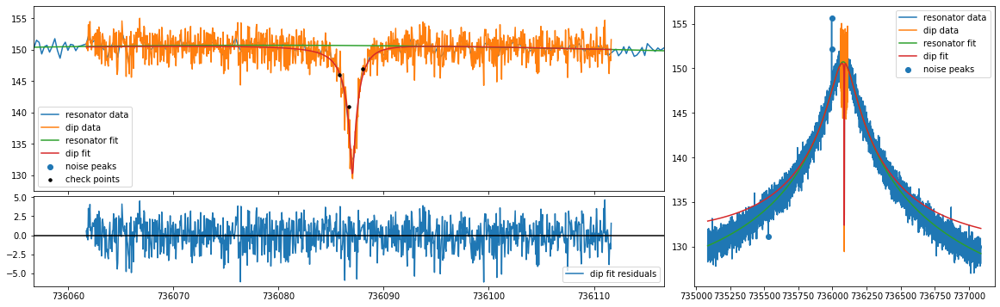

mean fit residuals = 1.6e-08 +/- 5.7e-02
original all {'A': 1123400190273712.0, 'dA': 16139147814649.902, 'Q': 4594.848629210814, 'dQ': 32.70963945572874, 'offset': 10363786335462.361, 'doffset': 2138333829253.8467, 'slope': -0.00038760864549104723, 'dslope': 1.7746313911257806e-05, 'nu_res': 736079.0484968121, 'dnu_res': 0.40835442177000636, 'nu_z': 736087.0238224851, 'dnu_z': 0.016421577096706663, 'dip_width': 3.0155511826802965, 'ddip_width': 0.11884702701978395, 'pcov': array([[ 2.696681943431e-04, -9.138482646063e-05, -2.136133414214e+09,
        -1.198598415910e+09],
       [-9.138482646063e-05,  1.412461583144e-02,  5.607059808684e+11,
         7.414501358007e+10],
       [-2.136133414214e+09,  5.607059808684e+11,  2.604720921831e+26,
        -3.346292924823e+24],
       [-1.198598415910e+09,  7.414501358007e+10, -3.346292924823e+24,
         4.572471565331e+24]]), 'perr': array([1.642157709671e-02, 1.188470270198e-01, 1.613914781465e+13,
       2.138333829254e+12]), 'popt': dic

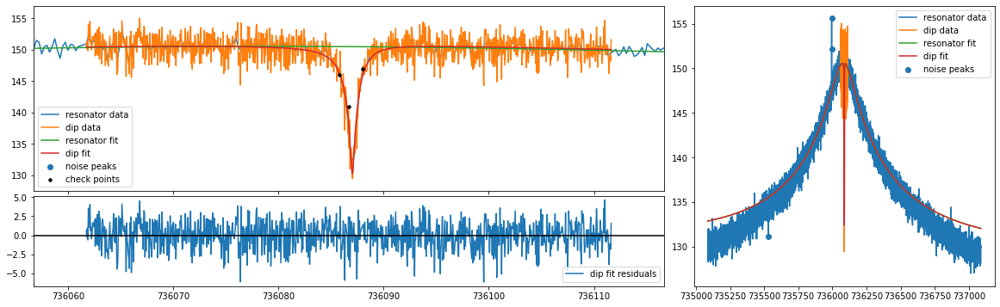

mean fit residuals = 2.0e-05 +/- 5.7e-02
[0.5, 3.0] 3.0 3.015654116842072 0.10693033028007504
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.023867626907
dnu_z                    0.016394796192
dip_width                3.015654116842
ddip_width                0.10693033028
fit_err                  3.310896227435
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off            10363786335462.361328125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             13731705605

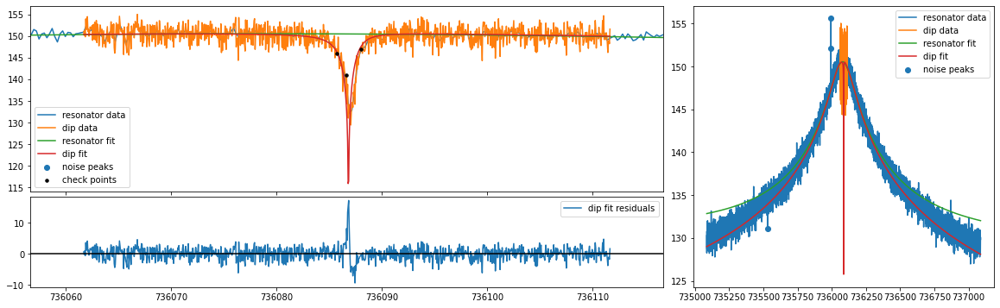

mean fit residuals = 2.4e-02 +/- 6.7e-02
[0.5, 3.0] 3.0 2.6087722344712034 0.09979772739713876
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736086.828792654676
dnu_z                    0.003645191868
dip_width                2.608772234471
ddip_width               0.099797727397
fit_err                  4.477215154034
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off                 215115983.923828125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             1373170560

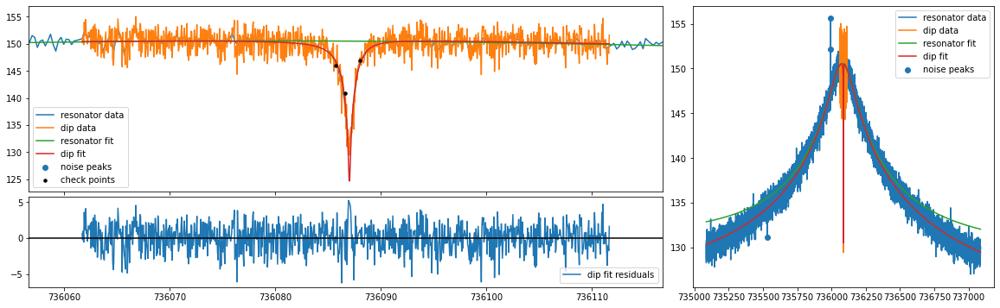

mean fit residuals = 3.0e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.82170867045881 0.09751916653835868
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.029209946049
dnu_z                    0.010602892579
dip_width                2.821708670459
ddip_width               0.097519166538
fit_err                  3.418475221527
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off            2591107920853.5322265625
doff           69688174010.805389404297
A                    1123400190273712.0
dA             137317056050

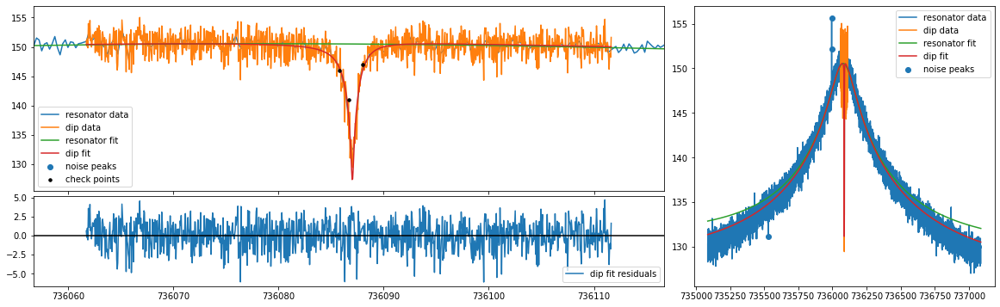

mean fit residuals = 2.2e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.9086723933117176 0.10099310255238167
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.026649378473
dnu_z                    0.013051563151
dip_width                2.908672393312
ddip_width               0.100993102552
fit_err                  3.343730384047
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off             5182000725723.142578125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             1373170560

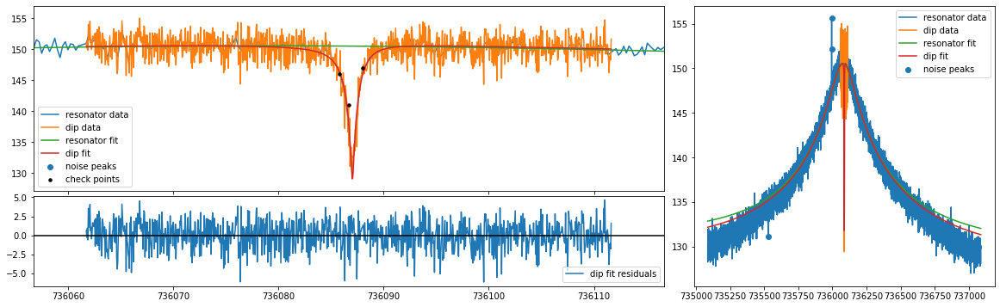

mean fit residuals = 1.1e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.968340804588834 0.10407072916337021
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.025037755258
dnu_z                    0.014865797754
dip_width                2.968340804589
ddip_width               0.104070729163
fit_err                  3.317283497249
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off             7772893530592.751953125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             13731705605

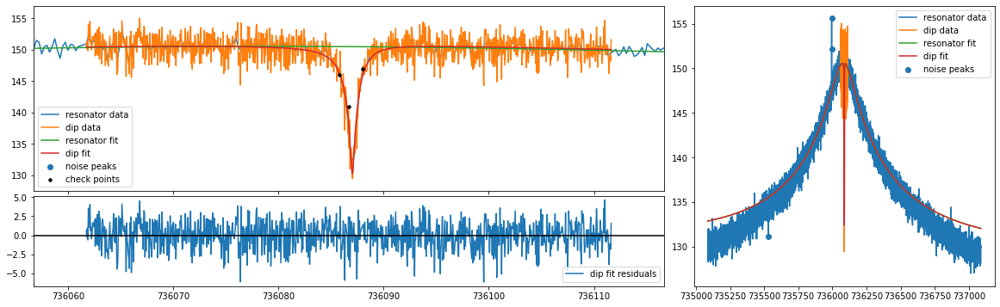

mean fit residuals = 2.0e-05 +/- 5.7e-02
[0.5, 3.0] 3.0 3.015654116842072 0.10693033028007504
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.023867626907
dnu_z                    0.016394796192
dip_width                3.015654116842
ddip_width                0.10693033028
fit_err                  3.310896227435
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off            10363786335462.361328125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             13731705605

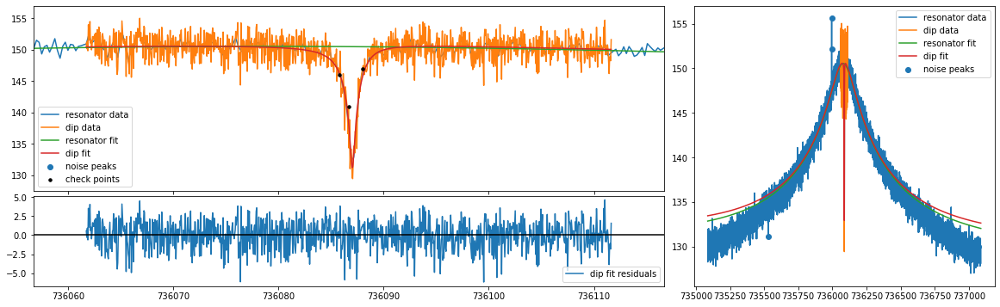

mean fit residuals = -1.2e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 3.0558899328795213 0.10964797551372467
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.022936127847
dnu_z                    0.017757332047
dip_width                 3.05588993288
ddip_width               0.109647975514
fit_err                  3.315251941511
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off            12954679140331.970703125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             137317056

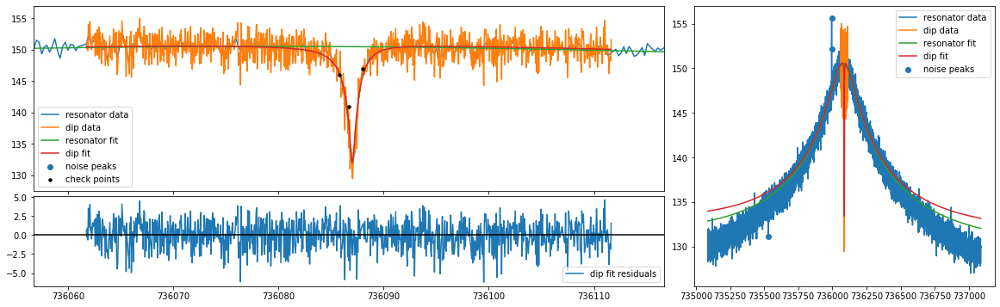

mean fit residuals = -2.3e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 3.0915630010986774 0.11226456711923677
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.022137959488
dnu_z                    0.019009999583
dip_width                3.091563001099
ddip_width               0.112264567119
fit_err                  3.326134209778
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off            15545571945201.580078125
doff           69688174010.805389404297
A                    1123400190273712.0
dA             137317056

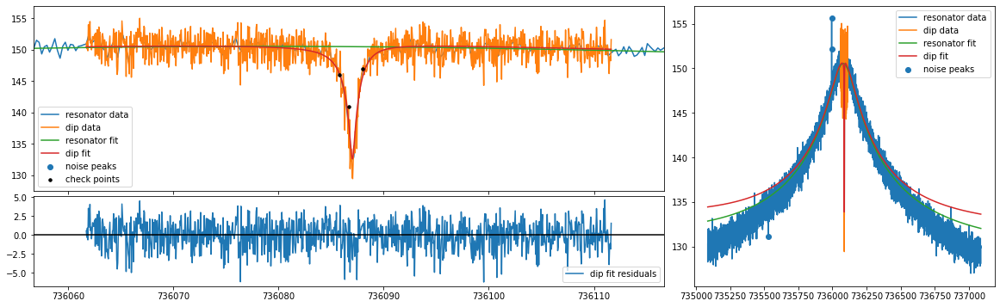

mean fit residuals = -3.4e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 3.1264606515265188 0.11484966646055357
mcycle                                1
cycle                                 2
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_175837.150109
nu_z                736087.021759033552
dnu_z                     0.02019231354
dip_width                3.126460651527
ddip_width               0.114849666461
fit_err                  3.341294838679
fit_success                        True
average_idx                           0
nu_res              736079.048496812116
dnu_res                   0.40835442177
Q                     4594.848629210814
dQ                      32.709639455729
th                      -0.000387608645
dth                      0.000017746314
off             18136464750071.19140625
doff           69688174010.805389404297
A                    1123400190273712.0
dA             137317056

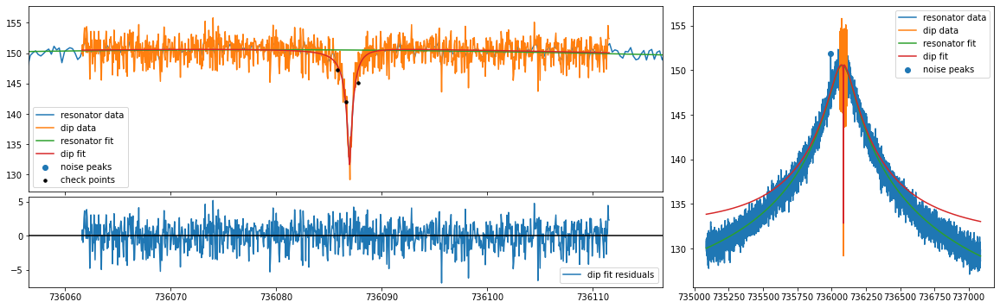

mean fit residuals = 2.5e-08 +/- 5.8e-02
original all {'A': 1134846405780923.2, 'dA': 16293254338939.518, 'Q': 4483.365623312994, 'dQ': 31.422954865359905, 'offset': 14500543569379.918, 'doffset': 3484123252379.4155, 'slope': -0.0003865273836577356, 'dslope': 1.7804613398213012e-05, 'nu_res': 736078.7101105899, 'dnu_res': 0.4142870534883789, 'nu_z': 736086.967652455, 'dnu_z': 0.01477849736308315, 'dip_width': 1.945134701603106, 'ddip_width': 0.0969985111694775, 'pcov': array([[ 2.184039843107e-04, -7.916108835805e-05, -3.588789109121e+08,
        -2.296003731060e+09],
       [-7.916108835805e-05,  9.408711169095e-03,  3.061718398034e+11,
         1.064790978249e+11],
       [-3.588789109121e+08,  3.061718398034e+11,  2.654701369534e+26,
        -1.064547397514e+25],
       [-2.296003731060e+09,  1.064790978249e+11, -1.064547397514e+25,
         1.213911483777e+25]]), 'perr': array([1.477849736308e-02, 9.699851116948e-02, 1.629325433894e+13,
       3.484123252379e+12]), 'popt': dict_val

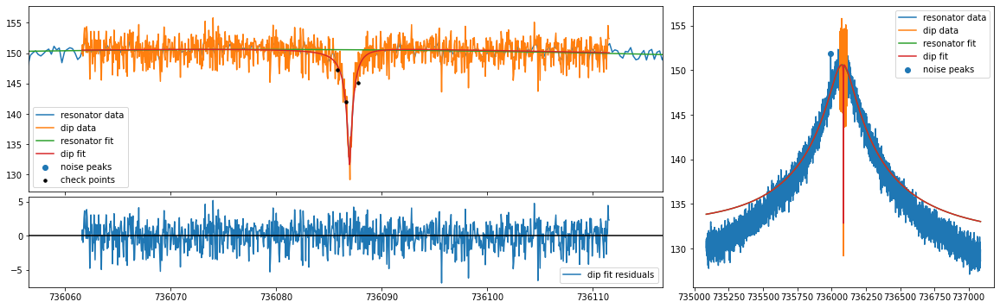

mean fit residuals = 2.8e-05 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9452835699974276 0.08852348186438298
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z               736086.967644194257
dnu_z                   0.014748890913
dip_width               1.945283569997
ddip_width              0.088523481864
fit_err                 3.351936378791
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off            14500543569379.91796875
doff           69857124154.57209777832
A                  1134846405780923.25
d

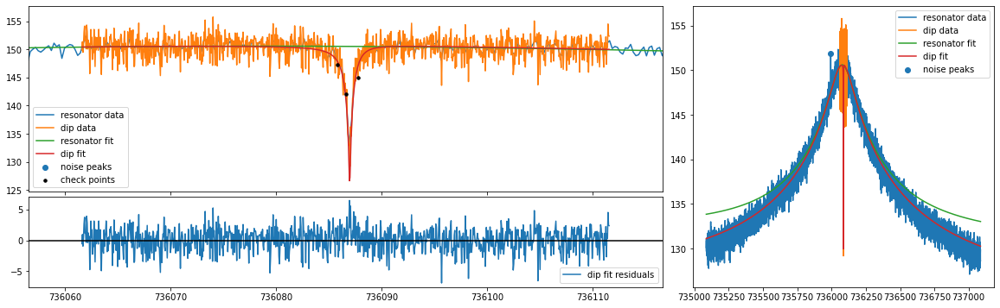

mean fit residuals = 6.8e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9451366151554734 0.08250243597523778
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_174818.540969
nu_z                736086.974285846693
dnu_z                    0.010039574622
dip_width                1.945136615155
ddip_width               0.082502435975
fit_err                  3.427593301174
fit_success                        True
average_idx                           0
nu_res              736078.710110589862
dnu_res                  0.414287053488
Q                     4483.365623312994
dQ                       31.42295486536
th                      -0.000386527384
dth                      0.000017804613
off              4136972349901.48046875
doff            69857124154.57209777832
A                  

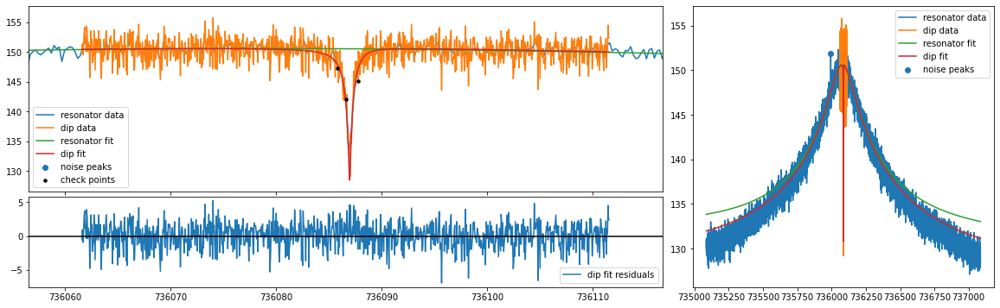

mean fit residuals = 4.9e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9451432828308903 0.08410015742253595
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_174818.540969
nu_z                736086.971124064527
dnu_z                      0.0115864873
dip_width                1.945143282831
ddip_width               0.084100157423
fit_err                  3.384241298371
fit_success                        True
average_idx                           0
nu_res              736078.710110589862
dnu_res                  0.414287053488
Q                     4483.365623312994
dQ                       31.42295486536
th                      -0.000386527384
dth                      0.000017804613
off            6727865154771.0888671875
doff            69857124154.57209777832
A                  

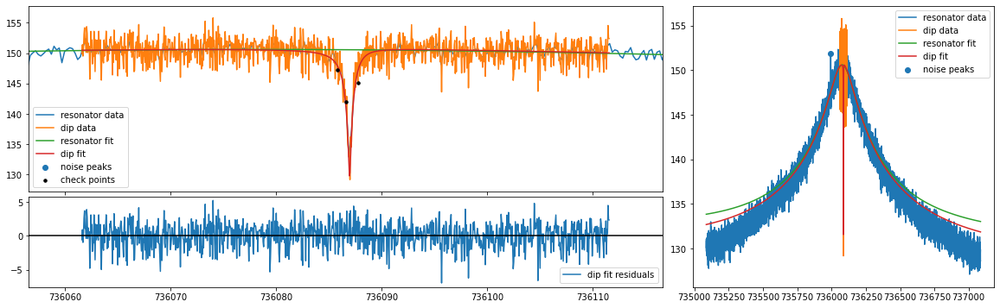

mean fit residuals = 3.2e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9451606934426393 0.08563208162137367
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z               736086.969441723544
dnu_z                     0.0127941316
dip_width               1.945160693443
ddip_width              0.085632081621
fit_err                 3.363626467988
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off             9318757959640.69921875
doff           69857124154.57209777832
A                  1134846405780923.25
d

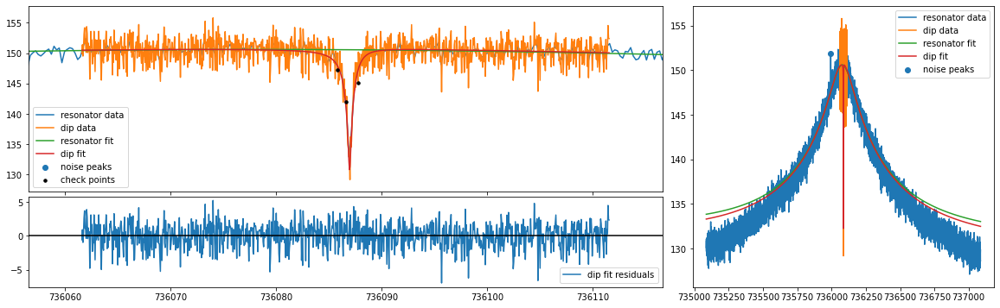

mean fit residuals = 1.5e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9452003635340265 0.08710299403475052
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z                736086.96838616929
dnu_z                   0.013826516076
dip_width               1.945200363534
ddip_width              0.087102994035
fit_err                 3.354407052897
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off            11909650764510.30859375
doff           69857124154.57209777832
A                  1134846405780923.25
d

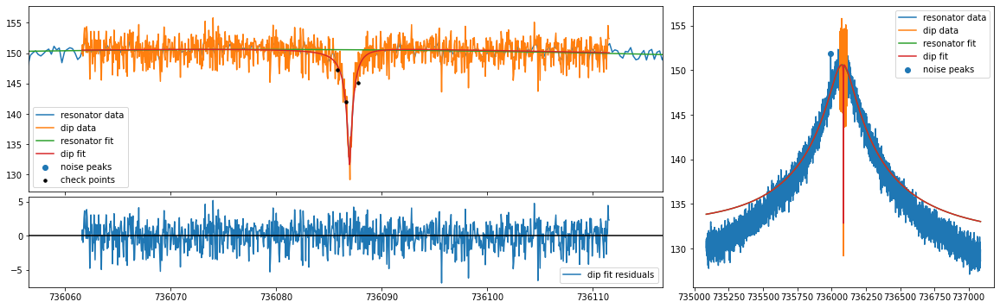

mean fit residuals = 2.8e-05 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9452835699974276 0.08852348186438298
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z               736086.967644194257
dnu_z                   0.014748890913
dip_width               1.945283569997
ddip_width              0.088523481864
fit_err                 3.351936378791
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off            14500543569379.91796875
doff           69857124154.57209777832
A                  1134846405780923.25
d

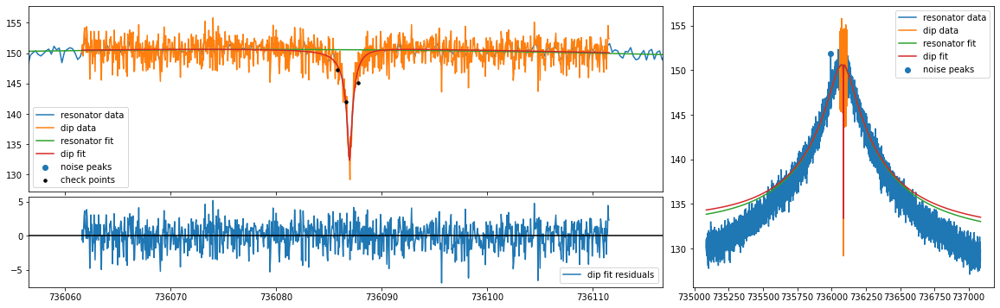

mean fit residuals = -1.5e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9454478723470996 0.08990328259871938
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z               736086.967079777736
dnu_z                   0.015594805251
dip_width               1.945447872347
ddip_width              0.089903282599
fit_err                 3.353880195276
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off            17091436374249.52734375
doff           69857124154.57209777832
A                  1134846405780923.25


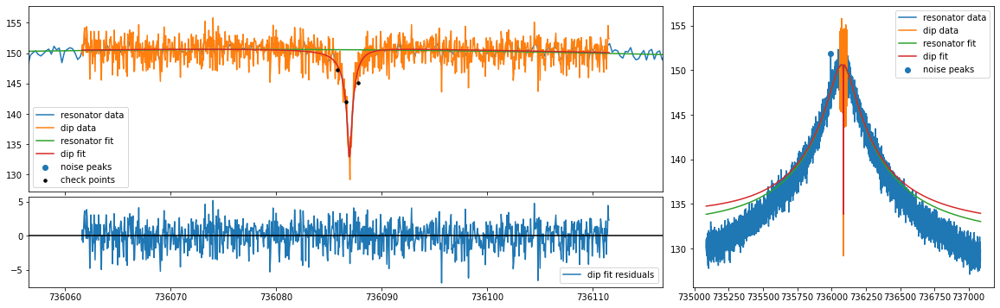

mean fit residuals = -3.0e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9451378967774926 0.09123548326638346
mcycle                                1
cycle                                 2
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_174818.540969
nu_z                736086.966636627563
dnu_z                    0.016381616566
dip_width                1.945137896777
ddip_width               0.091235483266
fit_err                  3.358851148784
fit_success                        True
average_idx                           0
nu_res              736078.710110589862
dnu_res                  0.414287053488
Q                     4483.365623312994
dQ                       31.42295486536
th                      -0.000386527384
dth                      0.000017804613
off             19682329179119.13671875
doff            69857124154.57209777832
A                 

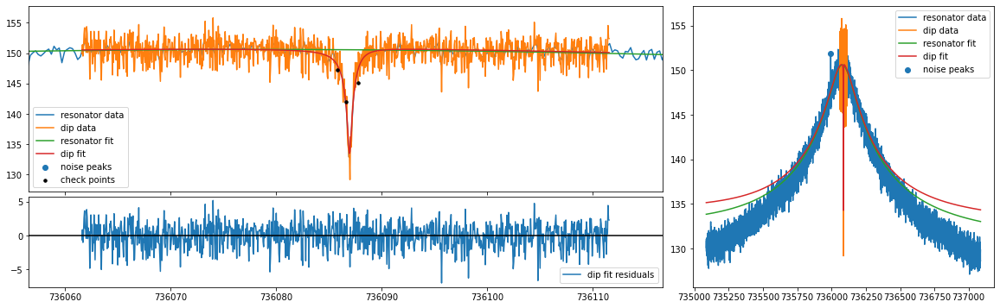

mean fit residuals = -4.4e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9451481247416968 0.09254529786181727
mcycle                               1
cycle                                2
position                    position_2
trap                                 2
acc_time                         20.05
time            20211124_174818.540969
nu_z               736086.966260597226
dnu_z                   0.017125590655
dip_width               1.945148124742
ddip_width              0.092545297862
fit_err                 3.366115525466
fit_success                       True
average_idx                          0
nu_res             736078.710110589862
dnu_res                 0.414287053488
Q                    4483.365623312994
dQ                      31.42295486536
th                     -0.000386527384
dth                     0.000017804613
off            22273221983988.74609375
doff           69857124154.57209777832
A                  1134846405780923.25


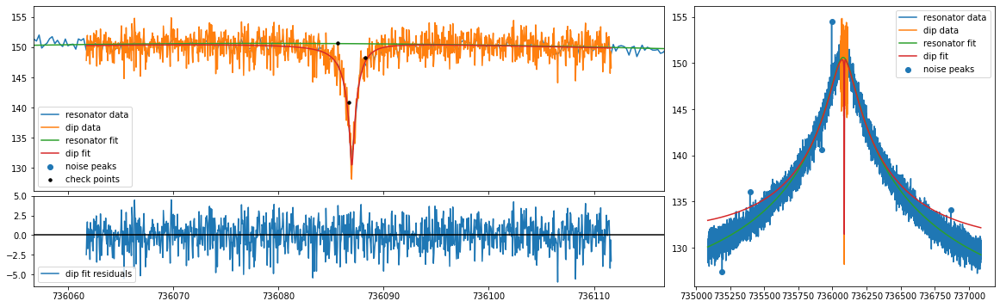

mean fit residuals = -2.7e-07 +/- 5.6e-02
original all {'A': 1078220230861551.9, 'dA': 15023367759419.242, 'Q': 4547.931579501703, 'dQ': 31.389741441610717, 'offset': 11015340545458.898, 'doffset': 2266549986153.3086, 'slope': -0.00037259712354323533, 'dslope': 1.72994976885952e-05, 'nu_res': 736078.893590476, 'dnu_res': 0.4004658137550897, 'nu_z': 736086.9767716764, 'dnu_z': 0.01573440114941895, 'dip_width': 2.738942728357352, 'ddip_width': 0.11057971469970419, 'pcov': array([[ 2.475713795308e-04, -8.468594595264e-05, -1.629092602352e+09,
        -1.284410898580e+09],
       [-8.468594595264e-05,  1.222787330307e-02,  4.478714898422e+11,
         7.488660916577e+10],
       [-1.629092602352e+09,  4.478714898422e+11,  2.257015788348e+26,
        -3.987686325289e+24],
       [-1.284410898580e+09,  7.488660916577e+10, -3.987686325289e+24,
         5.137248839732e+24]]), 'perr': array([1.573440114942e-02, 1.105797146997e-01, 1.502336775942e+13,
       2.266549986153e+12]), 'popt': dict_va

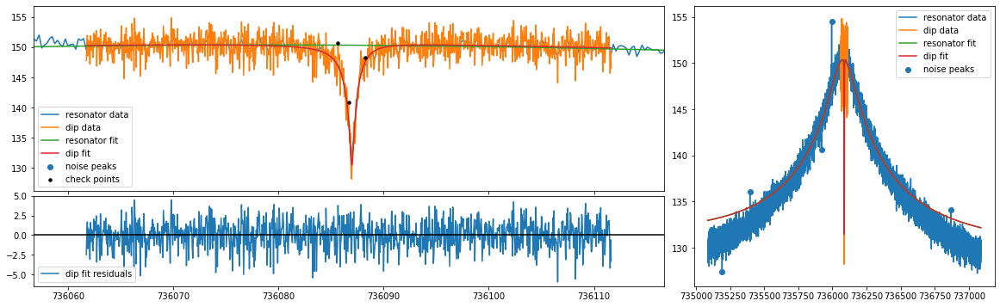

mean fit residuals = -5.7e-05 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7386438681001164 0.09982478264954694
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.976738934289
dnu_z                    0.015706622936
dip_width                  2.7386438681
ddip_width                0.09982478265
fit_err                  3.131828901788
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off              11015340545458.8984375
doff            68089438099.03133392334
A                  1078220230861551.875
dA             129774770

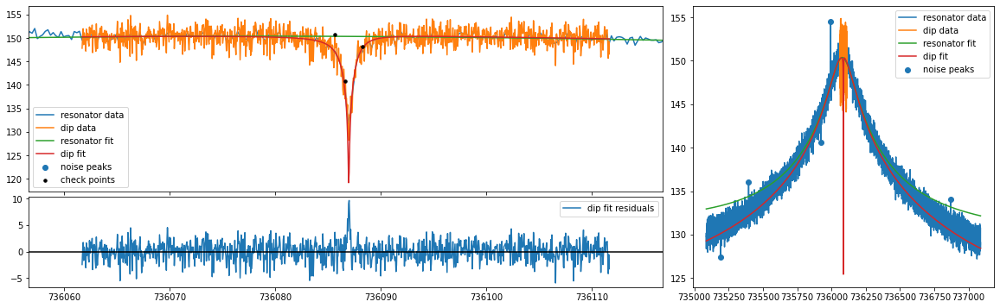

mean fit residuals = 6.8e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.593515553661714 0.0899542994965492
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.971085085766
dnu_z                    0.006685956017
dip_width                2.593515553662
ddip_width               0.089954299497
fit_err                  3.400860033271
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off                651769325980.4609375
doff            68089438099.03133392334
A                  1078220230861551.875
dA             129774770916

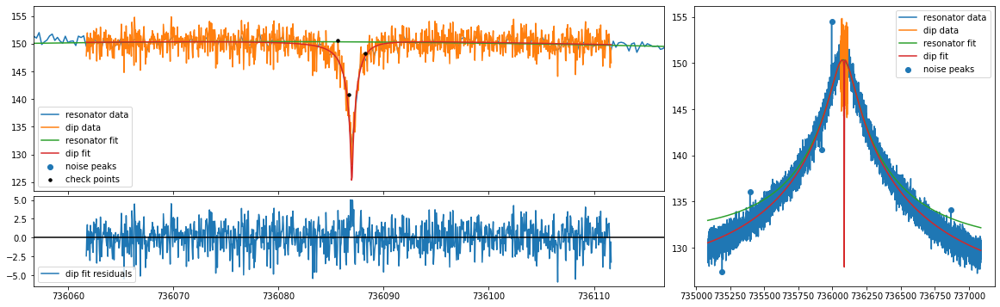

mean fit residuals = 3.6e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.5939205819059064 0.09146436915958171
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.972091056174
dnu_z                    0.010628285459
dip_width                2.593920581906
ddip_width                0.09146436916
fit_err                  3.206243338221
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off            3242662130850.0693359375
doff            68089438099.03133392334
A                  1078220230861551.875
dA             1297747709

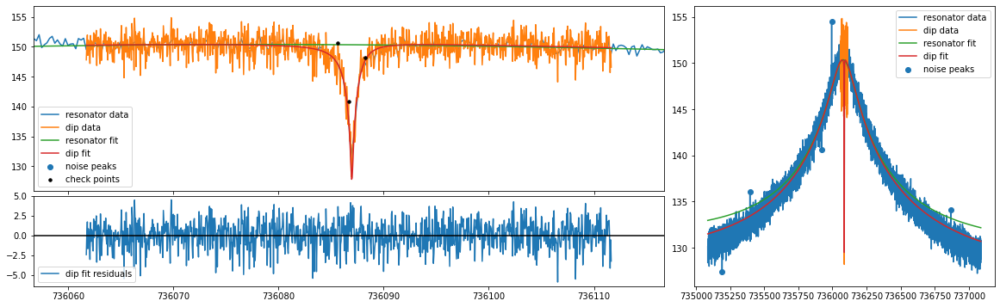

mean fit residuals = 2.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6317241707009735 0.09408391636615794
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.974508471903
dnu_z                    0.012657322621
dip_width                2.631724170701
ddip_width               0.094083916366
fit_err                  3.155369946327
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off               5833554935719.6796875
doff            68089438099.03133392334
A                  1078220230861551.875
dA             1297747709

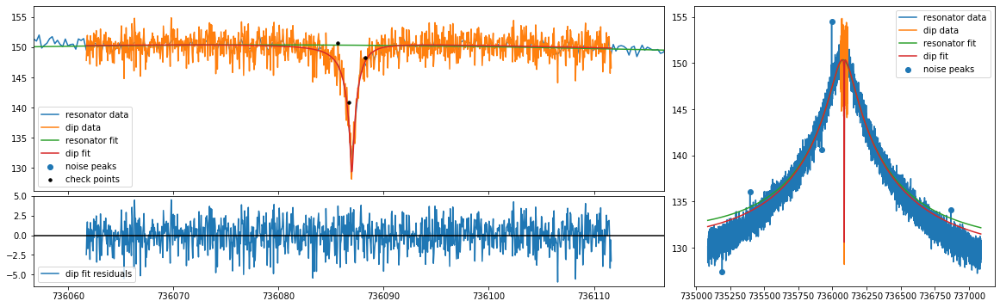

mean fit residuals = 1.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.690463213311624 0.09706698973199371
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.975922270794
dnu_z                    0.014298380693
dip_width                2.690463213312
ddip_width               0.097066989732
fit_err                   3.13647322803
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off               8424447740589.2890625
doff            68089438099.03133392334
A                  1078220230861551.875
dA             12977477091

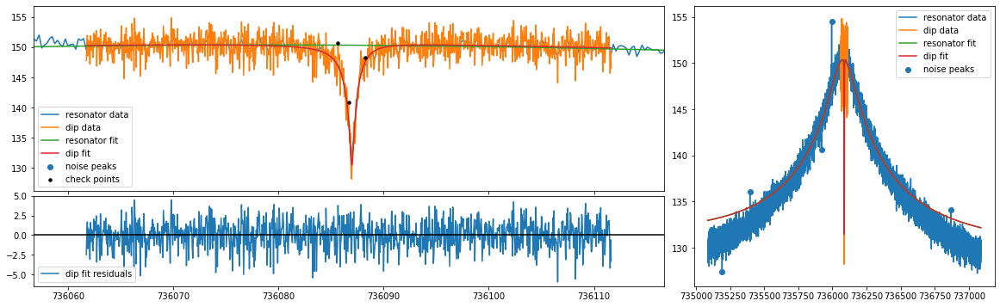

mean fit residuals = -5.7e-05 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7386438681001164 0.09982478264954694
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.976738934289
dnu_z                    0.015706622936
dip_width                  2.7386438681
ddip_width                0.09982478265
fit_err                  3.131828901788
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off              11015340545458.8984375
doff            68089438099.03133392334
A                  1078220230861551.875
dA             129774770

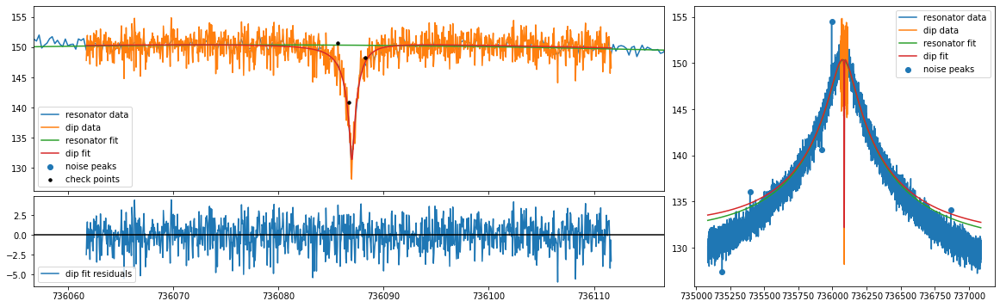

mean fit residuals = -1.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7816290973290934 0.10245691814370374
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.977226804011
dnu_z                    0.016977092986
dip_width                2.781629097329
ddip_width               0.102456918144
fit_err                  3.135197632424
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off              13606233350328.5078125
doff            68089438099.03133392334
A                  1078220230861551.875
dA             129774770

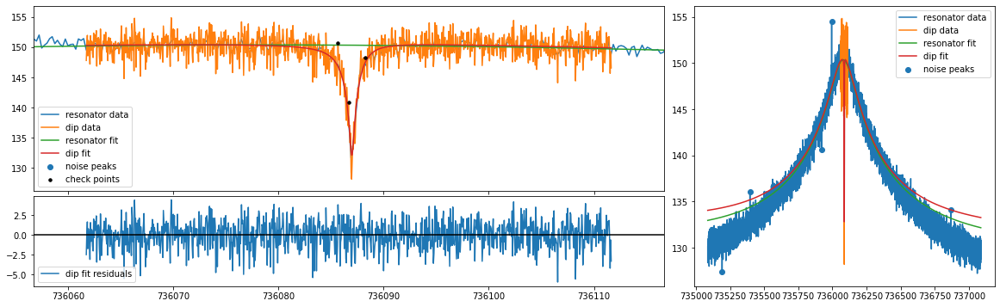

mean fit residuals = -2.2e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.819457337322988 0.10496777525848214
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.977444591001
dnu_z                    0.018149595244
dip_width                2.819457337323
ddip_width               0.104967775258
fit_err                  3.143609105393
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off              16197126155198.1171875
doff            68089438099.03133392334
A                  1078220230861551.875
dA             1297747709

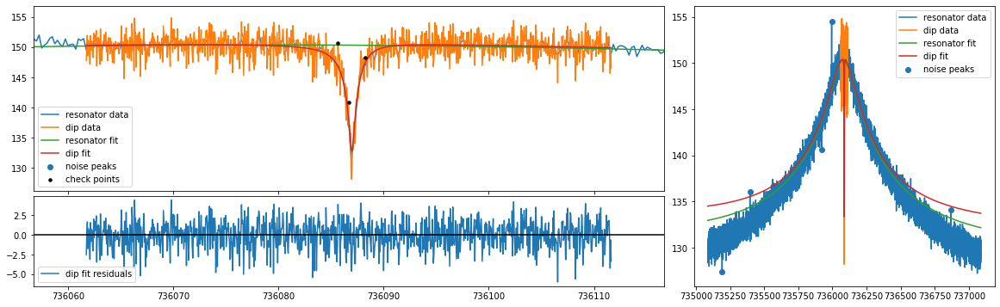

mean fit residuals = -3.3e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.8546400372523104 0.1074078790838933
mcycle                                1
cycle                                 3
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_181913.289641
nu_z                736086.977493610466
dnu_z                    0.019254667354
dip_width                2.854640037252
ddip_width               0.107407879084
fit_err                  3.155428002047
fit_success                        True
average_idx                           0
nu_res              736078.893590476015
dnu_res                  0.400465813755
Q                     4547.931579501703
dQ                      31.389741441611
th                      -0.000372597124
dth                      0.000017299498
off              18788018960067.7265625
doff            68089438099.03133392334
A                  1078220230861551.875
dA             1297747709

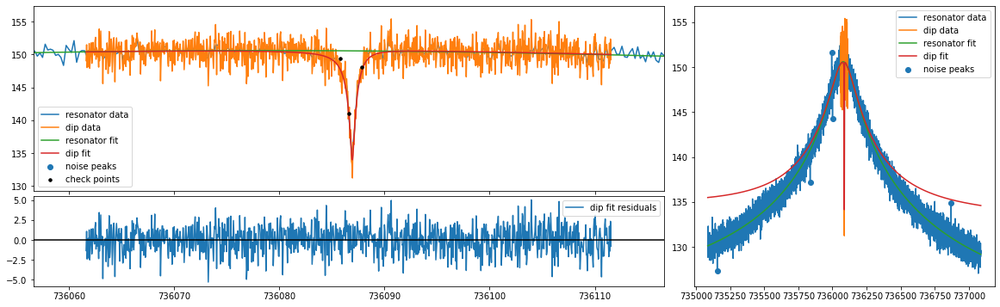

mean fit residuals = -2.8e-08 +/- 5.3e-02
original all {'A': 1104212294040867.2, 'dA': 15031476650013.123, 'Q': 4540.16529443108, 'dQ': 31.64100007869308, 'offset': 24763003277639.62, 'doffset': 4689634598663.812, 'slope': -0.0004328155107079534, 'dslope': 1.7484469500221548e-05, 'nu_res': 736079.2905519484, 'dnu_res': 0.4051831829980025, 'nu_z': 736086.9373717589, 'dnu_z': 0.016819177442689095, 'dip_width': 2.044885199121211, 'ddip_width': 0.0977979244124331, 'pcov': array([[ 2.828847298487e-04, -9.188429262027e-05,  2.706735676758e+08,
        -3.133082517918e+09],
       [-9.188429262027e-05,  9.564434019380e-03,  2.127893044642e+11,
         1.625787443206e+11],
       [ 2.706735676758e+08,  2.127893044642e+11,  2.259452902799e+26,
        -2.010460683591e+25],
       [-3.133082517918e+09,  1.625787443206e+11, -2.010460683591e+25,
         2.199267266898e+25]]), 'perr': array([1.681917744269e-02, 9.779792441243e-02, 1.503147665001e+13,
       4.689634598664e+12]), 'popt': dict_valu

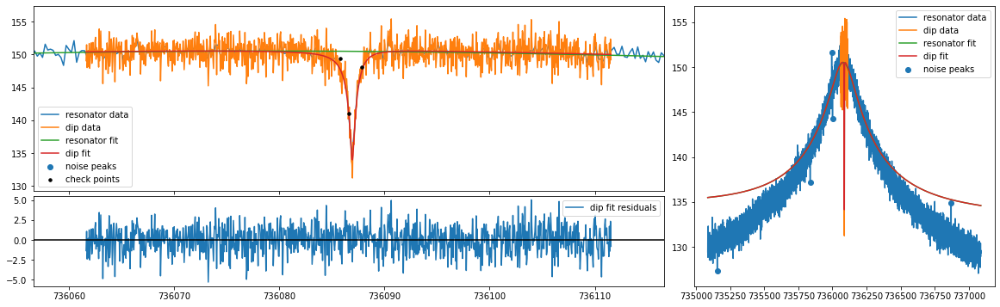

mean fit residuals = 4.3e-06 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.044909335834632 0.08785182018591253
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937371462351
dnu_z                    0.016788236404
dip_width                2.044909335835
ddip_width               0.087851820186
fit_err                  2.798217459284
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             24763003277639.62109375
doff           68607832569.664291381836
A                   

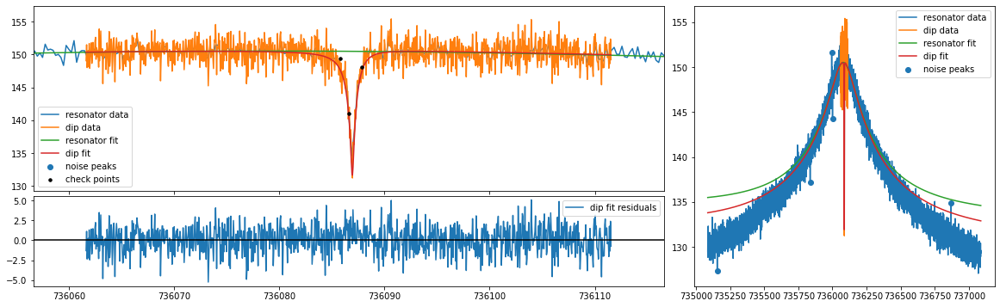

mean fit residuals = 6.0e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.044886328571419 0.08343771596434975
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937201852328
dnu_z                    0.013967652583
dip_width                2.044886328571
ddip_width               0.083437715964
fit_err                  2.821653867167
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             14399432058161.18359375
doff           68607832569.664291381836
A                   

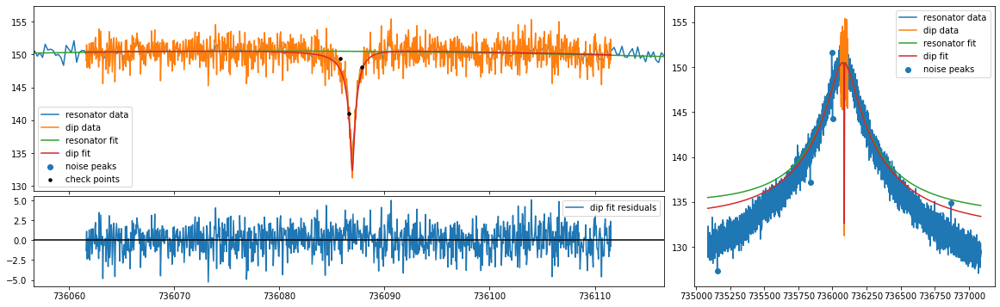

mean fit residuals = 4.4e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.044887808505187 0.08455927864932493
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937269392307
dnu_z                     0.01474105202
dip_width                2.044887808505
ddip_width               0.084559278649
fit_err                  2.810140051843
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             16990324863030.79296875
doff           68607832569.664291381836
A                   

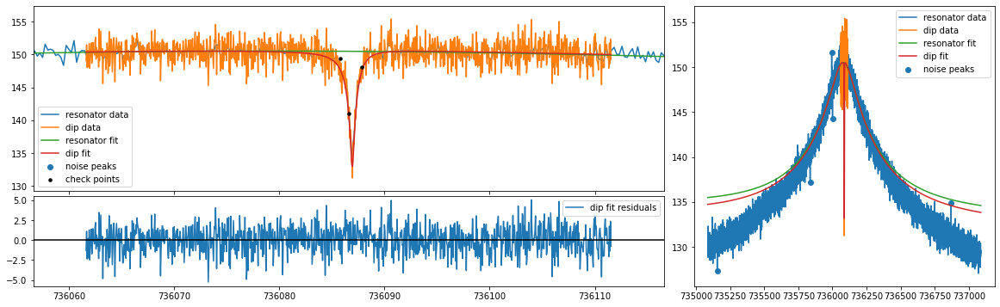

mean fit residuals = 2.9e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.0448909002254703 0.08566798855964491
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                 736086.93731877231
dnu_z                    0.015461414769
dip_width                2.044890900225
ddip_width                0.08566798856
fit_err                  2.803065348018
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             19581217667900.40234375
doff           68607832569.664291381836
A                  

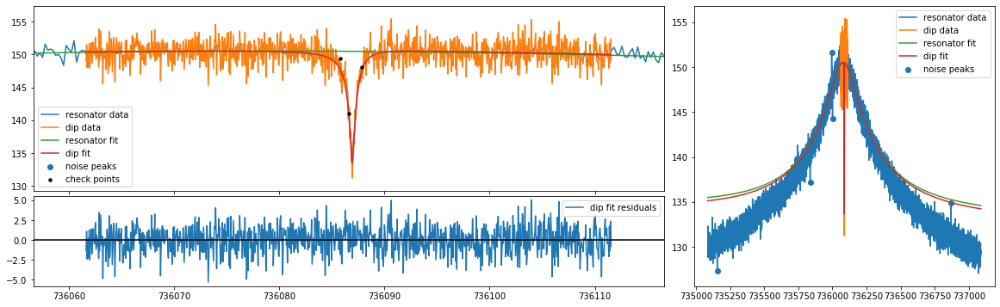

mean fit residuals = 1.4e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.0448971326613283 0.08676506332082903
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937351930188
dnu_z                    0.016140991064
dip_width                2.044897132661
ddip_width               0.086765063321
fit_err                  2.799335664656
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             22172110472770.01171875
doff           68607832569.664291381836
A                  

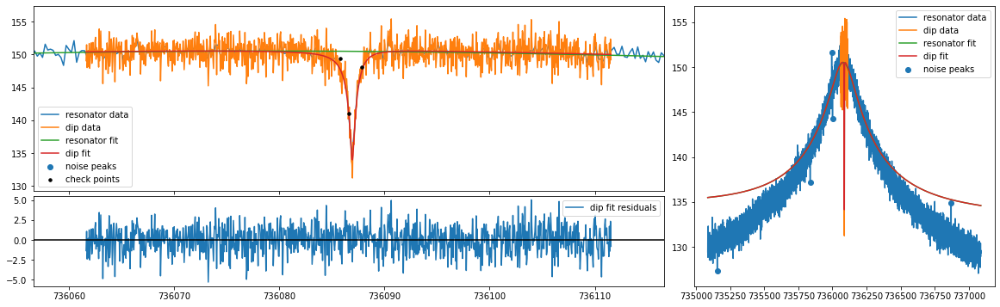

mean fit residuals = 4.3e-06 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.044909335834632 0.08785182018591253
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937371462351
dnu_z                    0.016788236404
dip_width                2.044909335835
ddip_width               0.087851820186
fit_err                  2.798217459284
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             24763003277639.62109375
doff           68607832569.664291381836
A                   

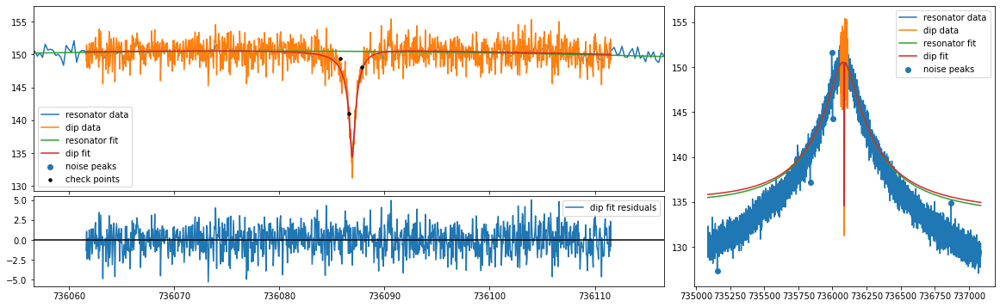

mean fit residuals = -1.4e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.044932642794096 0.088929598011137
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937379582087
dnu_z                    0.017409264632
dip_width                2.044932642794
ddip_width               0.088929598011
fit_err                  2.799196103137
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             27353896082509.23046875
doff           68607832569.664291381836
A                   1

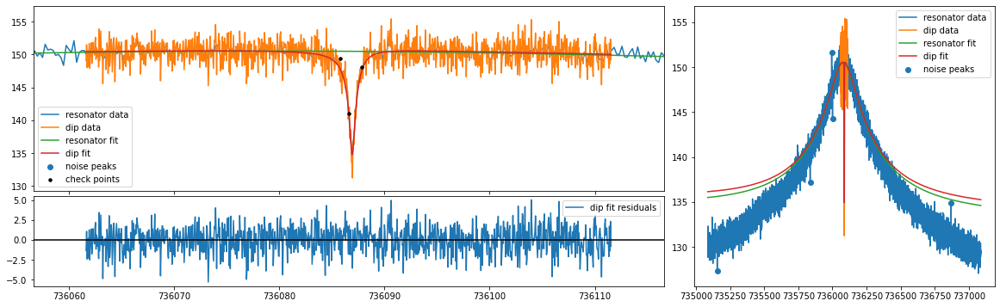

mean fit residuals = -2.8e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.0449761767265002 0.08999974187905711
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937377770897
dnu_z                    0.018008670525
dip_width                2.044976176727
ddip_width               0.089999741879
fit_err                  2.801897552321
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             29944788887378.83984375
doff           68607832569.664291381836
A                 

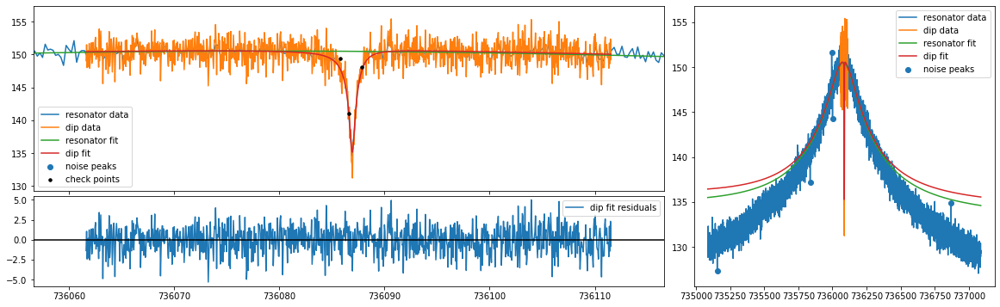

mean fit residuals = -4.2e-02 +/- 5.3e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.0450558078315924 0.09106363688934285
mcycle                                1
cycle                                 3
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_180855.348163
nu_z                736086.937366661849
dnu_z                    0.018590032894
dip_width                2.045055807832
ddip_width               0.091063636889
fit_err                   2.80604215389
fit_success                        True
average_idx                           0
nu_res              736079.290551948361
dnu_res                  0.405183182998
Q                      4540.16529443108
dQ                      31.641000078693
th                      -0.000432815511
dth                       0.00001748447
off             32535681692248.44921875
doff           68607832569.664291381836
A                 

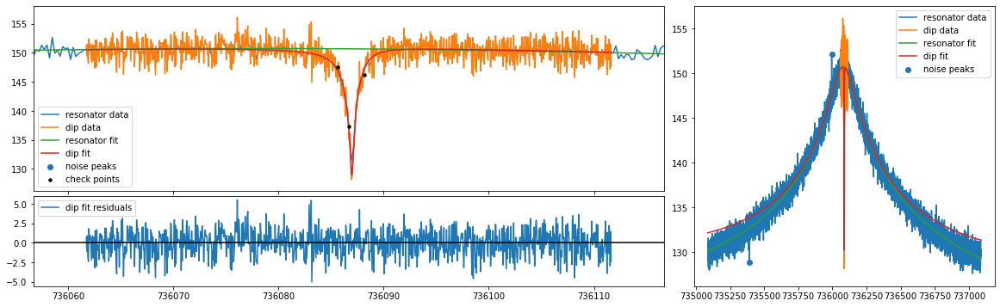

mean fit residuals = -1.9e-08 +/- 5.3e-02
original all {'A': 1149641830174076.8, 'dA': 14974512028855.01, 'Q': 4592.422682706252, 'dQ': 32.0431142284103, 'offset': 7708284613490.364, 'doffset': 1598090122423.2048, 'slope': -0.0003688316008733369, 'dslope': 1.7350424106310263e-05, 'nu_res': 736078.1666468332, 'dnu_res': 0.3998858685624685, 'nu_z': 736086.9773120384, 'dnu_z': 0.013278708563140843, 'dip_width': 2.885840620066856, 'ddip_width': 0.10305342388703269, 'pcov': array([[ 1.763241011048e-04, -6.669399862236e-05, -1.721959302476e+09,
        -8.082417714059e+08],
       [-6.669399862236e-05,  1.062000817484e-02,  4.583129700381e+11,
         4.478685222790e+10],
       [-1.721959302476e+09,  4.583129700381e+11,  2.242360105023e+26,
        -1.773544831346e+24],
       [-8.082417714059e+08,  4.478685222790e+10, -1.773544831346e+24,
         2.553892039387e+24]]), 'perr': array([1.327870856314e-02, 1.030534238870e-01, 1.497451202886e+13,
       1.598090122423e+12]), 'popt': dict_val

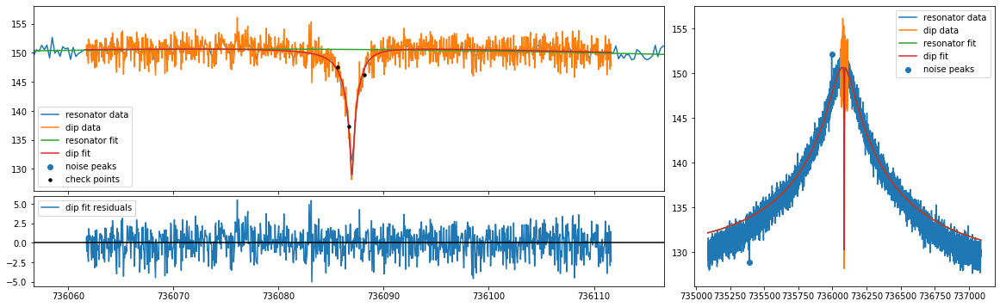

mean fit residuals = 3.4e-06 +/- 5.3e-02
[0.5, 3.0] 3.0 2.8858584824133655 0.09350421378192088
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.977311822935
dnu_z                    0.013254958775
dip_width                2.885858482413
ddip_width               0.093504213782
fit_err                  2.765956967656
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off            7708284613490.3642578125
doff           69184070609.184127807617
A                   1149641830174076.75
dA              134894661

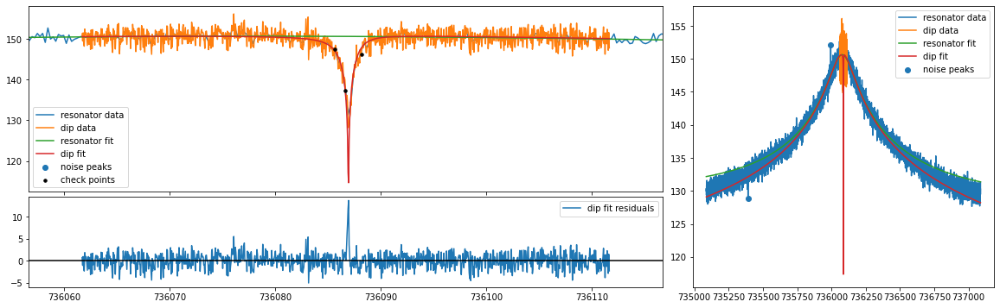

mean fit residuals = 4.0e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.66682876321144 0.08591768548670031
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                 736086.93319896562
dnu_z                    0.002624446106
dip_width                2.666828763211
ddip_width               0.085917685487
fit_err                  3.225015254465
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off                7708284.613490363583
doff           69184070609.184127807617
A                   1149641830174076.75
dA              13489466151

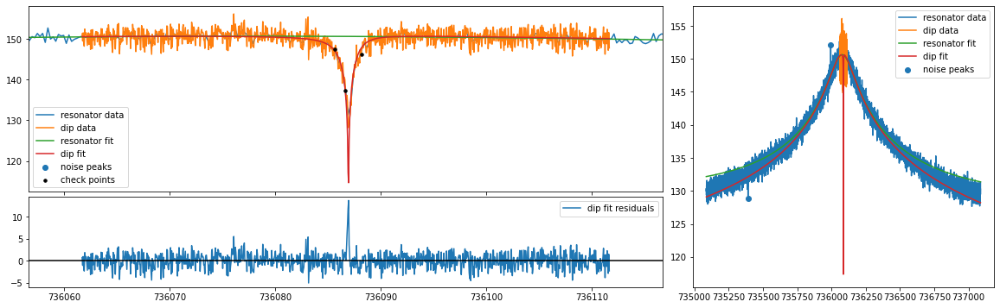

mean fit residuals = 4.0e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.66682876321144 0.08591768548670031
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                 736086.93319896562
dnu_z                    0.002624446106
dip_width                2.666828763211
ddip_width               0.085917685487
fit_err                  3.225015254465
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off                7708284.613490363583
doff           69184070609.184127807617
A                   1149641830174076.75
dA              13489466151

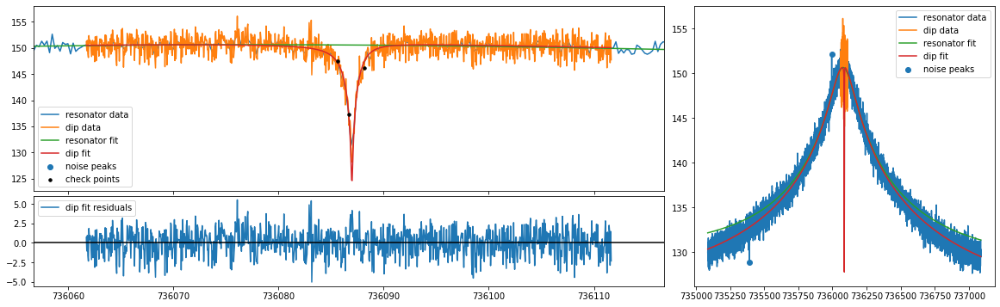

mean fit residuals = 1.8e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 2.742929623878633 0.08720000802519154
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.980461933184
dnu_z                    0.009366738462
dip_width                2.742929623879
ddip_width               0.087200008025
fit_err                  2.822171096056
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off            2526499003751.1455078125
doff           69184070609.184127807617
A                   1149641830174076.75
dA              1348946615

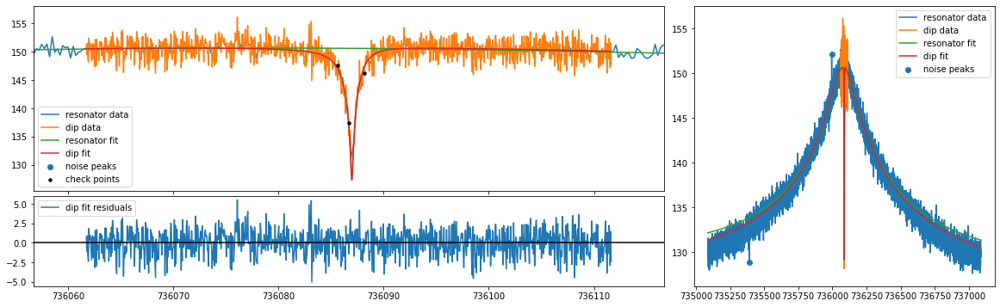

mean fit residuals = 9.8e-03 +/- 5.3e-02
[0.5, 3.0] 3.0 2.8261660253382157 0.09051451748690124
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.978796174051
dnu_z                    0.011596132423
dip_width                2.826166025338
ddip_width               0.090514517487
fit_err                  2.775033732834
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off            5117391808620.7548828125
doff           69184070609.184127807617
A                   1149641830174076.75
dA              134894661

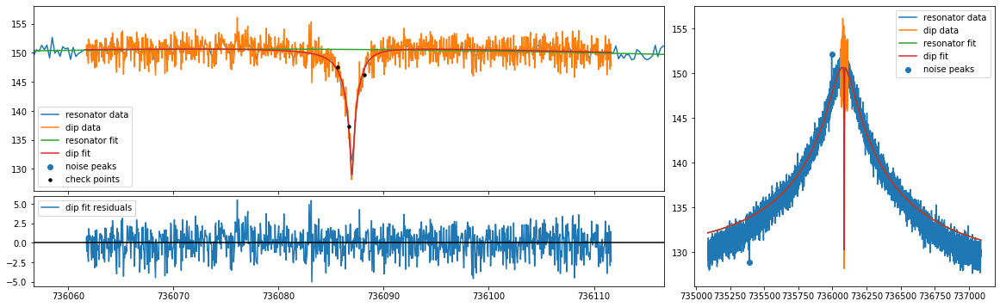

mean fit residuals = 3.4e-06 +/- 5.3e-02
[0.5, 3.0] 3.0 2.8858584824133655 0.09350421378192088
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.977311822935
dnu_z                    0.013254958775
dip_width                2.885858482413
ddip_width               0.093504213782
fit_err                  2.765956967656
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off            7708284613490.3642578125
doff           69184070609.184127807617
A                   1149641830174076.75
dA              134894661

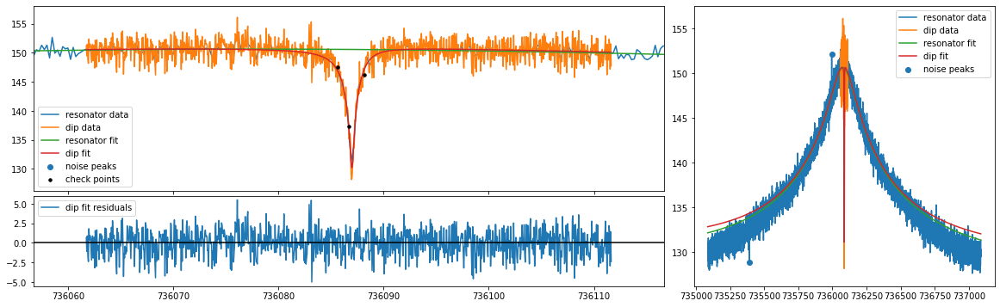

mean fit residuals = -1.0e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 2.935318791702448 0.09630341516545518
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.975922253565
dnu_z                    0.014660973809
dip_width                2.935318791702
ddip_width               0.096303415165
fit_err                  2.771438417211
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off             10299177418359.97265625
doff           69184070609.184127807617
A                   1149641830174076.75
dA              134894661

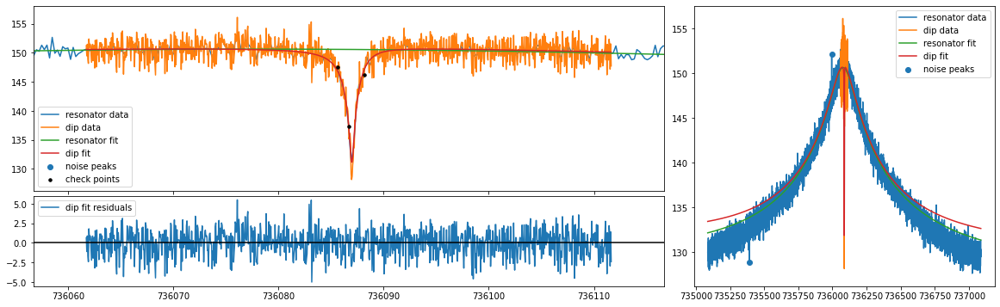

mean fit residuals = -2.1e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 2.9781004982128385 0.09895956472626267
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.974658659426
dnu_z                    0.015917984683
dip_width                2.978100498213
ddip_width               0.098959564726
fit_err                  2.784258108083
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off             12890070223229.58203125
doff           69184070609.184127807617
A                   1149641830174076.75
dA              13489466

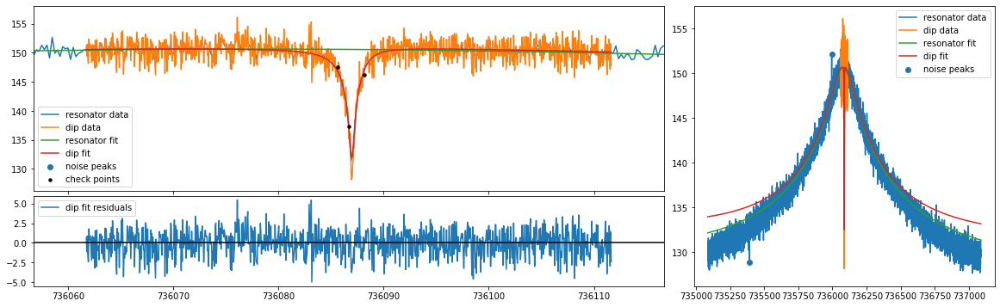

mean fit residuals = -3.1e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 3.0169476934693438 0.10151907957792815
mcycle                                1
cycle                                 4
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_183948.329480
nu_z                736086.973534200923
dnu_z                    0.017077786537
dip_width                3.016947693469
ddip_width               0.101519079578
fit_err                  2.801314689182
fit_success                        True
average_idx                           0
nu_res              736078.166646833182
dnu_res                  0.399885868562
Q                     4592.422682706252
dQ                       32.04311422841
th                      -0.000368831601
dth                      0.000017350424
off            15480963028099.193359375
doff           69184070609.184127807617
A                   1149641830174076.75
dA              13489466

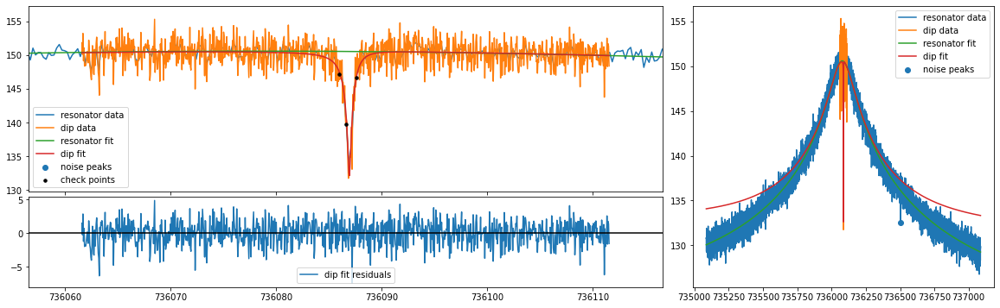

mean fit residuals = 1.4e-08 +/- 5.5e-02
original all {'A': 1097229495665132.4, 'dA': 15034086306929.855, 'Q': 4500.158712652552, 'dQ': 31.63479971345699, 'offset': 16230767041284.268, 'doffset': 3782269313749.938, 'slope': -0.00035548757596179424, 'dslope': 1.7745966630238526e-05, 'nu_res': 736078.7330256781, 'dnu_res': 0.4129086604973809, 'nu_z': 736086.9424162885, 'dnu_z': 0.01394192866621913, 'dip_width': 1.7430529610591659, 'ddip_width': 0.08815771457017821, 'pcov': array([[ 1.943773749339e-04, -7.119751860506e-05,  2.606472834355e+08,
        -2.484333605412e+09],
       [-7.119751860506e-05,  7.771782638237e-03,  2.137956269310e+11,
         1.085276009576e+11],
       [ 2.606472834355e+08,  2.137956269310e+11,  2.260237510842e+26,
        -1.297071978087e+25],
       [-2.484333605412e+09,  1.085276009576e+11, -1.297071978087e+25,
         1.430556116173e+25]]), 'perr': array([1.394192866622e-02, 8.815771457018e-02, 1.503408630693e+13,
       3.782269313750e+12]), 'popt': dict_v

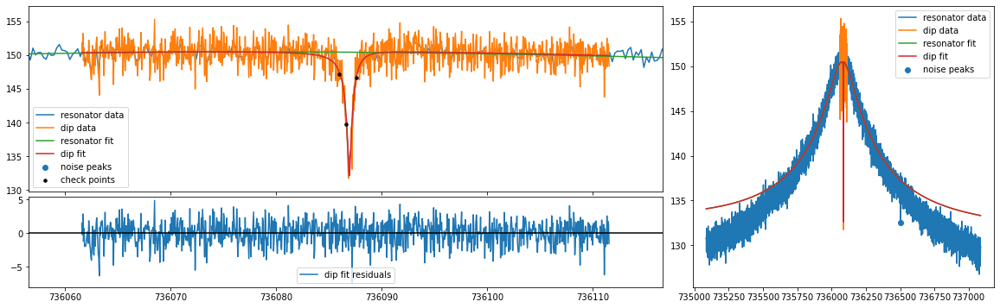

mean fit residuals = -1.9e-05 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7429504783212626 0.08049962675628386
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.942466003122
dnu_z                    0.013911447955
dip_width                1.742950478321
ddip_width               0.080499626756
fit_err                  3.014391382021
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off            16230767041284.267578125
doff           70247662886.273880004883
A                 

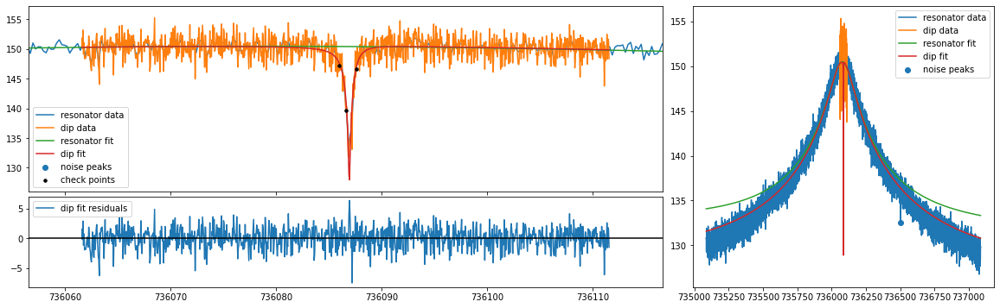

mean fit residuals = 4.5e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6487669821624547 0.07322758044720246
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.938657515915
dnu_z                    0.009866293491
dip_width                1.648766982162
ddip_width               0.073227580447
fit_err                  3.067240995232
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off             5867195821805.830078125
doff           70247662886.273880004883
A                  

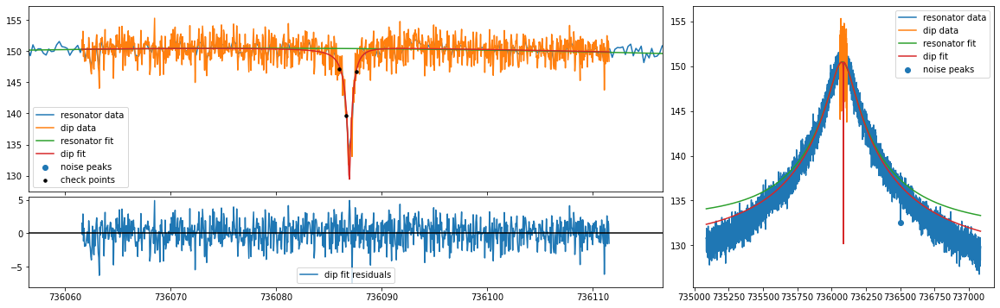

mean fit residuals = 3.4e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.6760750326022429 0.07517622353564188
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.940182349645
dnu_z                    0.011075637519
dip_width                1.676075032602
ddip_width               0.075176223536
fit_err                  3.038453109375
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off            8458088626675.4384765625
doff           70247662886.273880004883
A                  

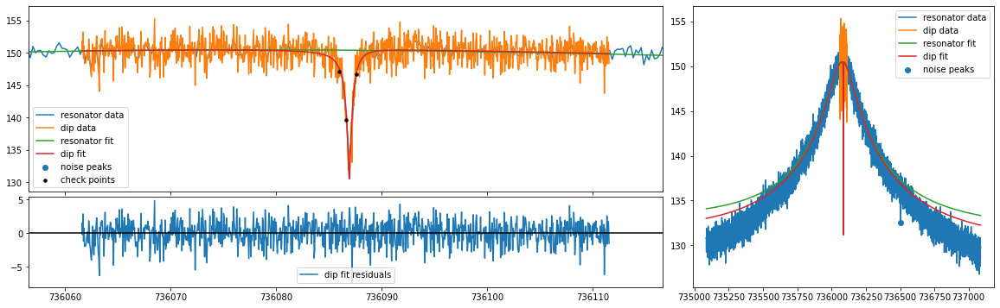

mean fit residuals = 2.3e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7013934579430297 0.07704641302903582
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.941126691643
dnu_z                    0.012118434282
dip_width                1.701393457943
ddip_width               0.077046413029
fit_err                  3.023421351864
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off            11048981431545.048828125
doff           70247662886.273880004883
A                  

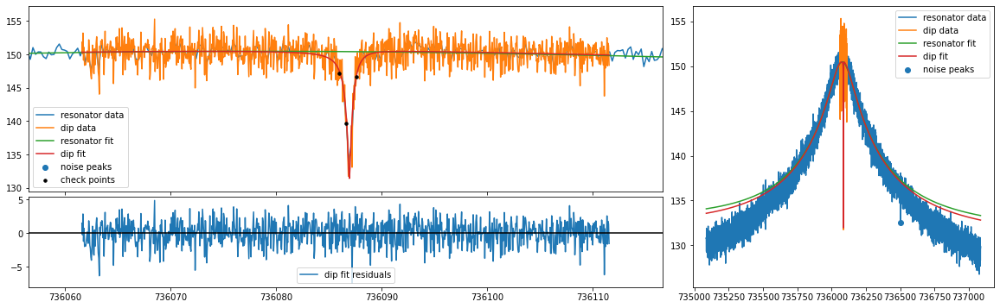

mean fit residuals = 1.1e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7236268847145422 0.07881816856642045
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.941920700017
dnu_z                    0.013053541412
dip_width                1.723626884715
ddip_width               0.078818168566
fit_err                  3.016347718438
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off            13639874236414.658203125
doff           70247662886.273880004883
A                  

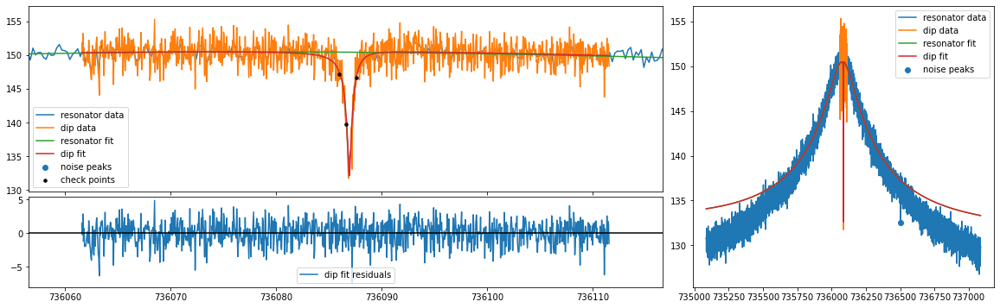

mean fit residuals = -1.9e-05 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7429504783212626 0.08049962675628386
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.942466003122
dnu_z                    0.013911447955
dip_width                1.742950478321
ddip_width               0.080499626756
fit_err                  3.014391382021
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off            16230767041284.267578125
doff           70247662886.273880004883
A                 

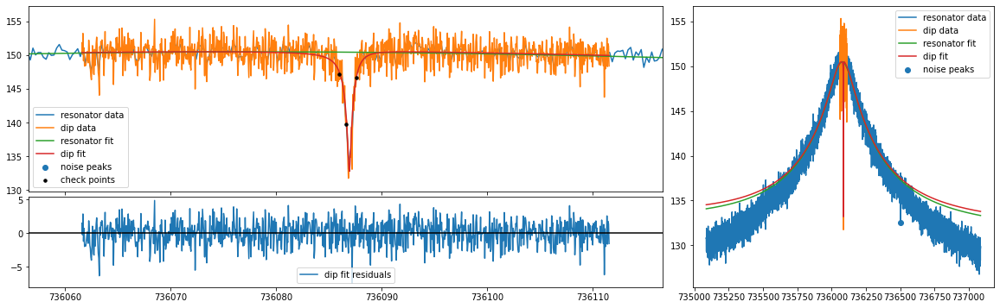

mean fit residuals = -1.1e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7607606464881078 0.08212673914508002
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.942894585081
dnu_z                     0.01471513331
dip_width                1.760760646488
ddip_width               0.082126739145
fit_err                  3.015979739253
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off                  18821659846153.875
doff           70247662886.273880004883
A                 

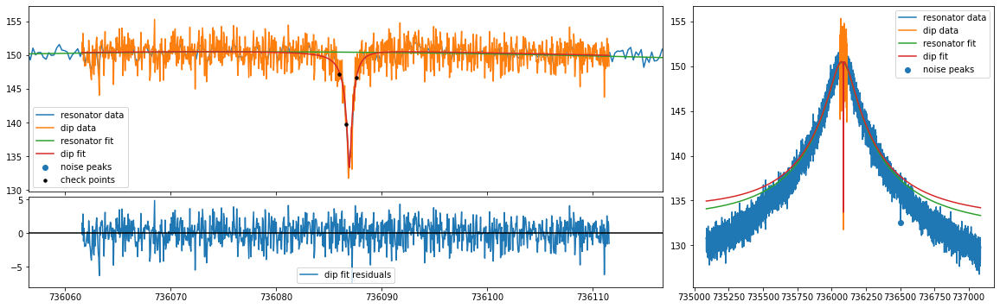

mean fit residuals = -2.3e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7773167814751463 0.08370862405010733
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.943230248406
dnu_z                    0.015477087796
dip_width                1.777316781475
ddip_width                0.08370862405
fit_err                  3.020146664443
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off               21412552651023.484375
doff           70247662886.273880004883
A                 

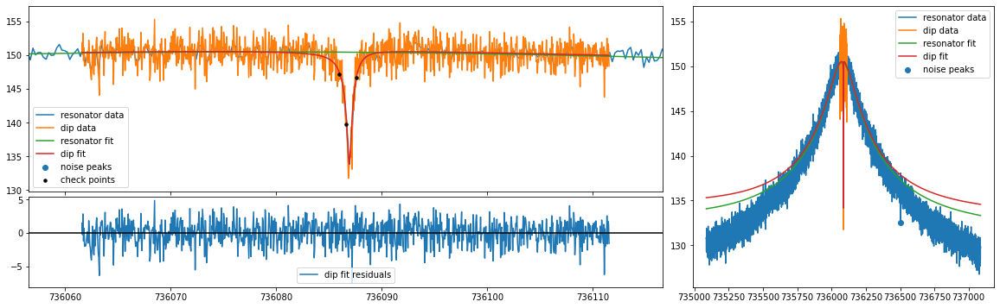

mean fit residuals = -3.4e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7928803410068586 0.08525388902662905
mcycle                                1
cycle                                 4
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_182930.582626
nu_z                736086.943489992525
dnu_z                    0.016206209066
dip_width                1.792880341007
ddip_width               0.085253889027
fit_err                  3.026262099764
fit_success                        True
average_idx                           0
nu_res              736078.733025678084
dnu_res                  0.412908660497
Q                     4500.158712652552
dQ                      31.634799713457
th                      -0.000355487576
dth                      0.000017745967
off             24003445455893.09765625
doff           70247662886.273880004883
A                 

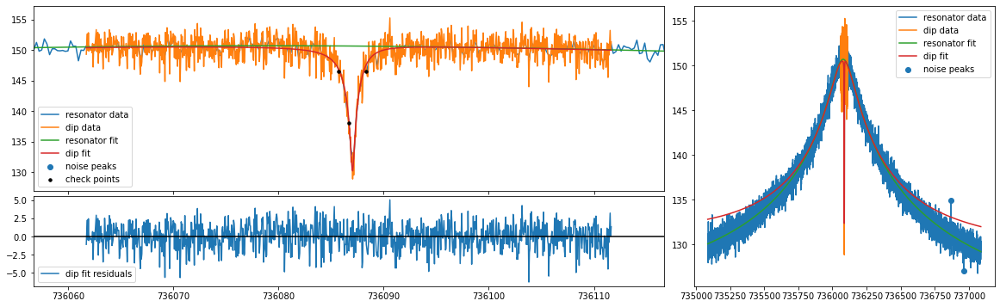

mean fit residuals = 4.3e-08 +/- 5.5e-02
original all {'A': 1107354198049314.4, 'dA': 15125795692632.35, 'Q': 4578.729054073775, 'dQ': 32.0558292535768, 'offset': 10368713912276.648, 'doffset': 2087458168933.6406, 'slope': -0.0003842554476818476, 'dslope': 1.7484628498877668e-05, 'nu_res': 736079.0413117053, 'dnu_res': 0.4029783536367301, 'nu_z': 736087.040936179, 'dnu_z': 0.01531868689630895, 'dip_width': 2.859190673659556, 'ddip_width': 0.1100985862122477, 'pcov': array([[ 2.346621682271e-04, -8.009434486818e-05, -1.725220805843e+09,
        -1.130201484205e+09],
       [-8.009434486818e-05,  1.212169868594e-02,  4.692922483604e+11,
         6.732306740125e+10],
       [-1.725220805843e+09,  4.692922483604e+11,  2.287896953353e+26,
        -3.272728126832e+24],
       [-1.130201484205e+09,  6.732306740125e+10, -3.272728126832e+24,
         4.357481607048e+24]]), 'perr': array([1.531868689631e-02, 1.100985862122e-01, 1.512579569263e+13,
       2.087458168934e+12]), 'popt': dict_values

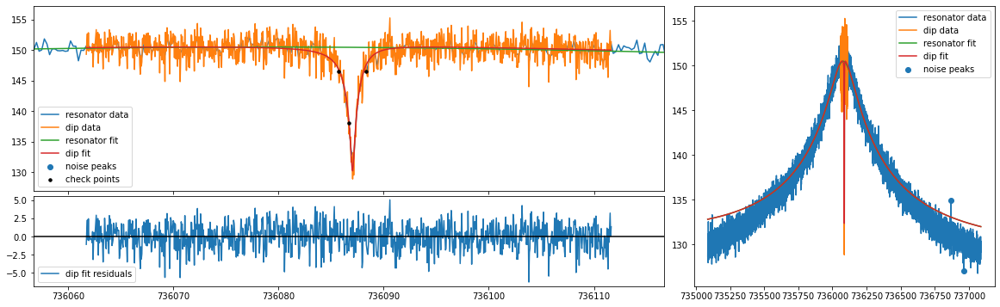

mean fit residuals = -2.2e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8590735285111823 0.09933443082018185
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.040967438254
dnu_z                    0.015292532086
dip_width                2.859073528511
ddip_width                0.09933443082
fit_err                  3.009057472888
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off              10368713912276.6484375
doff           68902851860.790588378906
A                  1107354198049314.375
dA             134022812

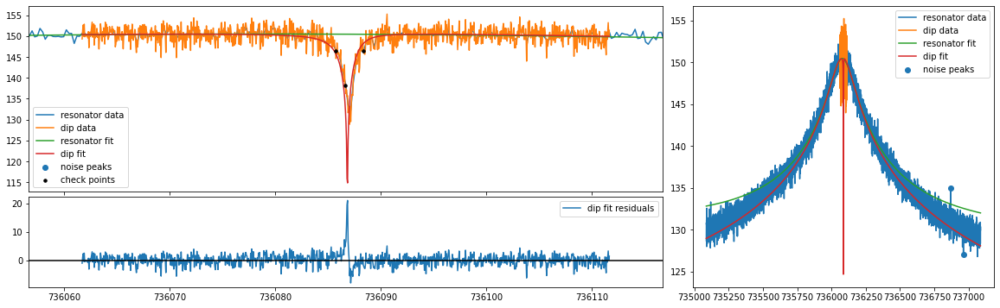

mean fit residuals = 1.1e-01 +/- 6.7e-02
[0.5, 3.0] 3.0 2.845182181404133 0.104175907640634
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736086.831163063878
dnu_z                    0.003480090668
dip_width                2.845182181404
ddip_width               0.104175907641
fit_err                  4.453559983185
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off                  5142692798.2109375
doff           68902851860.790588378906
A                  1107354198049314.375
dA             1340228127404

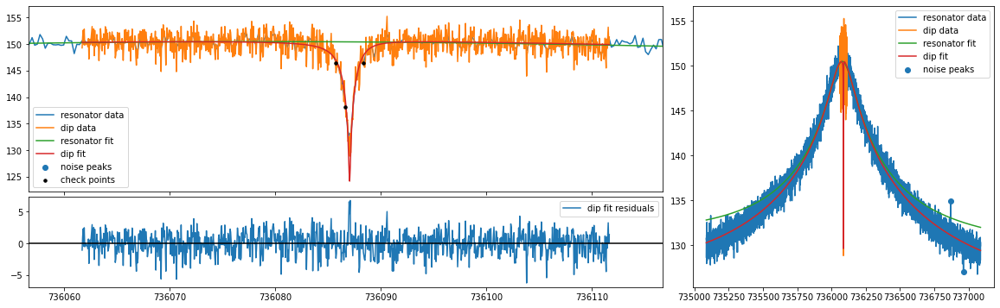

mean fit residuals = 3.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6778411868351917 0.0906982233068711
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.050253441441
dnu_z                    0.009939419648
dip_width                2.677841186835
ddip_width               0.090698223307
fit_err                  3.114648887651
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off            2596035497667.8193359375
doff           68902851860.790588378906
A                  1107354198049314.375
dA             13402281274

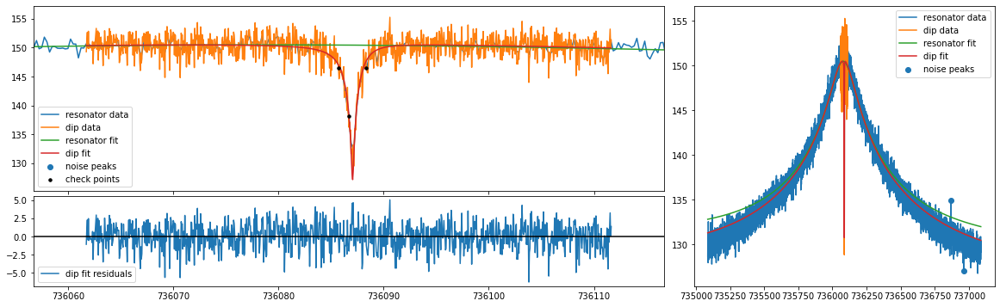

mean fit residuals = 2.2e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7589901962167733 0.09384717324371863
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.045852152747
dnu_z                    0.012180690108
dip_width                2.758990196217
ddip_width               0.093847173244
fit_err                  3.040927125439
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off               5186928302537.4296875
doff           68902851860.790588378906
A                  1107354198049314.375
dA             1340228127

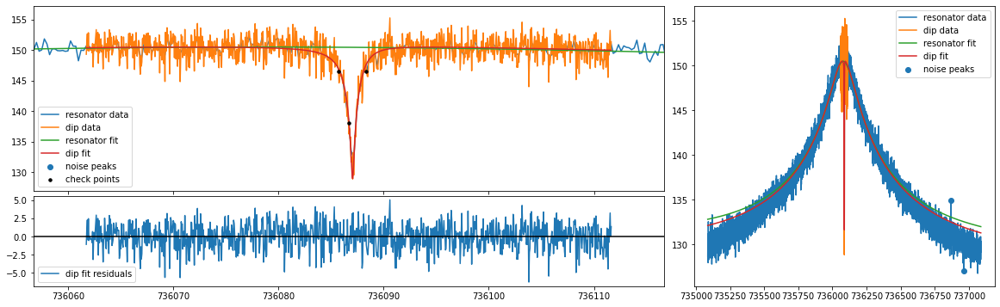

mean fit residuals = 1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8137382867733525 0.09666263531011009
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.043048019405
dnu_z                    0.013864718343
dip_width                2.813738286773
ddip_width                0.09666263531
fit_err                  3.015189603558
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off               7777821107407.0390625
doff           68902851860.790588378906
A                  1107354198049314.375
dA             1340228127

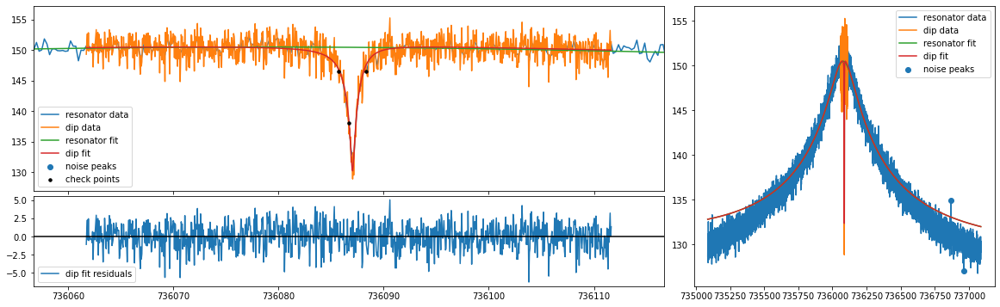

mean fit residuals = -2.2e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8590735285111823 0.09933443082018185
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.040967438254
dnu_z                    0.015292532086
dip_width                2.859073528511
ddip_width                0.09933443082
fit_err                  3.009057472888
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off              10368713912276.6484375
doff           68902851860.790588378906
A                  1107354198049314.375
dA             134022812

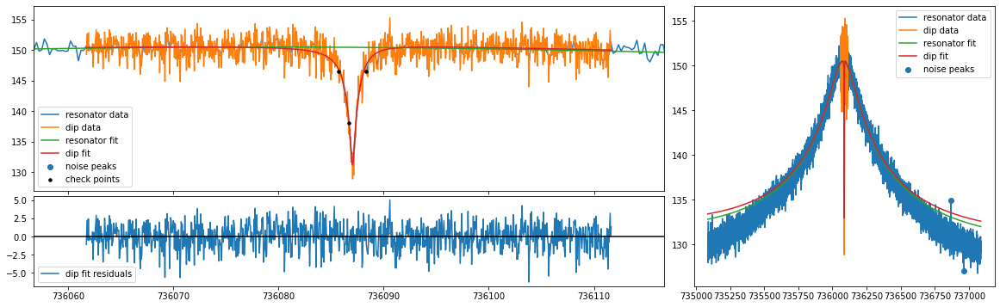

mean fit residuals = -1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8983722816036837 0.10189499709265332
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.039330747211
dnu_z                     0.01656896152
dip_width                2.898372281604
ddip_width               0.101894997093
fit_err                   3.01324915596
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off              12959606717146.2578125
doff           68902851860.790588378906
A                  1107354198049314.375
dA             134022812

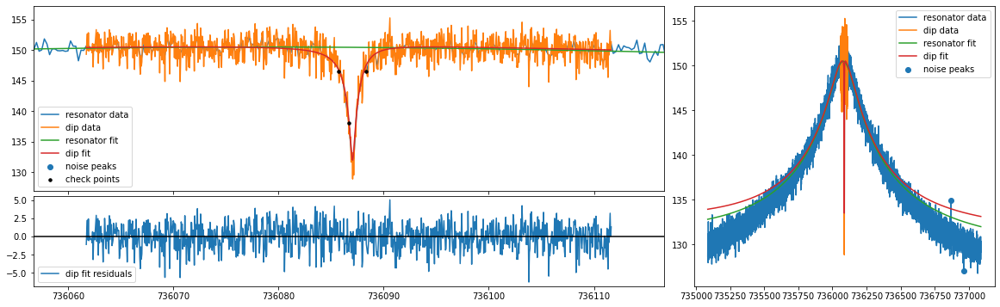

mean fit residuals = -2.3e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9336580601896136 0.10437179342428234
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.037989827804
dnu_z                    0.017745236439
dip_width                 2.93365806019
ddip_width               0.104371793424
fit_err                  3.023620314255
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off              15550499522015.8671875
doff           68902851860.790588378906
A                  1107354198049314.375
dA             134022812

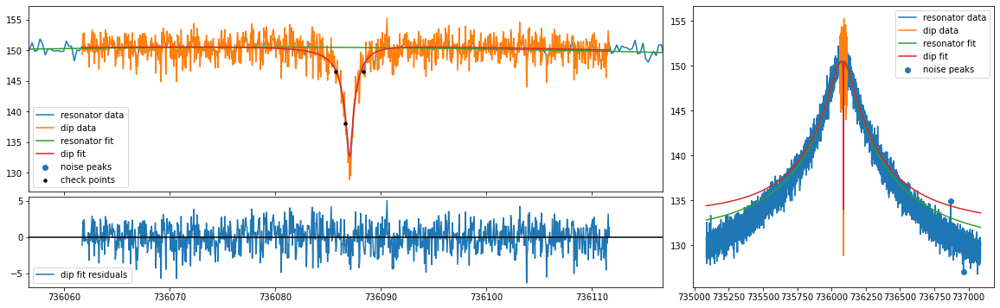

mean fit residuals = -3.5e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.966160461448738 0.10678455059236613
mcycle                                1
cycle                                 5
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_190023.888411
nu_z                736087.036892950418
dnu_z                    0.018850471553
dip_width                2.966160461449
ddip_width               0.106784550592
fit_err                  3.037993554511
fit_success                        True
average_idx                           0
nu_res              736079.041311705252
dnu_res                  0.402978353637
Q                     4578.729054073775
dQ                      32.055829253577
th                      -0.000384255448
dth                      0.000017484628
off              18141392326885.4765625
doff           68902851860.790588378906
A                  1107354198049314.375
dA             1340228127

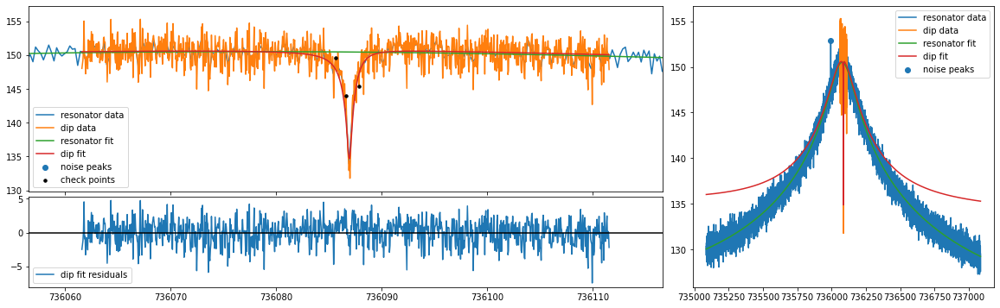

mean fit residuals = -8.4e-06 +/- 5.7e-02
original all {'A': 1117638533140857.6, 'dA': 16707016947201.871, 'Q': 4473.891447512609, 'dQ': 31.264117847680986, 'offset': 29303399350086.223, 'doffset': 5545181926828.621, 'slope': -0.000351538667975074, 'dslope': 1.7719619484888213e-05, 'nu_res': 736077.8540598992, 'dnu_res': 0.41349560132545643, 'nu_z': 736086.9461872856, 'dnu_z': 0.020183559211638433, 'dip_width': 2.2443863015870353, 'ddip_width': 0.11405700168278111, 'pcov': array([[ 4.073760624497e-04, -1.455320434730e-04, -2.355466705532e+08,
        -4.476864465828e+09],
       [-1.455320434730e-04,  1.300899963287e-02,  2.732072343632e+11,
         2.313896941472e+11],
       [-2.355466705532e+08,  2.732072343632e+11,  2.791244152741e+26,
        -2.810678885579e+25],
       [-4.476864465828e+09,  2.313896941472e+11, -2.810678885579e+25,
         3.074904260163e+25]]), 'perr': array([2.018355921164e-02, 1.140570016828e-01, 1.670701694720e+13,
       5.545181926829e+12]), 'popt': dict

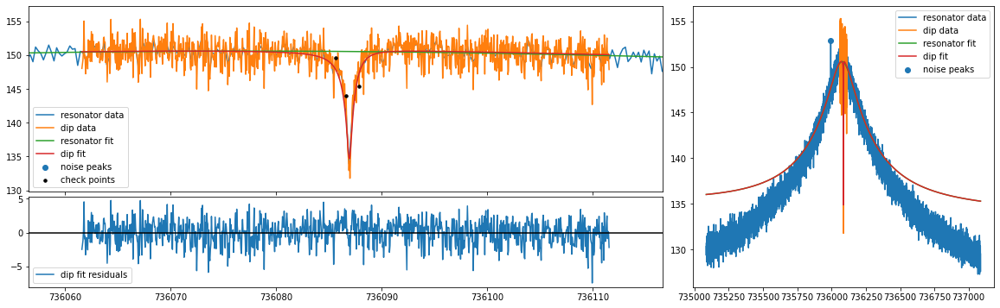

mean fit residuals = -8.5e-06 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2443862738625993 0.10158759381267388
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946042720927
dnu_z                    0.020145410148
dip_width                2.244386273863
ddip_width               0.101587593813
fit_err                  3.276121311935
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             29303399350086.22265625
doff           69874769564.714782714844
A                 

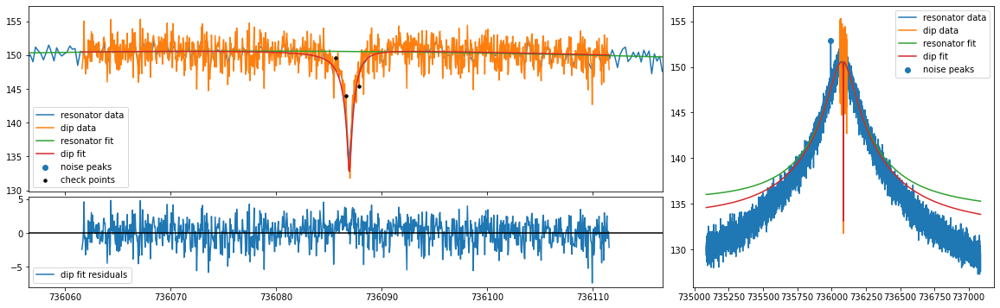

mean fit residuals = 5.9e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.244438567636584 0.09688784742303523
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946537455427
dnu_z                    0.017280622665
dip_width                2.244438567637
ddip_width               0.096887847423
fit_err                  3.292943204525
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             18939828130607.78515625
doff           69874769564.714782714844
A                  1

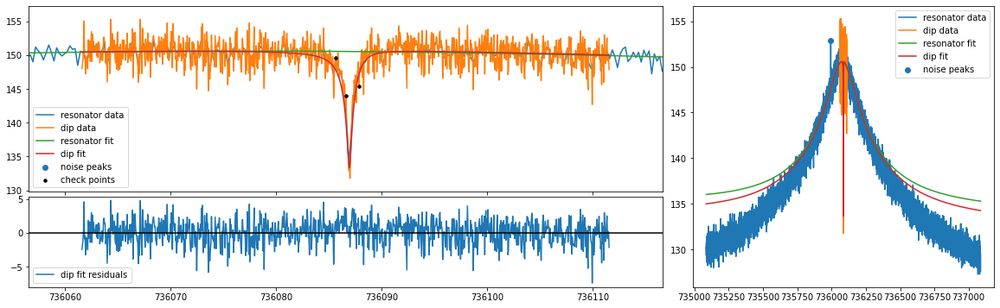

mean fit residuals = 4.4e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2444592540849304 0.0980867142491015
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946343543823
dnu_z                    0.018049920523
dip_width                2.244459254085
ddip_width               0.098086714249
fit_err                  3.284786152577
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             21530720935477.39453125
doff           69874769564.714782714844
A                  1

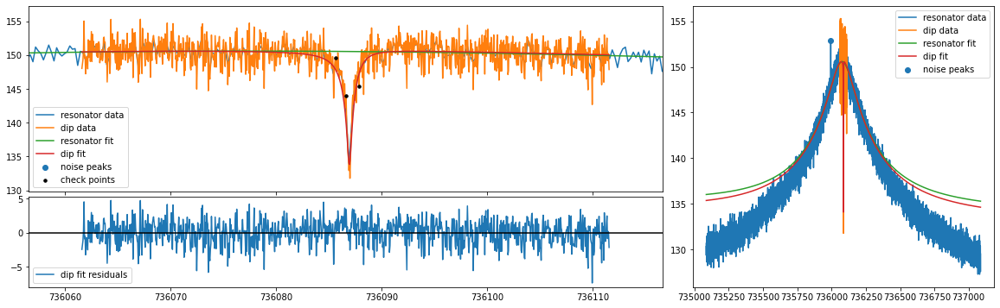

mean fit residuals = 2.9e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2444866249667412 0.0992690950371802
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946209789719
dnu_z                    0.018779254754
dip_width                2.244486624967
ddip_width               0.099269095037
fit_err                  3.279650968481
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             24121613740347.00390625
doff           69874769564.714782714844
A                  1

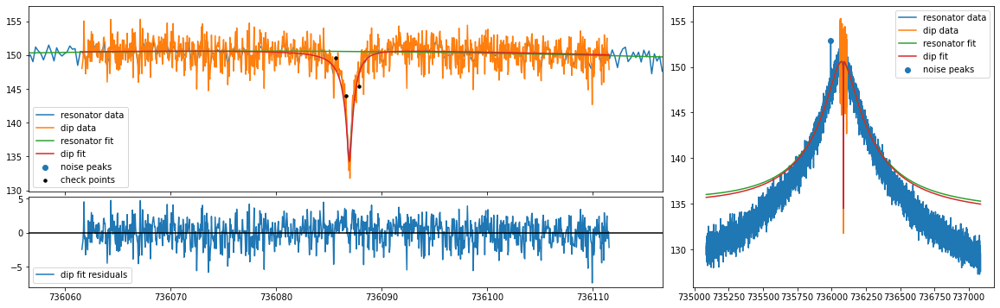

mean fit residuals = 1.4e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.244386235614174 0.10043338243165555
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946109873708
dnu_z                    0.019475489119
dip_width                2.244386235614
ddip_width               0.100433382432
fit_err                  3.276885540978
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             26712506545216.61328125
doff           69874769564.714782714844
A                  1

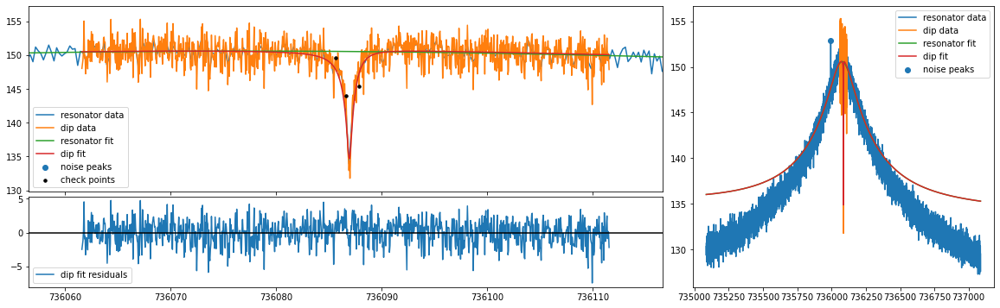

mean fit residuals = -8.5e-06 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2443862738625993 0.10158759381267388
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.946042720927
dnu_z                    0.020145410148
dip_width                2.244386273863
ddip_width               0.101587593813
fit_err                  3.276121311935
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             29303399350086.22265625
doff           69874769564.714782714844
A                 

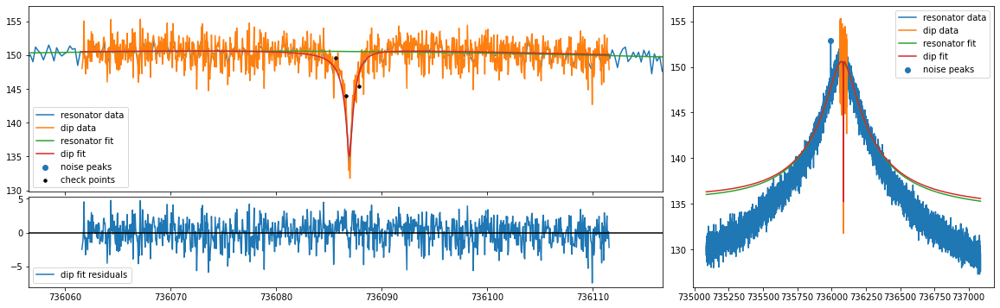

mean fit residuals = -1.4e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2443863451457595 0.10273059255500049
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.945996138616
dnu_z                    0.020792804554
dip_width                2.244386345146
ddip_width               0.102730592555
fit_err                   3.27700024001
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             31894292154955.83203125
doff           69874769564.714782714844
A                 

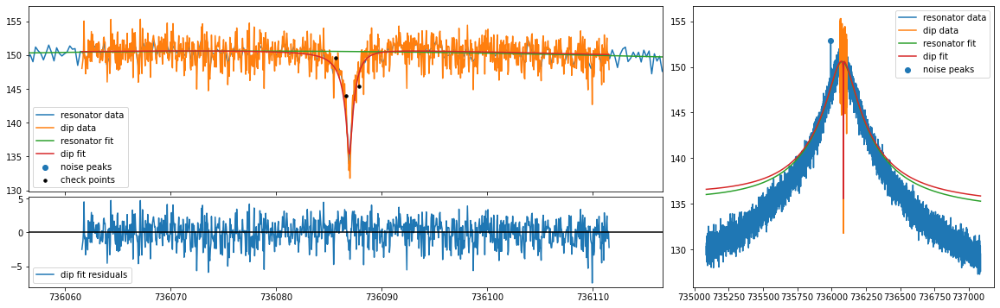

mean fit residuals = -2.8e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2443864761469694 0.1038637729256292
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.945963193779
dnu_z                    0.021421041695
dip_width                2.244386476147
ddip_width               0.103863772926
fit_err                  3.279274206994
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off             34485184959825.44140625
doff           69874769564.714782714844
A                  

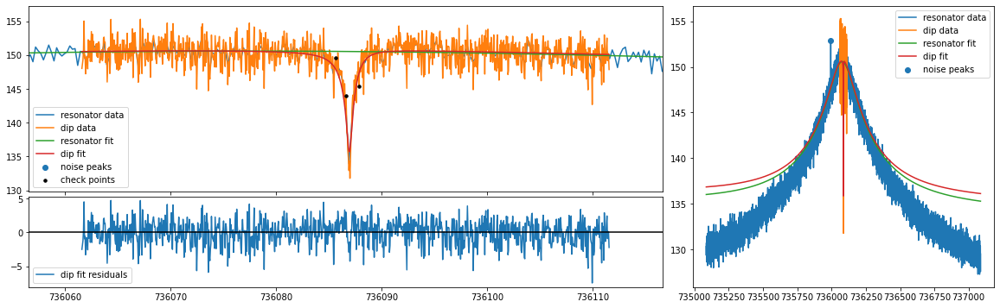

mean fit residuals = -4.2e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.2443867137185456 0.10498834301906584
mcycle                                1
cycle                                 5
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_185006.051260
nu_z                736086.945938072866
dnu_z                    0.022032816947
dip_width                2.244386713719
ddip_width               0.104988343019
fit_err                   3.28275024439
fit_success                        True
average_idx                           0
nu_res              736077.854059899226
dnu_res                  0.413495601325
Q                     4473.891447512609
dQ                      31.264117847681
th                      -0.000351538668
dth                      0.000017719619
off              37076077764695.0546875
doff           69874769564.714782714844
A                 

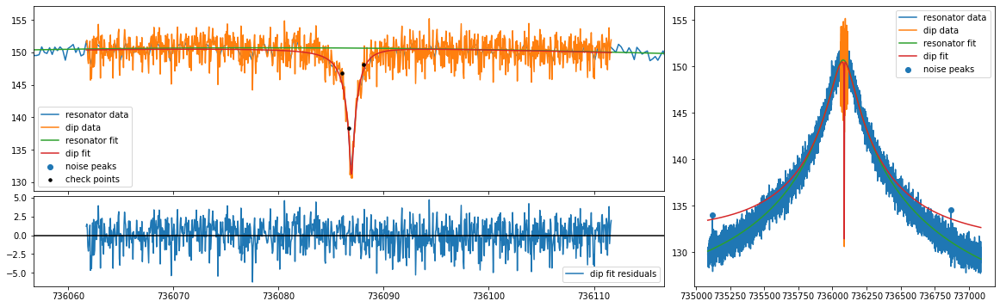

mean fit residuals = -1.2e-08 +/- 5.6e-02
original all {'A': 1100145404893253.4, 'dA': 15312344795849.207, 'Q': 4582.84236905417, 'dQ': 32.01997807061077, 'offset': 13219083635020.814, 'doffset': 2646455363218.7905, 'slope': -0.0003704302263331208, 'dslope': 1.7397073959293486e-05, 'nu_res': 736079.0719013264, 'dnu_res': 0.40130722946077774, 'nu_z': 736086.9391004103, 'dnu_z': 0.0163090352656345, 'dip_width': 2.667843818696316, 'ddip_width': 0.11030483877225157, 'pcov': array([[ 2.659846312957e-04, -8.878793051851e-05, -1.518899735364e+09,
        -1.541400197412e+09],
       [-8.878793051851e-05,  1.216715745657e-02,  4.294455252257e+11,
         9.037612445003e+10],
       [-1.518899735364e+09,  4.294455252257e+11,  2.344679031470e+26,
        -5.650184364395e+24],
       [-1.541400197412e+09,  9.037612445003e+10, -5.650184364395e+24,
         7.003725989510e+24]]), 'perr': array([1.630903526563e-02, 1.103048387723e-01, 1.531234479585e+13,
       2.646455363219e+12]), 'popt': dict_va

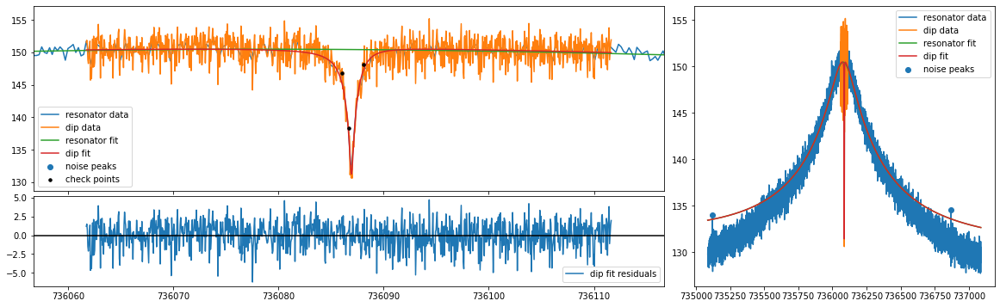

mean fit residuals = 8.8e-06 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6678905444563896 0.09941659408498664
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.939099566429
dnu_z                    0.016281449779
dip_width                2.667890544456
ddip_width               0.099416594085
fit_err                  3.105609568737
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off            13219083635020.814453125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   1335

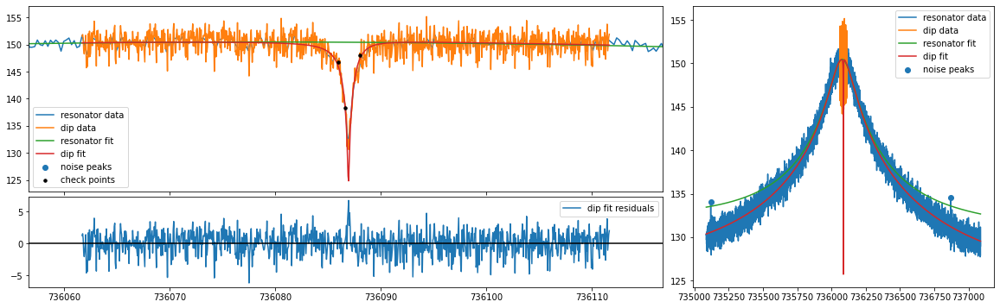

mean fit residuals = 3.6e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.436221068143862 0.08832133590931185
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.938735339441
dnu_z                    0.009921837877
dip_width                2.436221068144
ddip_width               0.088321335909
fit_err                  3.223821244069
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off             2855512415542.376953125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   13354

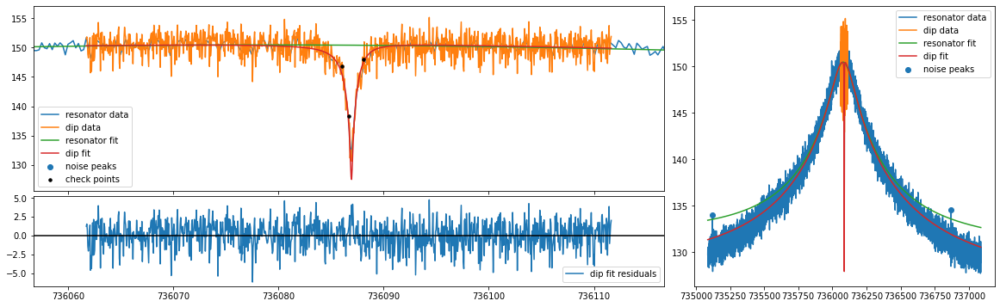

mean fit residuals = 2.9e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.518015017883766 0.0915101285117881
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.938018247485
dnu_z                     0.01204846334
dip_width                2.518015017884
ddip_width               0.091510128512
fit_err                   3.15239521304
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off            5446405220411.9853515625
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   133544

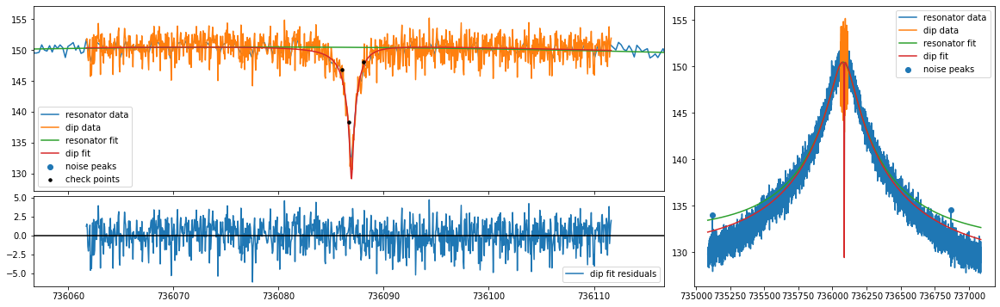

mean fit residuals = 2.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.5773756459373276 0.09433277506881989
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.938197170733
dnu_z                      0.0136713038
dip_width                2.577375645937
ddip_width               0.094332775069
fit_err                  3.121941474227
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off             8037298025281.595703125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   1335

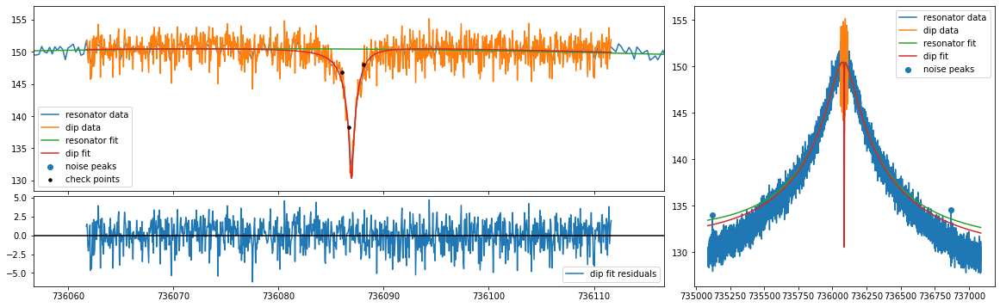

mean fit residuals = 1.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.625715925888884 0.09694162625077231
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.938603223651
dnu_z                    0.015049070479
dip_width                2.625715925889
ddip_width               0.096941626251
fit_err                  3.108993916732
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off            10628190830151.205078125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   13354

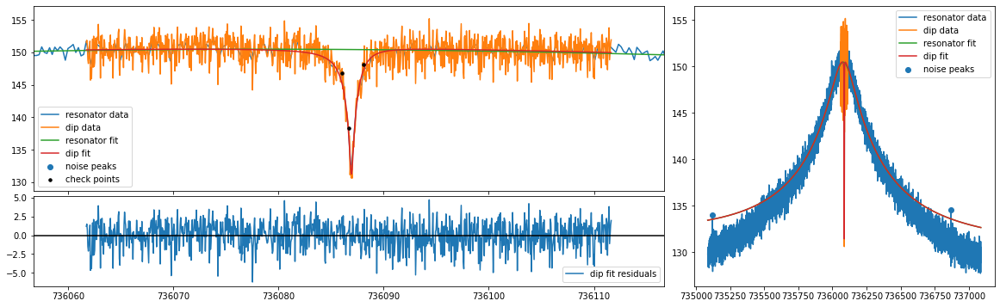

mean fit residuals = 8.8e-06 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6678905444563896 0.09941659408498664
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.939099566429
dnu_z                    0.016281449779
dip_width                2.667890544456
ddip_width               0.099416594085
fit_err                  3.105609568737
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off            13219083635020.814453125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   1335

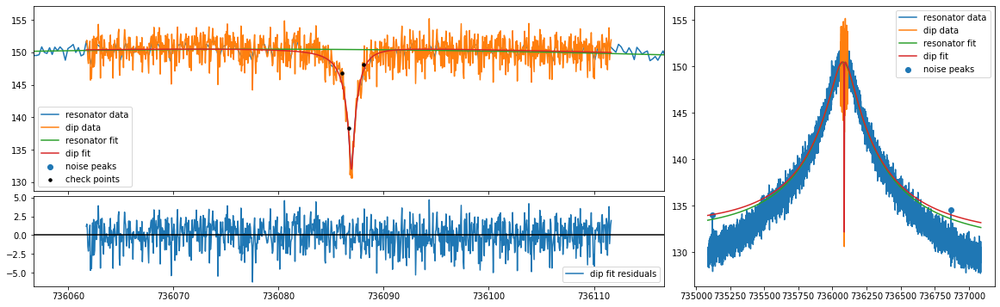

mean fit residuals = -1.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7072732967423456 0.10182055124074627
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.939690169645
dnu_z                    0.017420922815
dip_width                2.707273296742
ddip_width               0.101820551241
fit_err                  3.108157982064
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off            15809976439890.423828125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   133

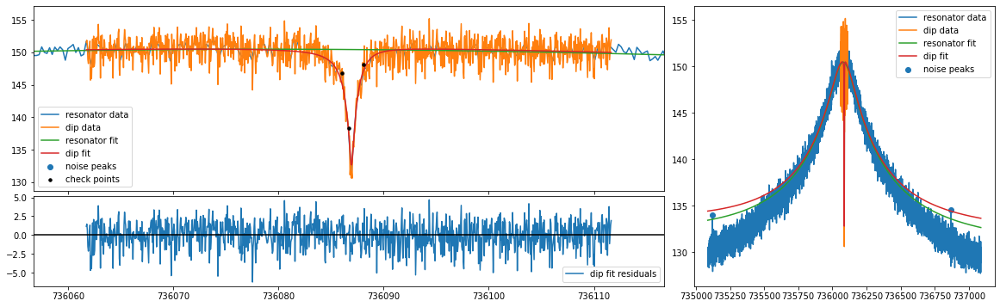

mean fit residuals = -2.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.741084747347273 0.1041020066335914
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                736086.940103589674
dnu_z                    0.018482424738
dip_width                2.741084747347
ddip_width               0.104102006634
fit_err                  3.114692392037
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off                18400869244760.03125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   13354

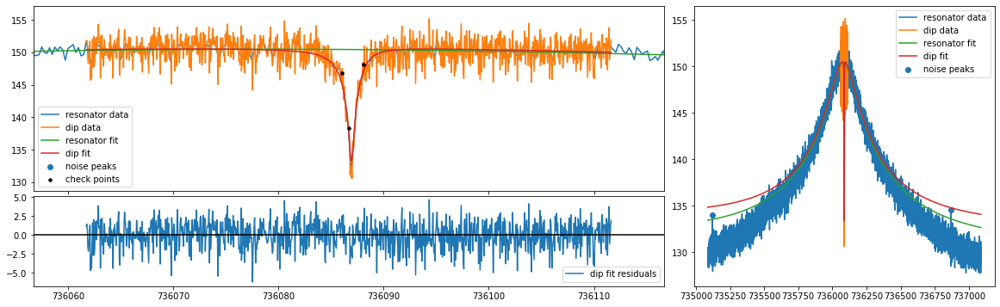

mean fit residuals = -3.2e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7740044905577093 0.10635214754304678
mcycle                                1
cycle                                 6
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_192059.356605
nu_z                 736086.94058205944
dnu_z                     0.01949601467
dip_width                2.774004490558
ddip_width               0.106352147543
fit_err                  3.124054410654
fit_success                        True
average_idx                           0
nu_res              736079.071901326417
dnu_res                  0.401307229461
Q                      4582.84236905417
dQ                      32.019978070611
th                      -0.000370430226
dth                      0.000017397074
off             20991762049629.64453125
doff           68973103856.468795776367
A                  1100145404893253.375
dA                   133

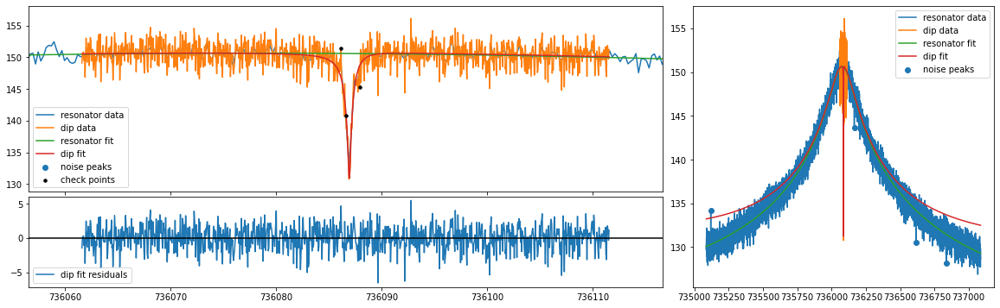

mean fit residuals = -5.5e-09 +/- 5.6e-02
original all {'A': 1148594197473334.5, 'dA': 15665464954536.344, 'Q': 4539.036548855747, 'dQ': 32.25788810843824, 'offset': 11831266211642.146, 'doffset': 3024489050800.7524, 'slope': -0.0003376689418252187, 'dslope': 1.784078933014551e-05, 'nu_res': 736078.1902037741, 'dnu_res': 0.4132582412151226, 'nu_z': 736086.9362492872, 'dnu_z': 0.012529150220868965, 'dip_width': 1.7456337243728508, 'ddip_width': 0.08587528528809558, 'pcov': array([[ 1.569796052571e-04, -6.273773798937e-05, -1.926182842151e+08,
        -1.919350487971e+09],
       [-6.273773798937e-05,  7.374564623312e-03,  2.558394143848e+11,
         7.821649625518e+10],
       [-1.926182842151e+08,  2.558394143848e+11,  2.454067922418e+26,
        -8.052511384871e+24],
       [-1.919350487971e+09,  7.821649625518e+10, -8.052511384871e+24,
         9.147534018414e+24]]), 'perr': array([1.252915022087e-02, 8.587528528810e-02, 1.566546495454e+13,
       3.024489050801e+12]), 'popt': dict_

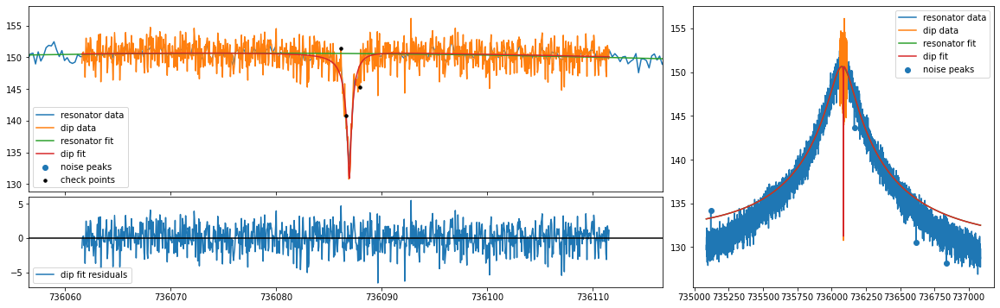

mean fit residuals = 8.2e-04 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7499153329657746 0.07916028461455493
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.936202125857
dnu_z                     0.01251523436
dip_width                1.749915332966
ddip_width               0.079160284615
fit_err                  3.090663094203
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off            11831266211642.146484375
doff           70782853538.239669799805
A                  

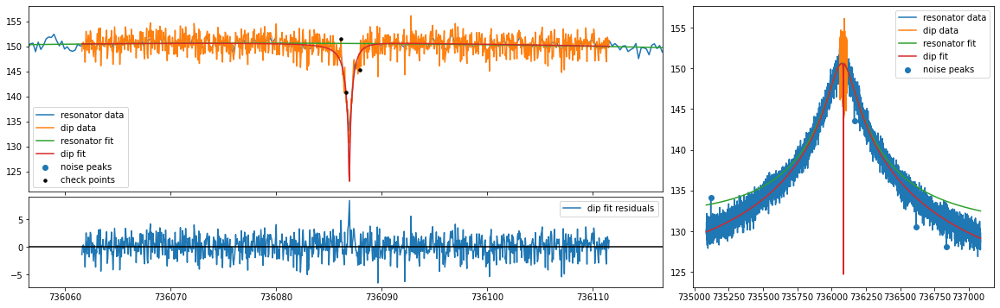

mean fit residuals = 7.1e-02 +/- 5.7e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7457142506553645 0.07298926612956373
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.935706775286
dnu_z                    0.006858762135
dip_width                1.745714250655
ddip_width                0.07298926613
fit_err                  3.226534744625
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off             1467694992163.708984375
doff           70782853538.239669799805
A                  

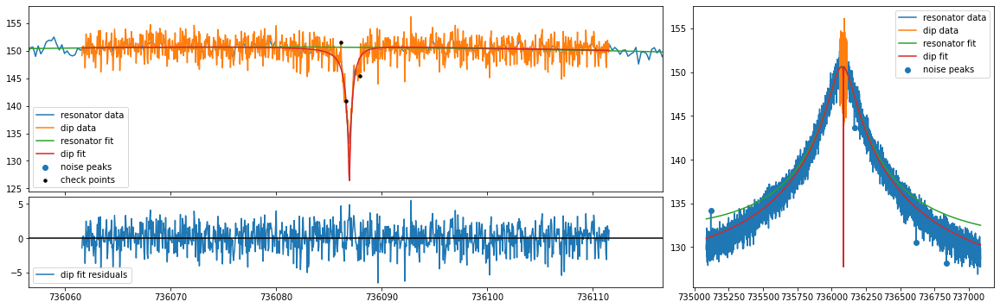

mean fit residuals = 5.0e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7456422812118053 0.0746358879778601
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.939718889305
dnu_z                    0.009099867349
dip_width                1.745642281212
ddip_width               0.074635887978
fit_err                  3.138008405485
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off            4058587797033.3173828125
doff           70782853538.239669799805
A                   

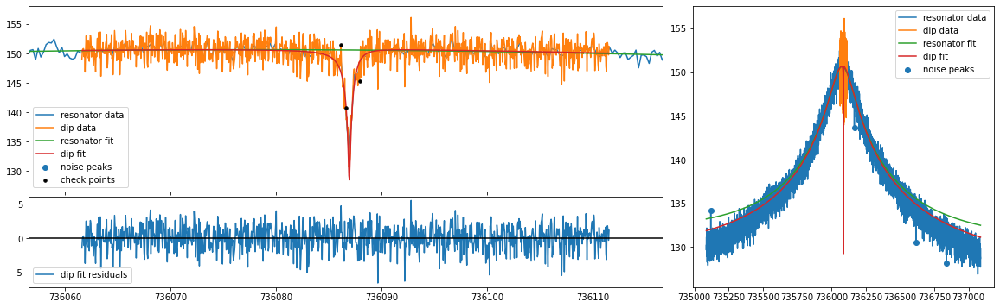

mean fit residuals = 3.2e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.745834849995332 0.07620068133237616
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.938415967976
dnu_z                    0.010458564817
dip_width                1.745834849995
ddip_width               0.076200681332
fit_err                  3.106306656979
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off             6649480601902.927734375
doff           70782853538.239669799805
A                   

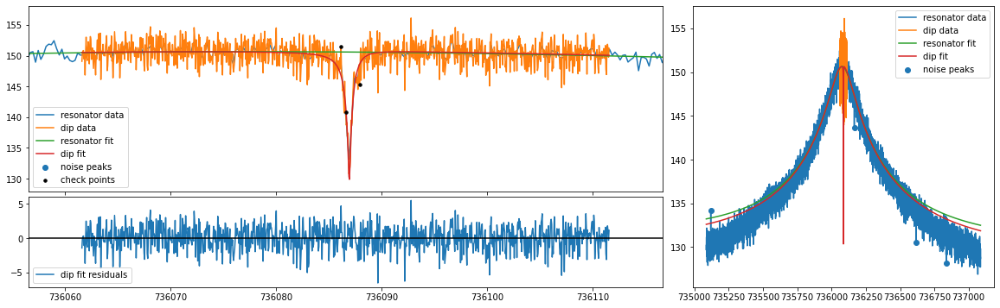

mean fit residuals = 1.5e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7457488820843658 0.07766717601345619
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.937235032092
dnu_z                    0.011555220215
dip_width                1.745748882084
ddip_width               0.077667176013
fit_err                  3.093795970846
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off             9240373406772.537109375
doff           70782853538.239669799805
A                  

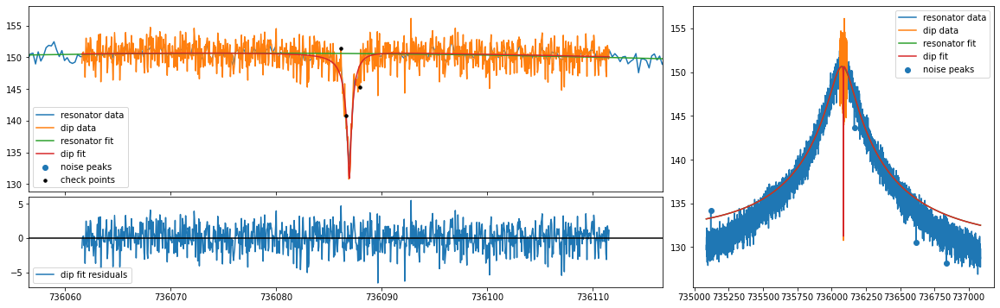

mean fit residuals = 8.2e-04 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7499153329657746 0.07916028461455493
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.936202125857
dnu_z                     0.01251523436
dip_width                1.749915332966
ddip_width               0.079160284615
fit_err                  3.090663094203
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off            11831266211642.146484375
doff           70782853538.239669799805
A                  

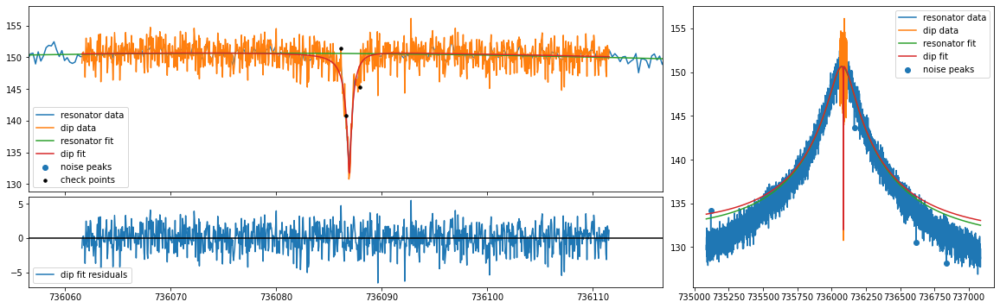

mean fit residuals = -1.1e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.76828051585064 0.08092568384166382
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.935199204716
dnu_z                    0.013431345206
dip_width                1.768280515851
ddip_width               0.080925683842
fit_err                  3.092704364471
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off            14422159016511.755859375
doff           70782853538.239669799805
A                   

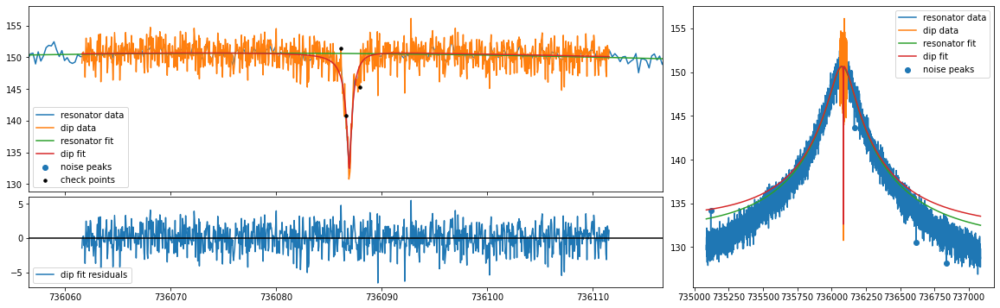

mean fit residuals = -2.1e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7907185083503576 0.08274714264861918
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.934258060646
dnu_z                     0.01430030406
dip_width                 1.79071850835
ddip_width               0.082747142649
fit_err                  3.097832877233
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off            17013051821381.365234375
doff           70782853538.239669799805
A                 

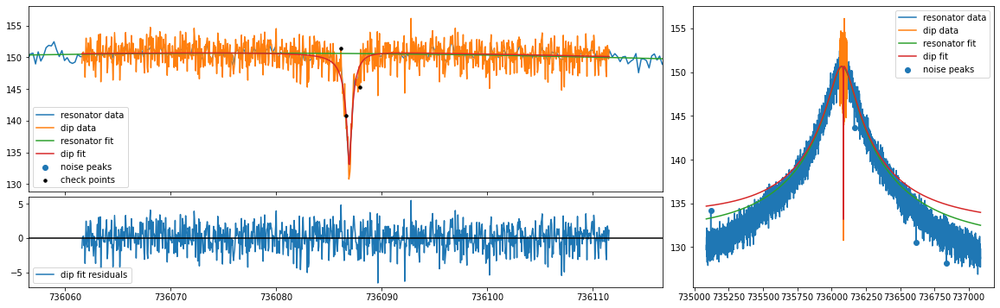

mean fit residuals = -3.1e-02 +/- 5.6e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8109585352255184 0.08448832346486244
mcycle                                1
cycle                                 6
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_191041.739612
nu_z                736086.933426452219
dnu_z                    0.015115283284
dip_width                1.810958535226
ddip_width               0.084488323465
fit_err                  3.105072077313
fit_success                        True
average_idx                           0
nu_res              736078.190203774138
dnu_res                  0.413258241215
Q                     4539.036548855747
dQ                      32.257888108438
th                      -0.000337668942
dth                      0.000017840789
off              19603944626250.9765625
doff           70782853538.239669799805
A                 

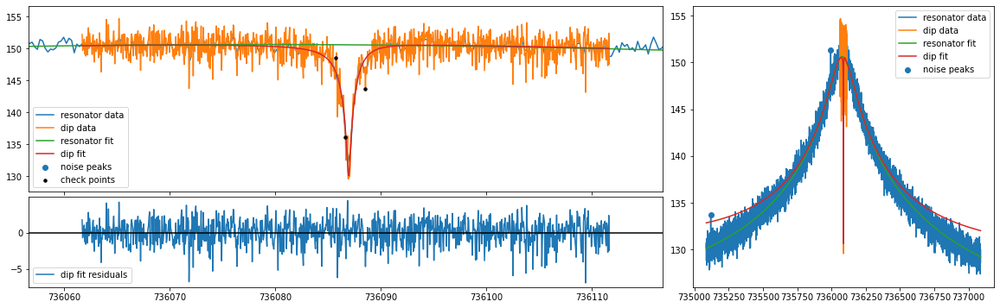

mean fit residuals = 7.5e-09 +/- 5.5e-02
original all {'A': 1116600931464201.2, 'dA': 15230294579963.375, 'Q': 4523.524429996965, 'dQ': 31.373211024655816, 'offset': 10254502249919.605, 'doffset': 2041950011942.7588, 'slope': -0.000387946298893403, 'dslope': 1.7437890626100602e-05, 'nu_res': 736078.5232216372, 'dnu_res': 0.4048373480156866, 'nu_z': 736086.9560609821, 'dnu_z': 0.015375906140658325, 'dip_width': 2.9325952809046334, 'ddip_width': 0.11121493014071177, 'pcov': array([[ 2.364184896463e-04, -8.295044546867e-05, -1.918680406927e+09,
        -1.106321140448e+09],
       [-8.295044546867e-05,  1.236876068620e-02,  4.882469003756e+11,
         6.623371808070e+10],
       [-1.918680406927e+09,  4.882469003756e+11,  2.319618729925e+26,
        -3.078490434448e+24],
       [-1.106321140448e+09,  6.623371808070e+10, -3.078490434448e+24,
         4.169559851273e+24]]), 'perr': array([1.537590614066e-02, 1.112149301407e-01, 1.523029457996e+13,
       2.041950011943e+12]), 'popt': dict_

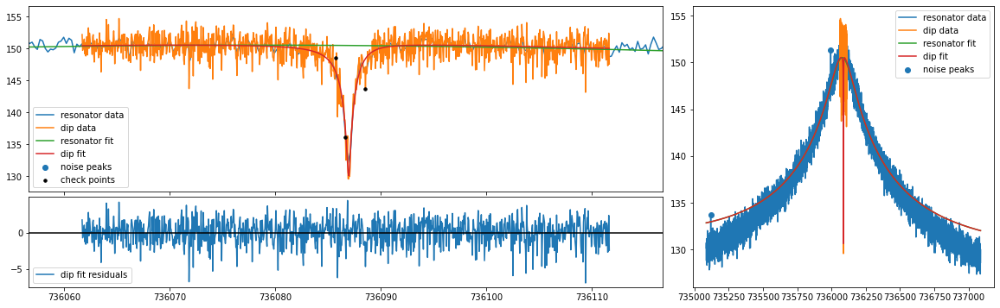

mean fit residuals = 1.2e-04 +/- 5.5e-02
[0.5, 3.0] 3.0 2.933234191381091 0.10021255635705367
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.956025788793
dnu_z                    0.015351592541
dip_width                2.933234191381
ddip_width               0.100212556357
fit_err                  2.992849075566
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off             10254502249919.60546875
doff           69334094688.064697265625
A                   1116600931464201.25
dA                13015485

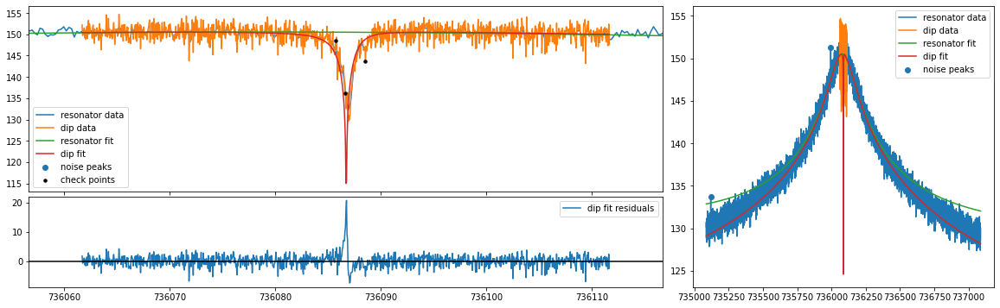

mean fit residuals = 1.1e-01 +/- 6.7e-02
[0.5, 3.0] 3.0 2.9215343870840877 0.10598432657930325
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.729309742339
dnu_z                    0.003628068865
dip_width                2.921534387084
ddip_width               0.105984326579
fit_err                  4.504984479742
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off                10254502.24991960451
doff           69334094688.064697265625
A                   1116600931464201.25
dA                1301548

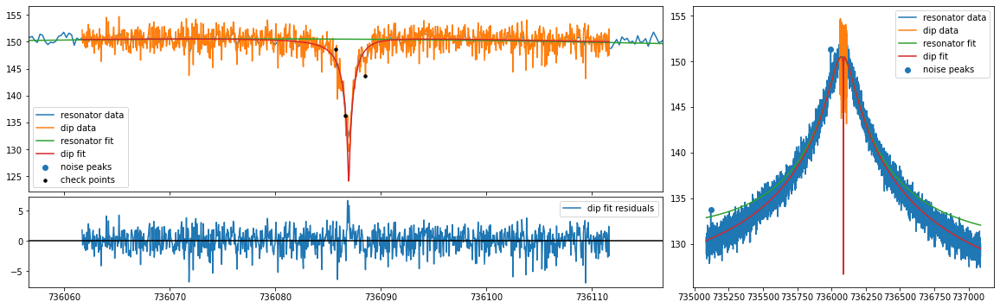

mean fit residuals = 5.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.8430870153850303 0.09308348821993703
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.966756601119
dnu_z                    0.010027698178
dip_width                2.843087015385
ddip_width                0.09308348822
fit_err                  3.099647811886
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off            2481823835310.7763671875
doff           69334094688.064697265625
A                   1116600931464201.25
dA                1301548

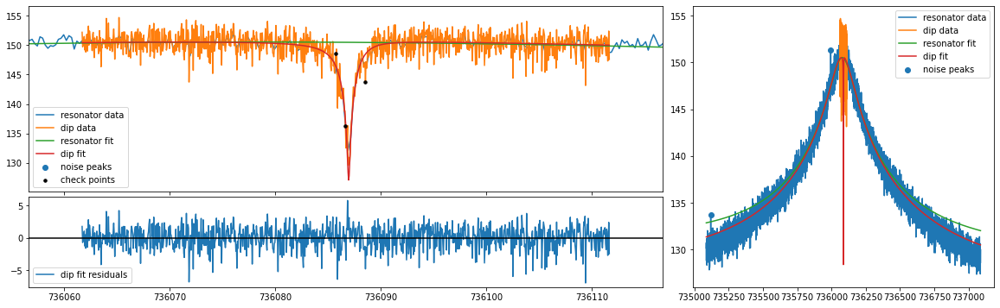

mean fit residuals = 2.5e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8444322410684144 0.09487620416470534
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.962533901213
dnu_z                    0.012217703264
dip_width                2.844432241068
ddip_width               0.094876204165
fit_err                  3.023354334542
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off              5072716640180.38671875
doff           69334094688.064697265625
A                   1116600931464201.25
dA                1301548

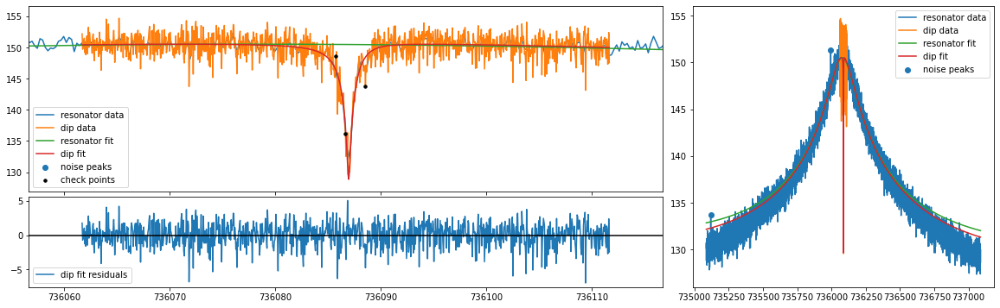

mean fit residuals = 1.0e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.881125333389102 0.09741122920524176
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.959079636377
dnu_z                    0.013890461168
dip_width                2.881125333389
ddip_width               0.097411229205
fit_err                  2.998626316235
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off              7663609445049.99609375
doff           69334094688.064697265625
A                   1116600931464201.25
dA                13015485

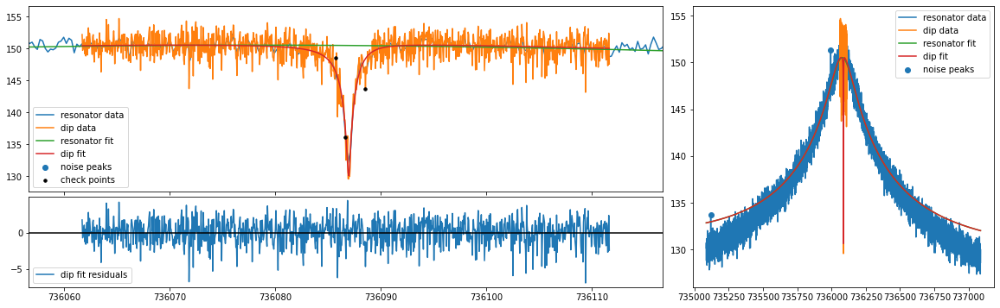

mean fit residuals = 1.2e-04 +/- 5.5e-02
[0.5, 3.0] 3.0 2.933234191381091 0.10021255635705367
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.956025788793
dnu_z                    0.015351592541
dip_width                2.933234191381
ddip_width               0.100212556357
fit_err                  2.992849075566
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off             10254502249919.60546875
doff           69334094688.064697265625
A                   1116600931464201.25
dA                13015485

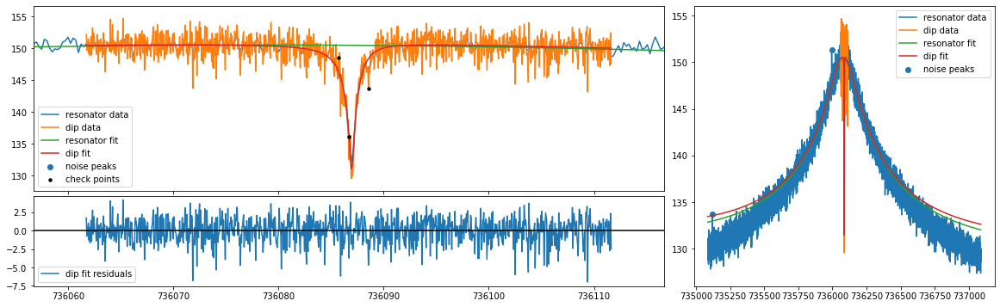

mean fit residuals = -1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.977755471352335 0.10286843051946488
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.953503679601
dnu_z                    0.016653703689
dip_width                2.977755471352
ddip_width               0.102868430519
fit_err                  2.996849453284
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off             12845395054789.21484375
doff           69334094688.064697265625
A                   1116600931464201.25
dA                1301548

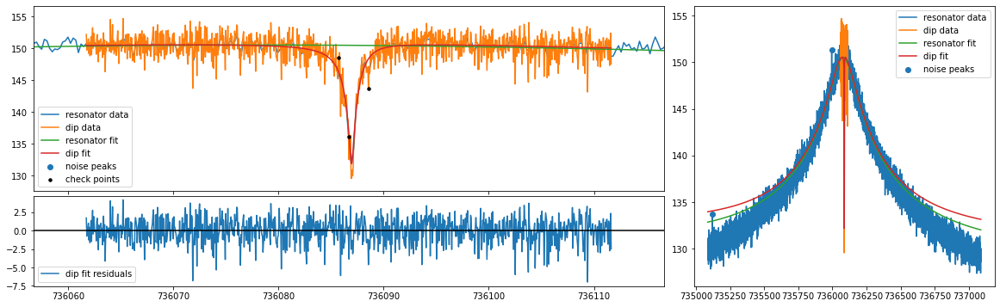

mean fit residuals = -2.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0181025859736637 0.10543387113069122
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.951347403228
dnu_z                    0.017853323863
dip_width                3.018102585974
ddip_width               0.105433871131
fit_err                  3.006713899819
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off             15436287859658.82421875
doff           69334094688.064697265625
A                   1116600931464201.25
dA                130154

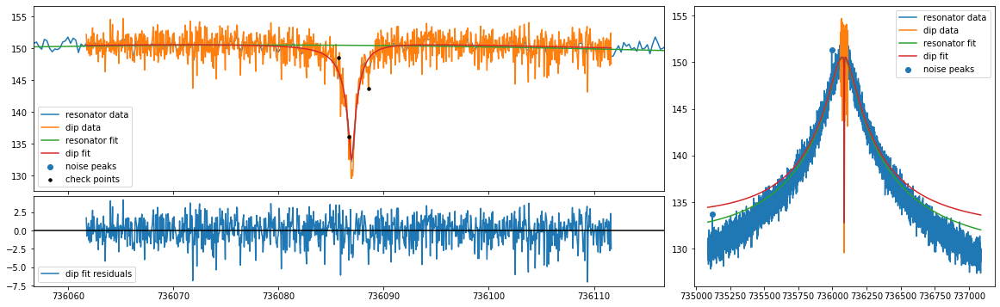

mean fit residuals = -3.2e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 3.0552414413304607 0.10792593268586885
mcycle                                1
cycle                                 7
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_194136.023054
nu_z                736086.949491494335
dnu_z                    0.018979657935
dip_width                 3.05524144133
ddip_width               0.107925932686
fit_err                  3.020395524683
fit_success                        True
average_idx                           0
nu_res              736078.523221637239
dnu_res                  0.404837348016
Q                     4523.524429996965
dQ                      31.373211024656
th                      -0.000387946299
dth                      0.000017437891
off             18027180664528.43359375
doff           69334094688.064697265625
A                   1116600931464201.25
dA                130154

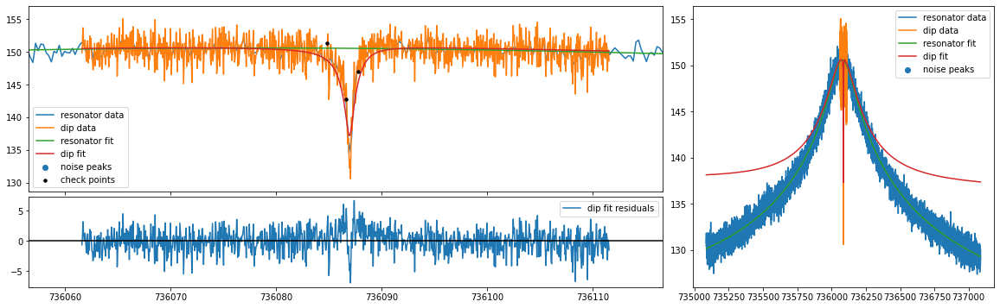

mean fit residuals = -1.6e-05 +/- 6.0e-02
original all {'A': 1100344040377660.1, 'dA': 18519940437096.19, 'Q': 4524.156094104794, 'dQ': 31.586081357093814, 'offset': 52248188018258.88, 'doffset': 7986624789486.163, 'slope': -0.00037877082498146433, 'dslope': 1.7535477387854752e-05, 'nu_res': 736078.5593916188, 'dnu_res': 0.40724040376466714, 'nu_z': 736086.9589858943, 'dnu_z': 0.030360431687267906, 'dip_width': 2.9426397646968128, 'ddip_width': 0.15409952259610032, 'pcov': array([[ 9.217558122373e-04, -3.013298535669e-04, -3.208845847577e+08,
        -8.768696471407e+09],
       [-3.013298535669e-04,  2.374666286435e-02,  3.090050527520e+11,
         5.043533099164e+11],
       [-3.208845847577e+08,  3.090050527520e+11,  3.429881937936e+26,
        -5.851818483184e+25],
       [-8.768696471407e+09,  5.043533099164e+11, -5.851818483184e+25,
         6.378617552803e+25]]), 'perr': array([3.036043168727e-02, 1.540995225961e-01, 1.851994043710e+13,
       7.986624789486e+12]), 'popt': dict

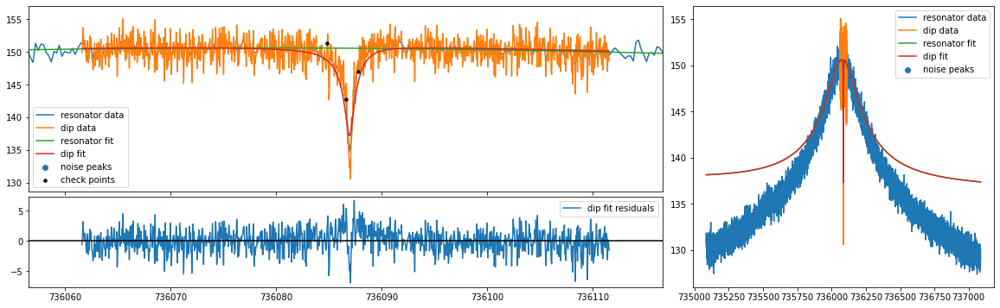

mean fit residuals = -1.7e-05 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.942640678064477 0.13290974384553186
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.957843619282
dnu_z                    0.030306349914
dip_width                2.942640678064
ddip_width               0.132909743846
fit_err                  3.570101830593
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              52248188018258.8828125
doff           69655740537.881912231445
A                  

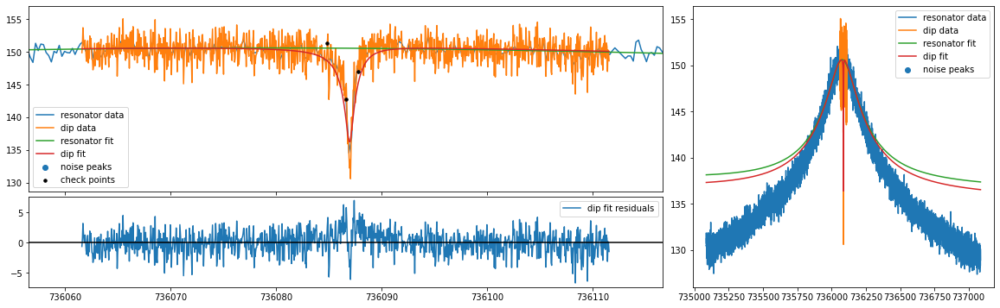

mean fit residuals = 5.6e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.942640082639668 0.12831583621575715
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.960008378839
dnu_z                     0.02776594874
dip_width                 2.94264008264
ddip_width               0.128315836216
fit_err                   3.57742739385
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              41884616798780.4453125
doff           69655740537.881912231445
A                  1

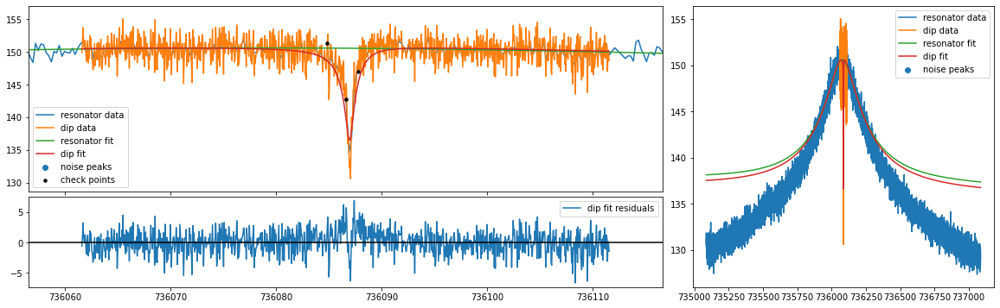

mean fit residuals = 4.2e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.942640187282496 0.12946794284190719
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.959433362819
dnu_z                    0.028417889788
dip_width                2.942640187282
ddip_width               0.129467942842
fit_err                  3.573924409438
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              44475509603650.0546875
doff           69655740537.881912231445
A                  1

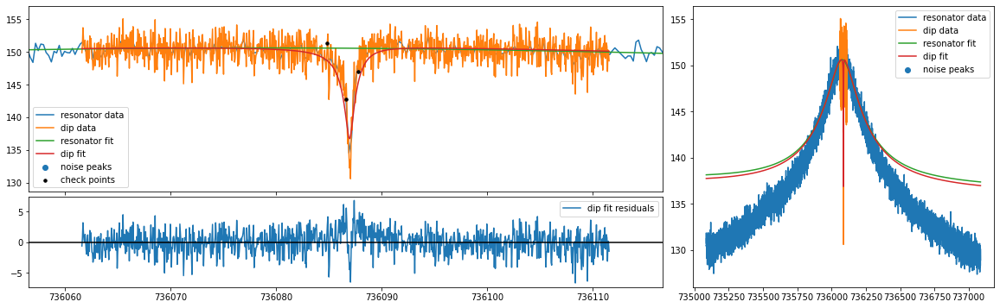

mean fit residuals = 2.8e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.9426403171305444 0.1306172335815216
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.958882065141
dnu_z                    0.029057708368
dip_width                2.942640317131
ddip_width               0.130617233582
fit_err                  3.571605175589
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              47066402408519.6640625
doff           69655740537.881912231445
A                  1

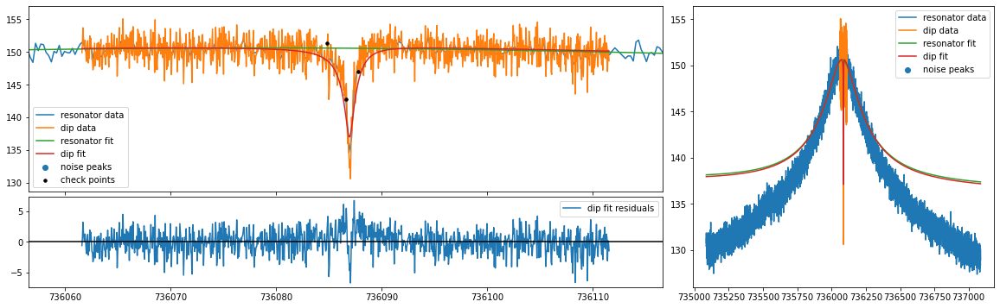

mean fit residuals = 1.4e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.9426404782243782 0.13176431687049275
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.958352653426
dnu_z                    0.029686795907
dip_width                2.942640478224
ddip_width                0.13176431687
fit_err                  3.570361633393
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              49657295213389.2734375
doff           69655740537.881912231445
A                  

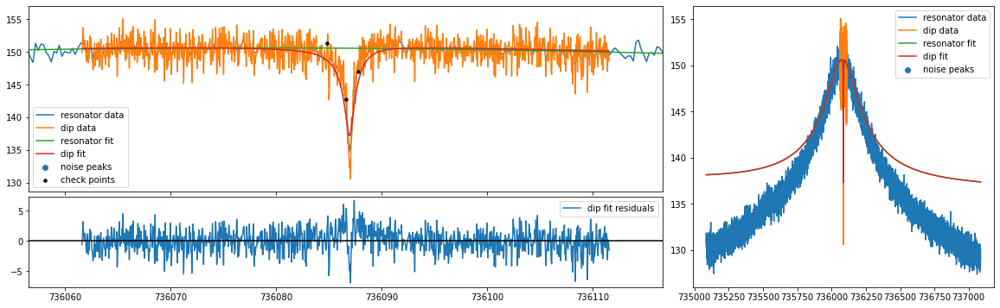

mean fit residuals = -1.7e-05 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.942640678064477 0.13290974384553186
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.957843619282
dnu_z                    0.030306349914
dip_width                2.942640678064
ddip_width               0.132909743846
fit_err                  3.570101830593
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              52248188018258.8828125
doff           69655740537.881912231445
A                  

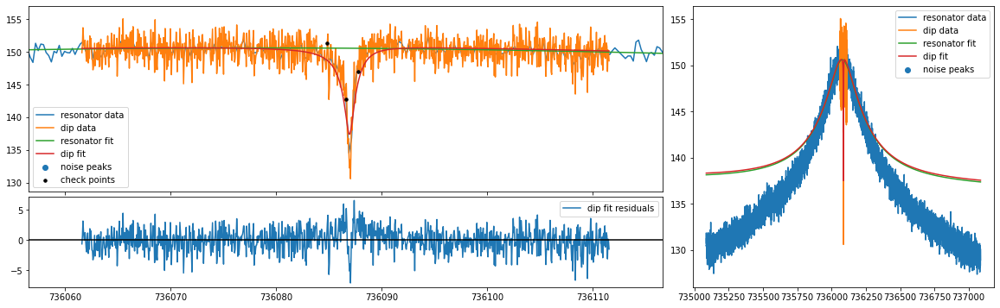

mean fit residuals = -1.4e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.9426409259871957 0.13405399057098036
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.957353689591
dnu_z                    0.030917409106
dip_width                2.942640925987
ddip_width               0.134053990571
fit_err                   3.57074683813
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              54839080823128.4921875
doff           69655740537.881912231445
A                 

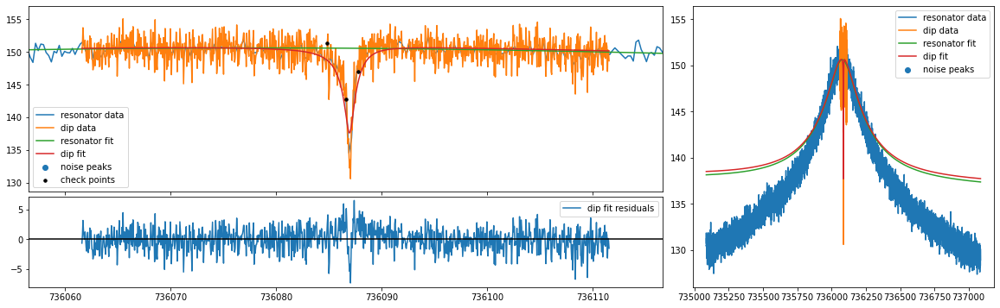

mean fit residuals = -2.7e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.9426412335956624 0.13519752311756142
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.956881793682
dnu_z                    0.031520880334
dip_width                2.942641233596
ddip_width               0.135197523118
fit_err                  3.572228370838
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              57429973627998.1015625
doff           69655740537.881912231445
A                 

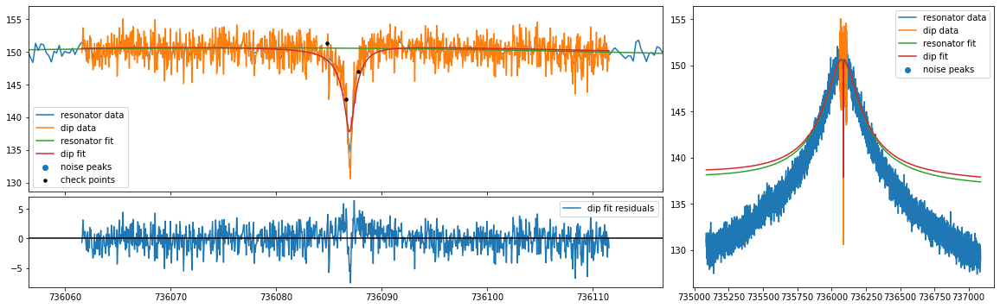

mean fit residuals = -4.1e-02 +/- 6.0e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.942641615306857 0.13634075186131522
mcycle                                1
cycle                                 7
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_193117.504859
nu_z                736086.956427036668
dnu_z                     0.03211756144
dip_width                2.942641615307
ddip_width               0.136340751861
fit_err                  3.574486928518
fit_success                        True
average_idx                           0
nu_res              736078.559391618823
dnu_res                  0.407240403765
Q                     4524.156094104794
dQ                      31.586081357094
th                      -0.000378770825
dth                      0.000017535477
off              60020866432867.7109375
doff           69655740537.881912231445
A                  

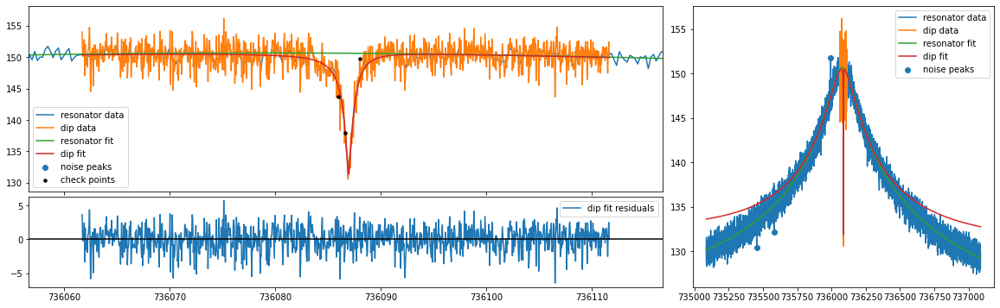

mean fit residuals = 8.0e-09 +/- 5.7e-02
original all {'A': 1094278785813064.9, 'dA': 15743663576119.8, 'Q': 4561.52353143796, 'dQ': 31.982921093802698, 'offset': 13733874088497.264, 'doffset': 2728870539442.806, 'slope': -0.00040829602849517605, 'dslope': 1.752075335635507e-05, 'nu_res': 736078.9947957753, 'dnu_res': 0.4051437828931493, 'nu_z': 736086.9582050602, 'dnu_z': 0.01750060094296864, 'dip_width': 2.8160289070338766, 'ddip_width': 0.11763461545802592, 'pcov': array([[ 3.062710333650e-04, -1.015595305477e-04, -1.873981379052e+09,
        -1.642098300124e+09],
       [-1.015595305477e-04,  1.383790275396e-02,  4.856291924437e+11,
         1.002744341633e+11],
       [-1.873981379052e+09,  4.856291924437e+11,  2.478629427980e+26,
        -5.937100799909e+24],
       [-1.642098300124e+09,  1.002744341633e+11, -5.937100799909e+24,
         7.446734421039e+24]]), 'perr': array([1.750060094297e-02, 1.176346154580e-01, 1.574366357612e+13,
       2.728870539443e+12]), 'popt': dict_valu

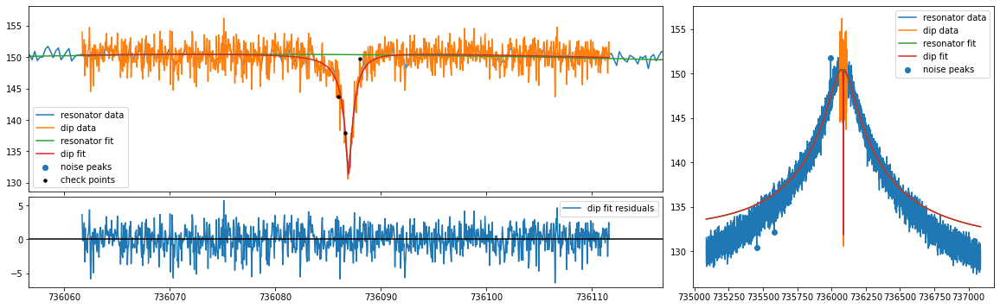

mean fit residuals = 1.5e-06 +/- 5.7e-02
[0.5, 3.0] 3.0 2.81603690452605 0.10559204029988307
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.958206575946
dnu_z                    0.017471587991
dip_width                2.816036904526
ddip_width                 0.1055920403
fit_err                  3.291998430138
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off            13733874088497.263671875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             133159390670

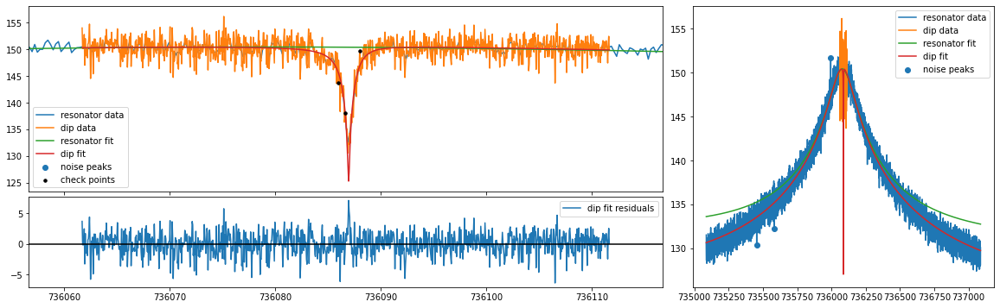

mean fit residuals = 4.0e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.598851768731004 0.09451997878261441
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                 736086.95516779332
dnu_z                    0.011069106018
dip_width                2.598851768731
ddip_width               0.094519978783
fit_err                  3.411102590845
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off             3370302869018.826171875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             13315939067

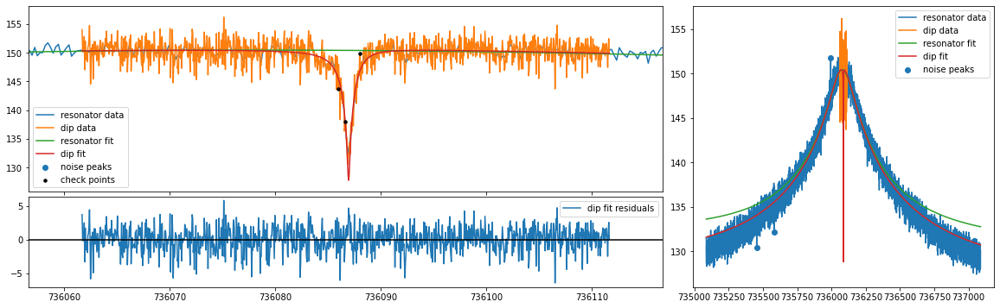

mean fit residuals = 3.2e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.6745518632533334 0.09764005910911669
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.956087764353
dnu_z                    0.013157909163
dip_width                2.674551863253
ddip_width               0.097640059109
fit_err                  3.340850398619
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off            5961195673888.4345703125
doff           69428048480.436981201172
A                  1094278785813064.875
dA             1331593906

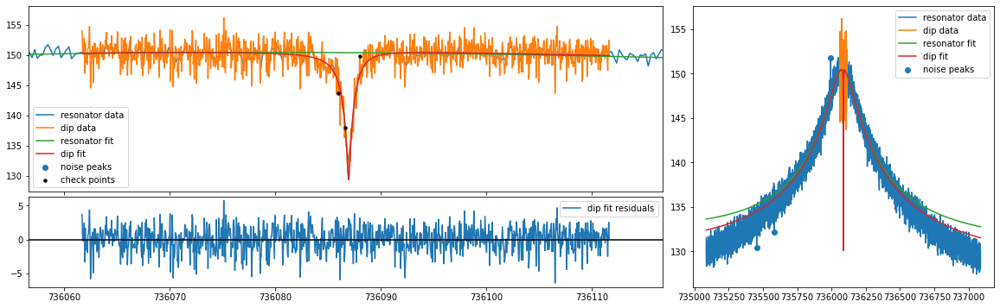

mean fit residuals = 2.2e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.730285195300201 0.10045085908100651
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                 736086.95696821739
dnu_z                    0.014796312968
dip_width                  2.7302851953
ddip_width               0.100450859081
fit_err                  3.309335732661
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off             8552088478758.044921875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             13315939067

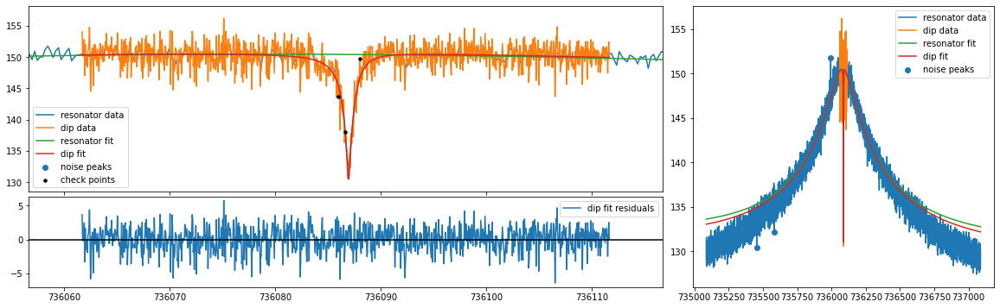

mean fit residuals = 1.1e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.776132757470461 0.10308181272335616
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                  736086.9576643334
dnu_z                    0.016204457092
dip_width                 2.77613275747
ddip_width               0.103081812723
fit_err                  3.295626412793
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off            11142981283627.654296875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             13315939067

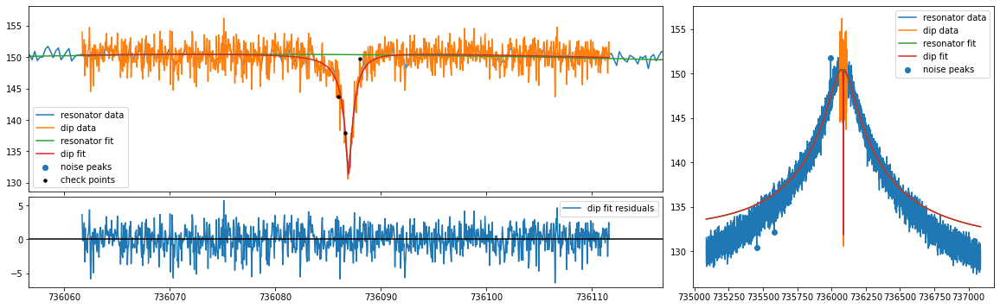

mean fit residuals = 1.5e-06 +/- 5.7e-02
[0.5, 3.0] 3.0 2.81603690452605 0.10559204029988307
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.958206575946
dnu_z                    0.017471587991
dip_width                2.816036904526
ddip_width                 0.1055920403
fit_err                  3.291998430138
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off            13733874088497.263671875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             133159390670

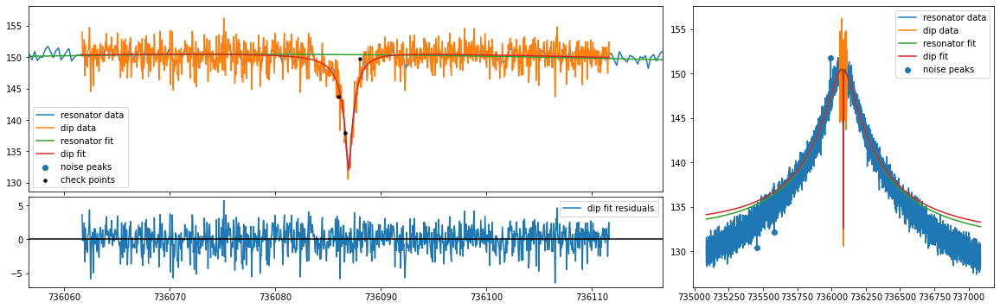

mean fit residuals = -1.1e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.851854485395755 0.1080126328919342
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.958644637954
dnu_z                    0.018642756287
dip_width                2.851854485396
ddip_width               0.108012632892
fit_err                  3.294758783033
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off            16324766893366.873046875
doff           69428048480.436981201172
A                  1094278785813064.875
dA             13315939067

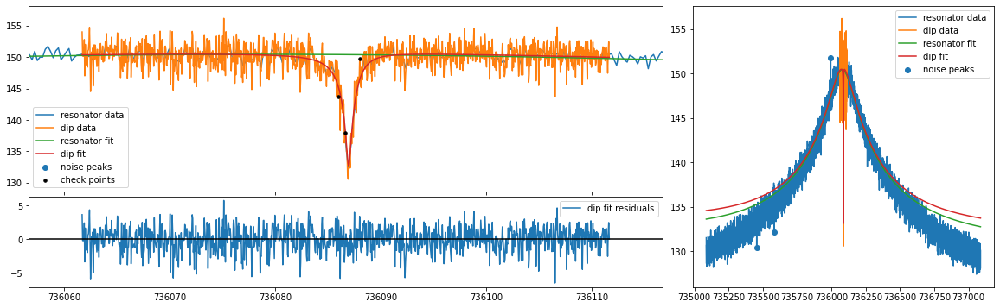

mean fit residuals = -2.2e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.884960241530885 0.11036929911703634
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.958949072403
dnu_z                     0.01974525002
dip_width                2.884960241531
ddip_width               0.110369299117
fit_err                  3.301869257493
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off               18915659698236.484375
doff           69428048480.436981201172
A                  1094278785813064.875
dA             1331593906

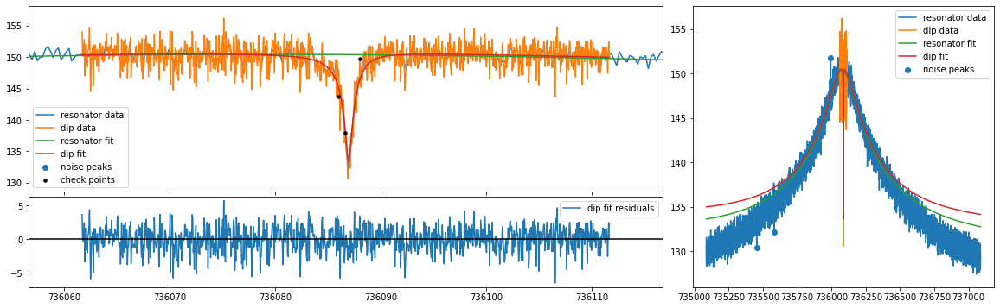

mean fit residuals = -3.3e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.9180394782771937 0.11271511249966944
mcycle                                1
cycle                                 8
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_200212.010896
nu_z                736086.959628044511
dnu_z                     0.02080306928
dip_width                2.918039478277
ddip_width                 0.1127151125
fit_err                  3.312092292481
fit_success                        True
average_idx                           0
nu_res              736078.994795775274
dnu_res                  0.405143782893
Q                      4561.52353143796
dQ                      31.982921093803
th                      -0.000408296028
dth                      0.000017520753
off                21506552503106.09375
doff           69428048480.436981201172
A                  1094278785813064.875
dA             133159390

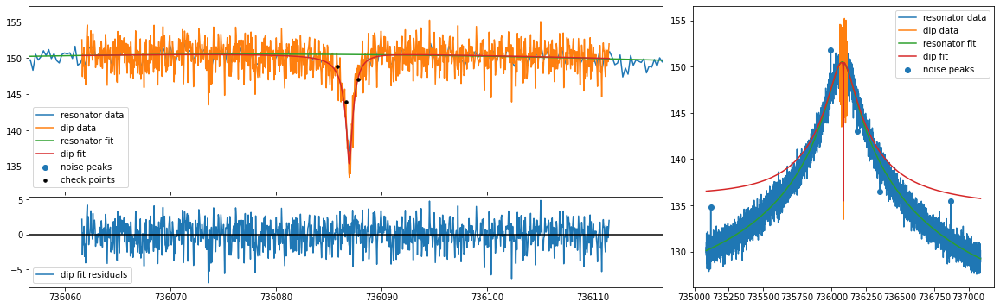

mean fit residuals = 8.5e-09 +/- 5.8e-02
original all {'A': 1077063961196913.4, 'dA': 16709537455242.098, 'Q': 4484.236083516284, 'dQ': 31.210952693847325, 'offset': 33916445345679.953, 'doffset': 6625775247985.862, 'slope': -0.00039147127743842483, 'dslope': 1.760609975319173e-05, 'nu_res': 736078.9646912824, 'dnu_res': 0.4106552585885039, 'nu_z': 736086.9394959791, 'dnu_z': 0.020615914534885208, 'dip_width': 1.9950099503621461, 'ddip_width': 0.111455456750669, 'pcov': array([[ 4.250159321097e-04, -1.388249171062e-04,  1.454882113254e+09,
        -5.519717860041e+09],
       [-1.388249171062e-04,  1.242231883950e-02,  1.680782305346e+11,
         2.805912016817e+11],
       [ 1.454882113254e+09,  1.680782305346e+11,  2.792086419681e+26,
        -4.115410258026e+25],
       [-5.519717860041e+09,  2.805912016817e+11, -4.115410258026e+25,
         4.390089763682e+25]]), 'perr': array([2.061591453489e-02, 1.114554567507e-01, 1.670953745524e+13,
       6.625775247986e+12]), 'popt': dict_va

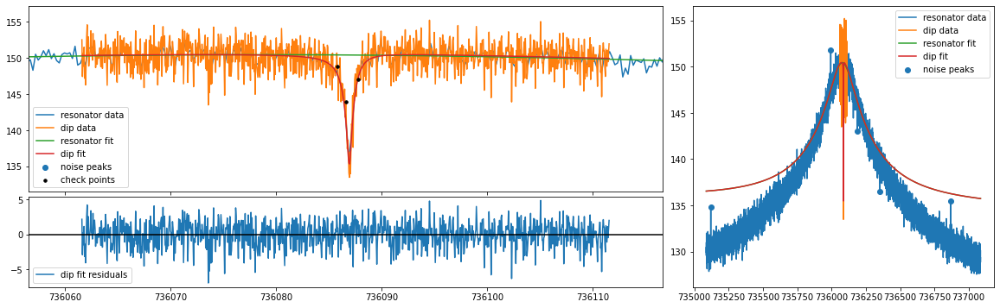

mean fit residuals = 9.3e-06 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950639296529786 0.0991822694023452
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.939493032405
dnu_z                    0.020577373018
dip_width                1.995063929653
ddip_width               0.099182269402
fit_err                  3.350966723914
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off               33916445345679.953125
doff           69591495659.042541503906
A                  1

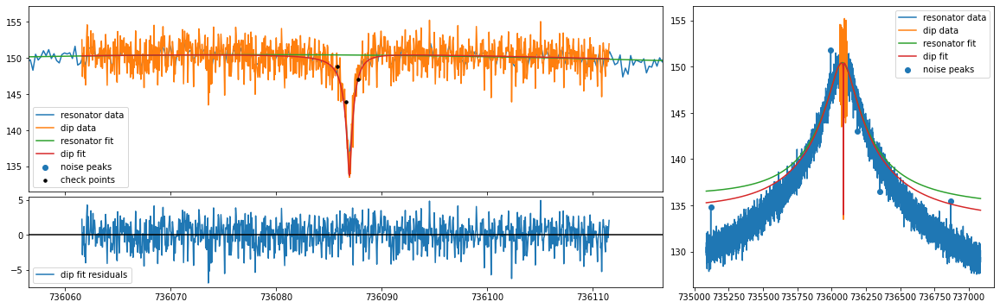

mean fit residuals = 5.7e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950132487117094 0.0948629182128752
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                 736086.94118708407
dnu_z                    0.018020335719
dip_width                1.995013248712
ddip_width               0.094862918213
fit_err                  3.364754458978
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off               23552874126201.515625
doff           69591495659.042541503906
A                  1

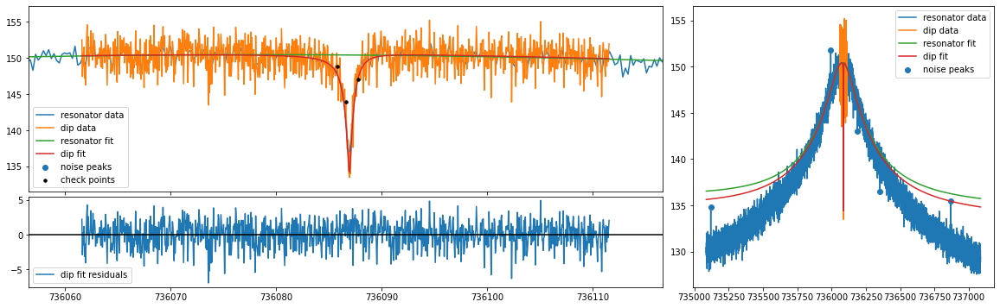

mean fit residuals = 4.2e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950168536154052 0.09595876573260723
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.940718112397
dnu_z                    0.018696018387
dip_width                1.995016853615
ddip_width               0.095958765733
fit_err                  3.358247518523
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off                  26143766931071.125
doff           69591495659.042541503906
A                  

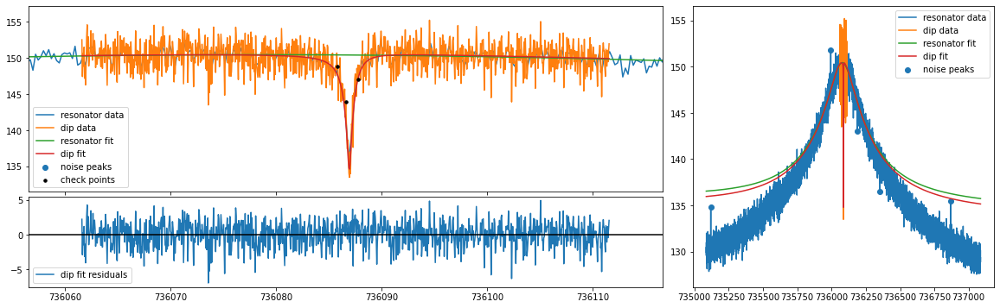

mean fit residuals = 2.8e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950239834343217 0.09704288773747444
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.940282196272
dnu_z                    0.019344616266
dip_width                1.995023983434
ddip_width               0.097042887737
fit_err                  3.354016491085
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off               28734659735940.734375
doff           69591495659.042541503906
A                  

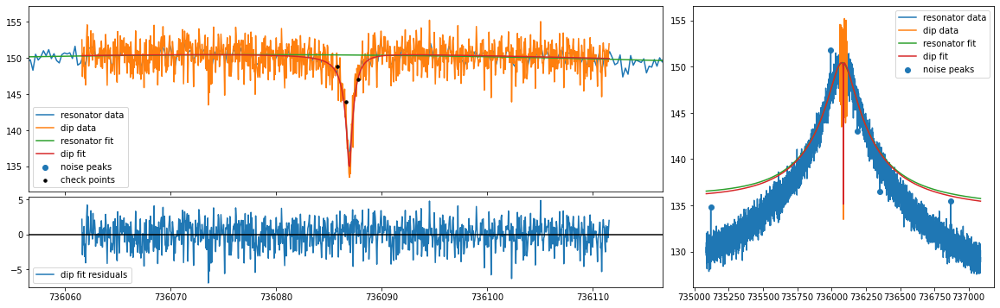

mean fit residuals = 1.4e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950377771023349 0.09811688808779523
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.939875083393
dnu_z                    0.019970573111
dip_width                1.995037777102
ddip_width               0.098116888088
fit_err                  3.351685061635
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off                31325552540810.34375
doff           69591495659.042541503906
A                  

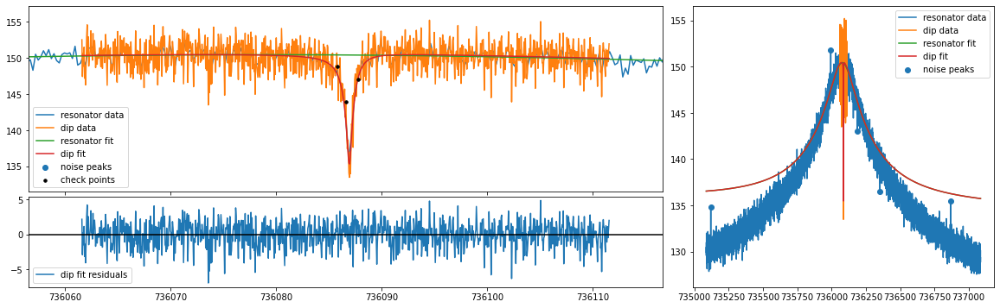

mean fit residuals = 9.3e-06 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9950639296529786 0.0991822694023452
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.939493032405
dnu_z                    0.020577373018
dip_width                1.995063929653
ddip_width               0.099182269402
fit_err                  3.350966723914
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off               33916445345679.953125
doff           69591495659.042541503906
A                  1

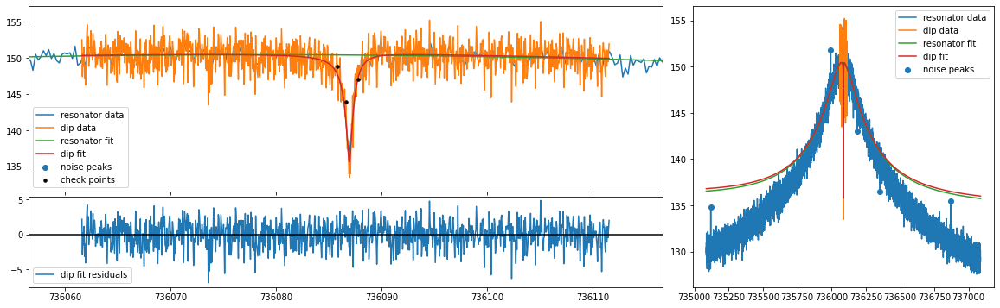

mean fit residuals = -1.4e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.995112570568876 0.10024044155702104
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.939132692874
dnu_z                    0.021167824443
dip_width                1.995112570569
ddip_width               0.100240441557
fit_err                  3.351638684983
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off                 36507338150549.5625
doff           69591495659.042541503906
A                  

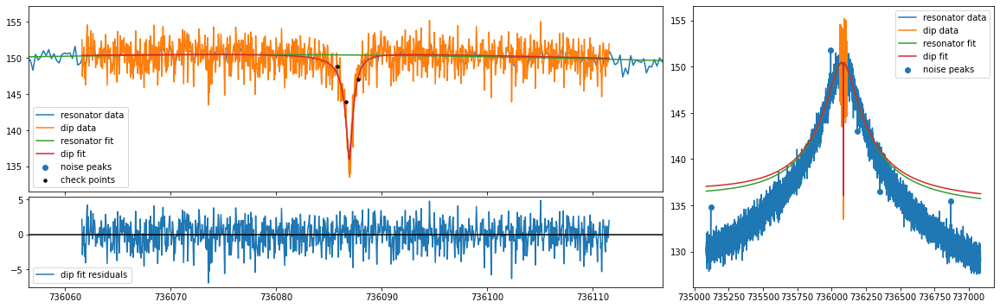

mean fit residuals = -2.7e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9952013299416724 0.10129292752928784
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.938790973742
dnu_z                    0.021744263273
dip_width                1.995201329942
ddip_width               0.101292927529
fit_err                  3.353524630747
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off               39098230955419.171875
doff           69591495659.042541503906
A                 

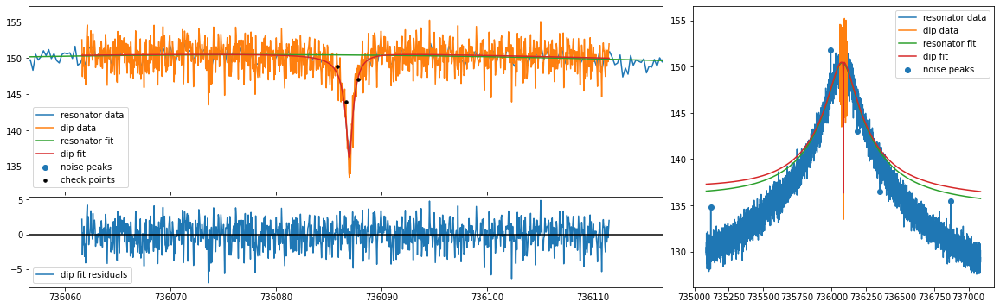

mean fit residuals = -4.1e-02 +/- 5.8e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9953601482158128 0.10234142567097256
mcycle                                1
cycle                                 8
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_195154.483509
nu_z                736086.938464899547
dnu_z                    0.022308710355
dip_width                1.995360148216
ddip_width               0.102341425671
fit_err                  3.356482945998
fit_success                        True
average_idx                           0
nu_res              736078.964691282366
dnu_res                  0.410655258589
Q                     4484.236083516284
dQ                      31.210952693847
th                      -0.000391471277
dth                        0.0000176061
off                41689123760288.78125
doff           69591495659.042541503906
A                 

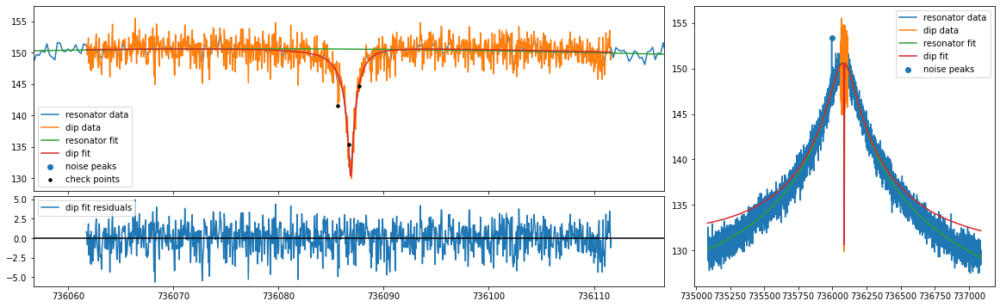

mean fit residuals = 5.8e-07 +/- 5.5e-02
original all {'A': 1134933274848707.2, 'dA': 15577652912660.744, 'Q': 4533.956570018536, 'dQ': 32.21629547347746, 'offset': 10707972113053.416, 'doffset': 2150680295370.4866, 'slope': -0.0003944896087341771, 'dslope': 1.784268442576681e-05, 'nu_res': 736078.8634085107, 'dnu_res': 0.4137124081858922, 'nu_z': 736086.8647866069, 'dnu_z': 0.015488033610220928, 'dip_width': 2.885678306025735, 'ddip_width': 0.11121249357298608, 'pcov': array([[ 2.398791851113e-04, -8.115723456148e-05, -1.808804586436e+09,
        -1.165474974832e+09],
       [-8.115723456148e-05,  1.236821872672e-02,  4.917144084683e+11,
         7.017740155582e+10],
       [-1.808804586436e+09,  4.917144084683e+11,  2.426632702673e+26,
        -3.457894192376e+24],
       [-1.165474974832e+09,  7.017740155582e+10, -3.457894192376e+24,
         4.625425732895e+24]]), 'perr': array([1.548803361022e-02, 1.112124935730e-01, 1.557765291266e+13,
       2.150680295370e+12]), 'popt': dict_va

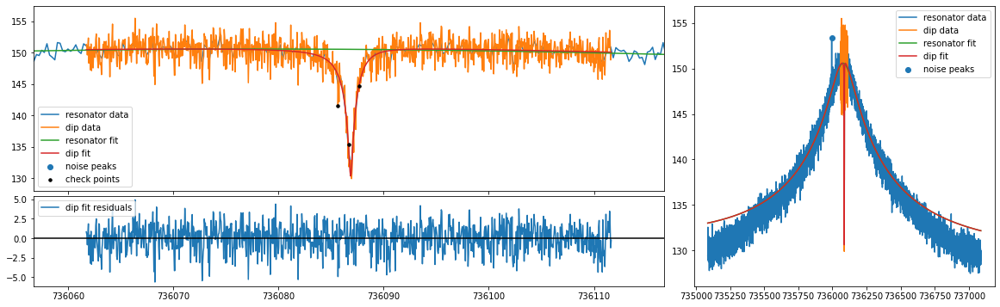

mean fit residuals = -4.8e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8854224576864063 0.10024454827421185
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.864910839708
dnu_z                    0.015461417578
dip_width                2.885422457686
ddip_width               0.100244548274
fit_err                  3.032980952564
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off            10707972113053.416015625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             133497346

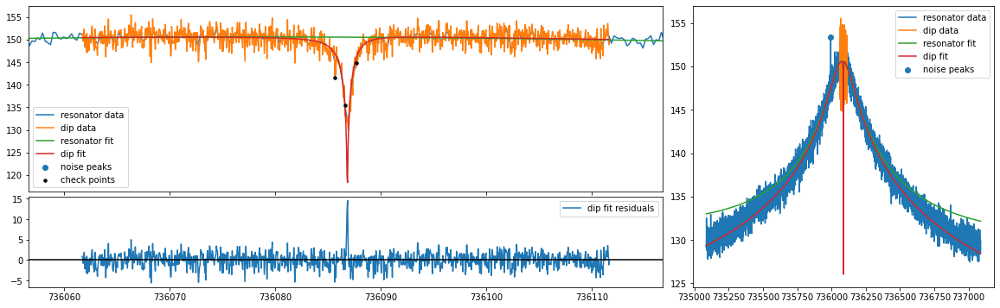

mean fit residuals = 2.2e-02 +/- 5.9e-02
[0.5, 3.0] 3.0 2.5118899877073644 0.08823929391309994
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.832832923392
dnu_z                    0.005515853412
dip_width                2.511889987707
ddip_width               0.088239293913
fit_err                  3.461457588978
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off              344400893574.978515625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             1334973468

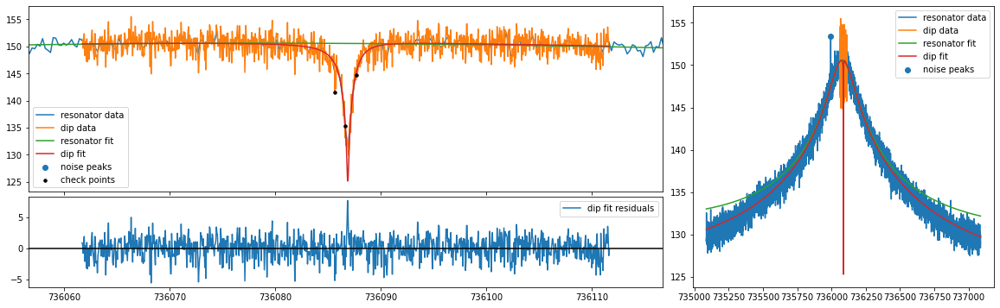

mean fit residuals = 3.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.710963156943622 0.09188544937624858
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                 736086.87760295975
dnu_z                    0.010280934614
dip_width                2.710963156944
ddip_width               0.091885449376
fit_err                  3.133092498779
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off            2935293698444.5869140625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             13349734688

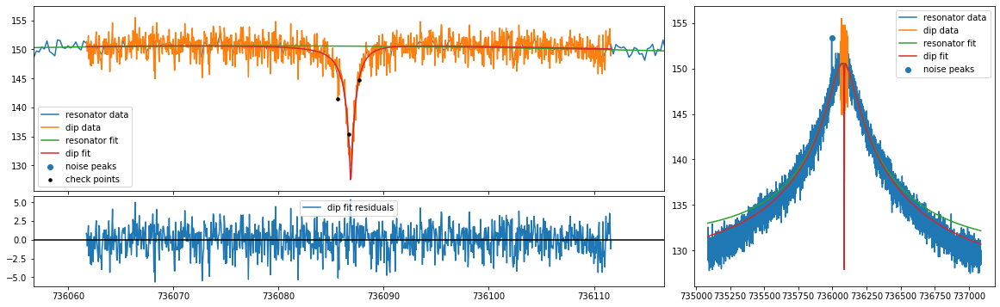

mean fit residuals = 2.2e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7876152295065952 0.09488532492846655
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.870934128412
dnu_z                     0.01243198958
dip_width                2.787615229507
ddip_width               0.094885324928
fit_err                  3.063823070618
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off             5526186503314.197265625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             1334973468

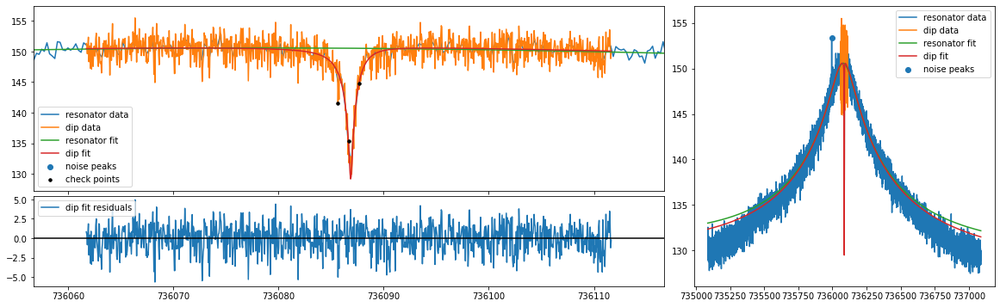

mean fit residuals = 1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.841535051749636 0.09763723634613551
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.867298710276
dnu_z                    0.014066886829
dip_width                 2.84153505175
ddip_width               0.097637236346
fit_err                  3.038965399314
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off             8117079308183.806640625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             13349734688

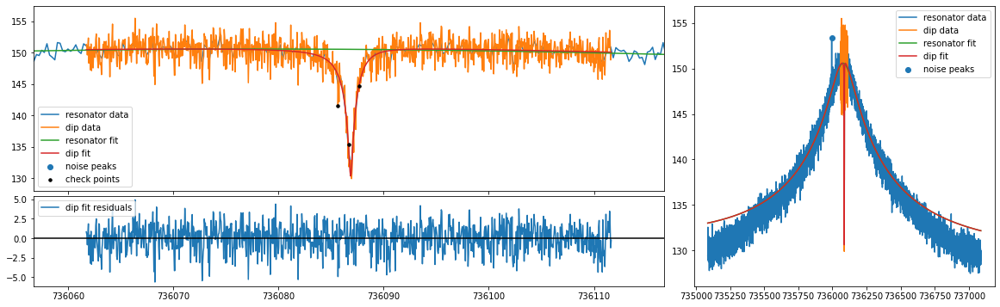

mean fit residuals = -4.8e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.8854224576864063 0.10024454827421185
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.864910839708
dnu_z                    0.015461417578
dip_width                2.885422457686
ddip_width               0.100244548274
fit_err                  3.032980952564
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off            10707972113053.416015625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             133497346

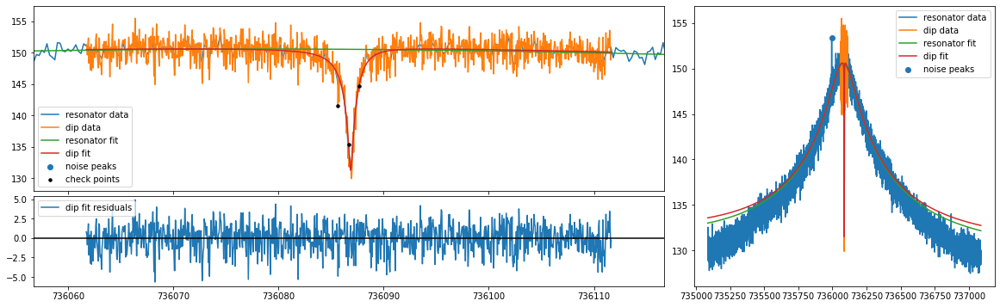

mean fit residuals = -1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9236236336118457 0.10275213236556102
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.863182231318
dnu_z                    0.016713413564
dip_width                2.923623633612
ddip_width               0.102752132366
fit_err                  3.037079820586
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off            13298864917923.025390625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             133497346

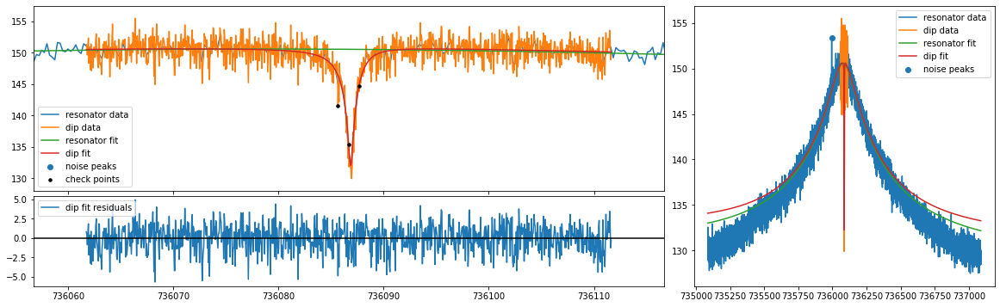

mean fit residuals = -2.3e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9581692206118895 0.10518551097608131
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.861836547381
dnu_z                    0.017870436075
dip_width                2.958169220612
ddip_width               0.105185510976
fit_err                  3.047256254444
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off            15889757722792.634765625
doff           70565177369.118377685547
A                   1134933274848707.25
dA             133497346

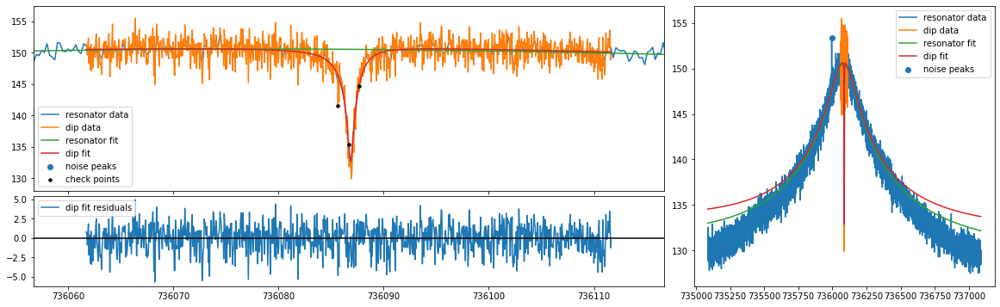

mean fit residuals = -3.3e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.992891839107608 0.10761076228076097
mcycle                                1
cycle                                 9
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_202248.304991
nu_z                736086.860945873661
dnu_z                    0.018968169104
dip_width                2.992891839108
ddip_width               0.107610762281
fit_err                  3.061381333231
fit_success                        True
average_idx                           0
nu_res               736078.86340851069
dnu_res                  0.413712408186
Q                     4533.956570018536
dQ                      32.216295473477
th                      -0.000394489609
dth                      0.000017842684
off             18480650527662.24609375
doff           70565177369.118377685547
A                   1134933274848707.25
dA             1334973468

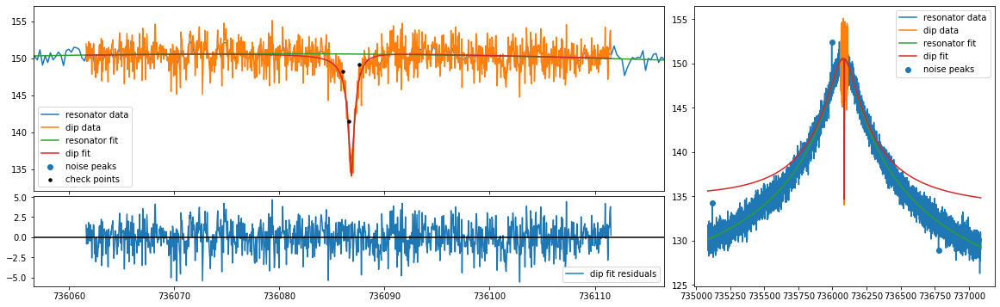

mean fit residuals = 1.4e-08 +/- 5.4e-02
original all {'A': 1098984019959724.6, 'dA': 15435789281595.875, 'Q': 4519.983157401619, 'dQ': 31.357943763058874, 'offset': 25891161373864.273, 'doffset': 5275154139797.865, 'slope': -0.00037296264585987064, 'dslope': 1.7439746367224718e-05, 'nu_res': 736078.7537465229, 'dnu_res': 0.4052014856095508, 'nu_z': 736086.8555053388, 'dnu_z': 0.01653307417254824, 'dip_width': 1.8154521827931398, 'ddip_width': 0.09463258916640174, 'pcov': array([[ 2.733425415950e-04, -9.425312095915e-05,  9.434937105083e+08,
        -3.794849258593e+09],
       [-9.425312095915e-05,  8.955326932337e-03,  1.668148875118e+11,
         1.789946639890e+11],
       [ 9.434937105083e+08,  1.668148875118e+11,  2.382635907458e+26,
        -2.596178606384e+25],
       [-3.794849258593e+09,  1.789946639890e+11, -2.596178606384e+25,
         2.782725119863e+25]]), 'perr': array([1.653307417255e-02, 9.463258916640e-02, 1.543578928160e+13,
       5.275154139798e+12]), 'popt': dict_

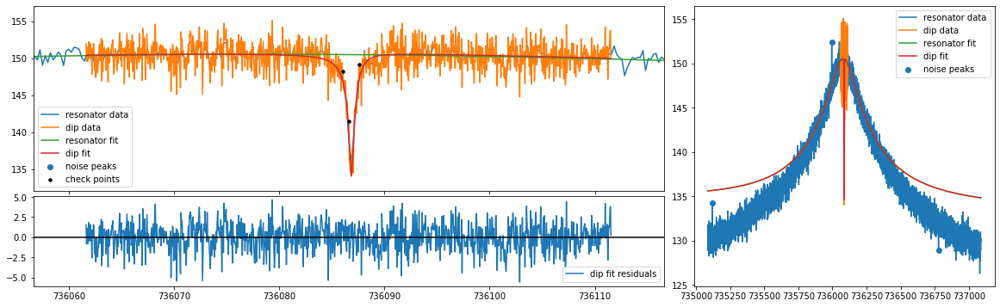

mean fit residuals = 1.2e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8155169959894826 0.0852588535003249
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855552811176
dnu_z                    0.016500232504
dip_width                1.815516995989
ddip_width                 0.0852588535
fit_err                  2.936642018569
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              25891161373864.2734375
doff           69136870444.791625976562
A                  1

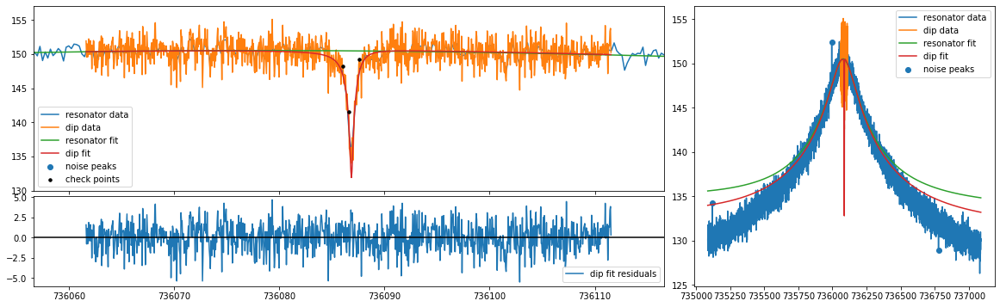

mean fit residuals = 4.2e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7296648384901956 0.07905972295471074
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855892934371
dnu_z                    0.013510465846
dip_width                 1.72966483849
ddip_width               0.079059722955
fit_err                  2.955448398142
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              15527590154385.8359375
doff           69136870444.791625976562
A                  

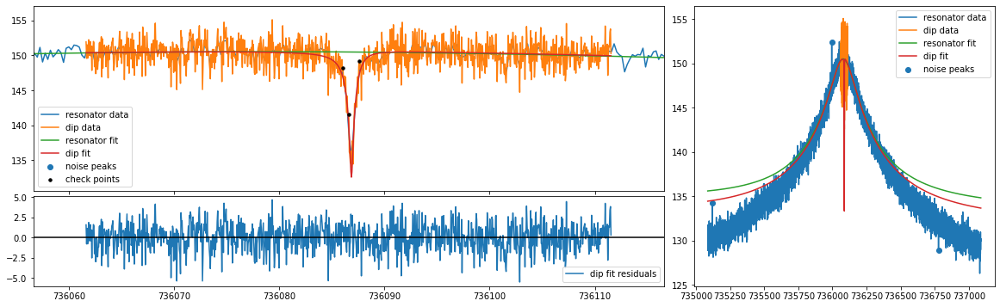

mean fit residuals = 3.1e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7534858908034945 0.08067654721193425
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855712048942
dnu_z                    0.014316179504
dip_width                1.753485890803
ddip_width               0.080676547212
fit_err                  2.946263428368
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              18118482959255.4453125
doff           69136870444.791625976562
A                  

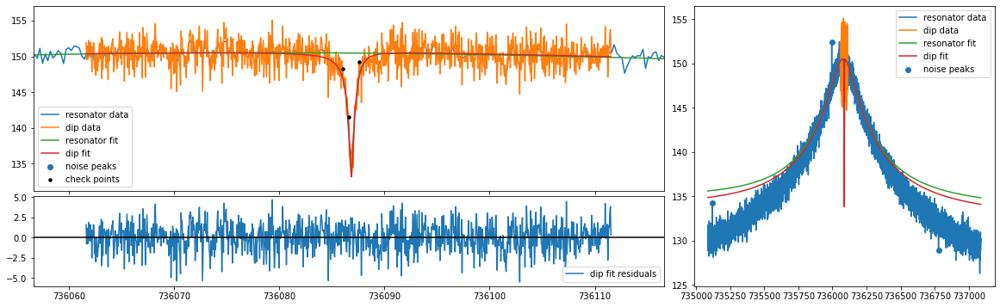

mean fit residuals = 2.1e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7754469257078345 0.08224091810692763
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855603150791
dnu_z                    0.015076718827
dip_width                1.775446925708
ddip_width               0.082240918107
fit_err                  2.940570979565
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              20709375764125.0546875
doff           69136870444.791625976562
A                  

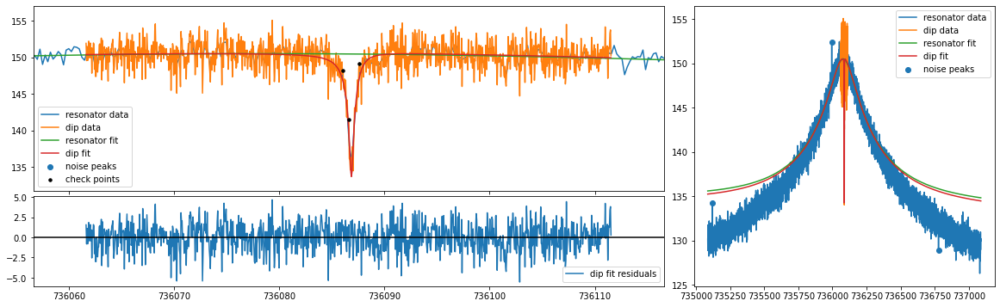

mean fit residuals = 1.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.796174171287881 0.08376910463001987
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855598330381
dnu_z                    0.015803009301
dip_width                1.796174171288
ddip_width                0.08376910463
fit_err                  2.937552697826
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              23300268568994.6640625
doff           69136870444.791625976562
A                  1

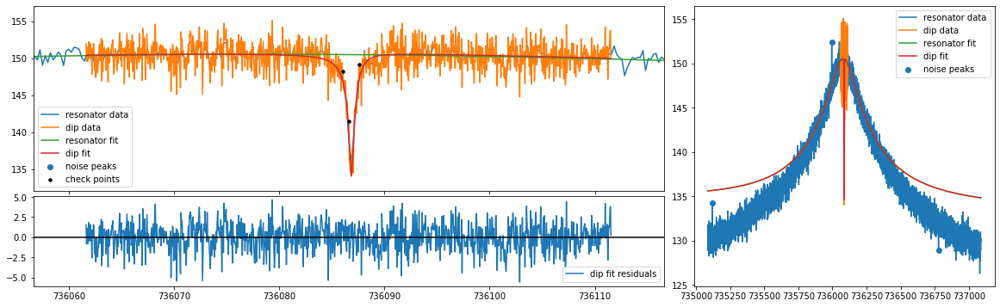

mean fit residuals = 1.2e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8155169959894826 0.0852588535003249
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855552811176
dnu_z                    0.016500232504
dip_width                1.815516995989
ddip_width                 0.0852588535
fit_err                  2.936642018569
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              25891161373864.2734375
doff           69136870444.791625976562
A                  1

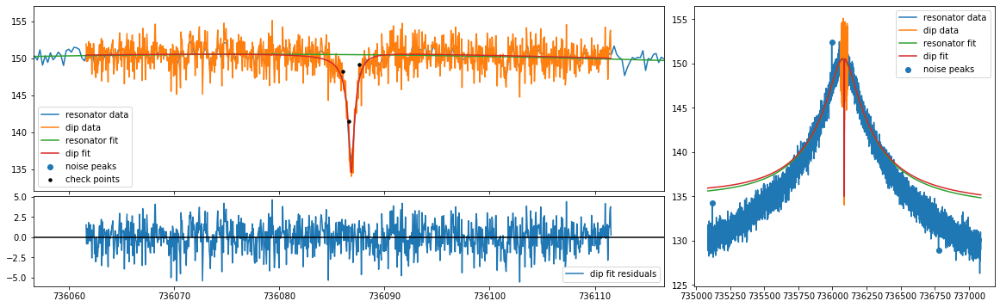

mean fit residuals = -1.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8340569358341516 0.08672500271149522
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855528116575
dnu_z                      0.0171752488
dip_width                1.834056935834
ddip_width               0.086725002711
fit_err                  2.937437166685
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              28482054178733.8828125
doff           69136870444.791625976562
A                 

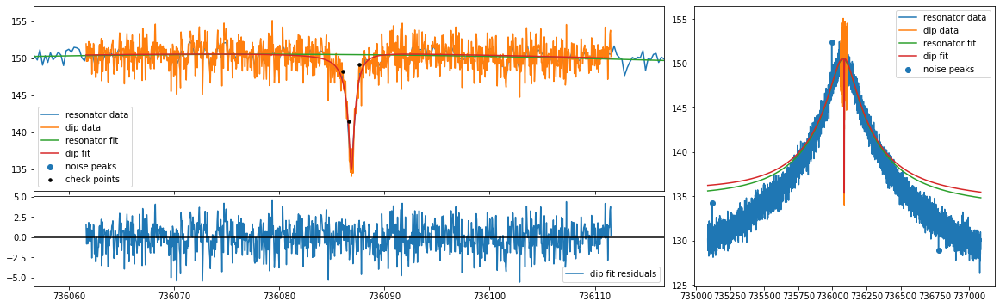

mean fit residuals = -2.1e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8519351262551829 0.08817193163157713
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855518510216
dnu_z                    0.017832001617
dip_width                1.851935126255
ddip_width               0.088171931632
fit_err                  2.939639944259
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              31072946983603.4921875
doff           69136870444.791625976562
A                 

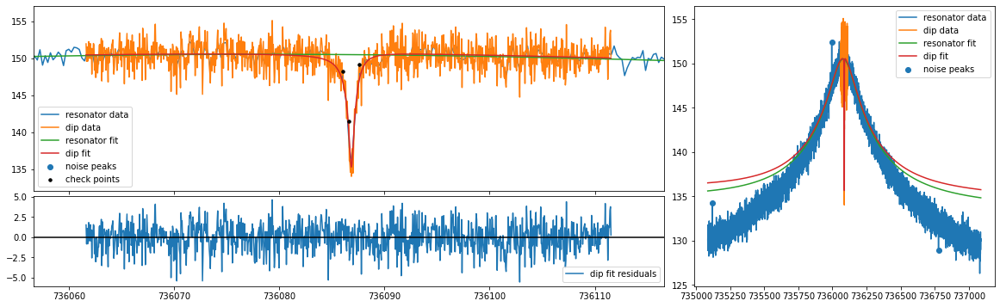

mean fit residuals = -3.1e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8692640816118924 0.08960319377762109
mcycle                                1
cycle                                 9
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_201230.281292
nu_z                736086.855520336307
dnu_z                     0.01847358277
dip_width                1.869264081612
ddip_width               0.089603193778
fit_err                  2.943024414236
fit_success                        True
average_idx                           0
nu_res               736078.75374652294
dnu_res                   0.40520148561
Q                     4519.983157401619
dQ                      31.357943763059
th                      -0.000372962646
dth                      0.000017439746
off              33663839788473.1015625
doff           69136870444.791625976562
A                 

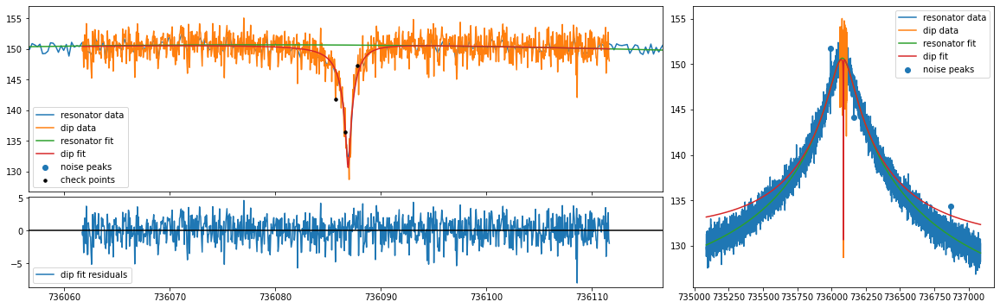

mean fit residuals = 1.7e-08 +/- 5.6e-02
original all {'A': 1106987547440946.9, 'dA': 15475905460470.445, 'Q': 4543.6499286205135, 'dQ': 32.39509018572713, 'offset': 11663738179772.246, 'doffset': 2380429518752.44, 'slope': -0.0003901481011502599, 'dslope': 1.7900404846464134e-05, 'nu_res': 736079.1062221186, 'dnu_res': 0.4143757652441459, 'nu_z': 736086.9052030258, 'dnu_z': 0.01598218805276914, 'dip_width': 2.757795796639281, 'ddip_width': 0.1115921602964502, 'pcov': array([[ 2.554303349541e-04, -8.475461781950e-05, -1.635185554675e+09,
        -1.343647201274e+09],
       [-8.475461781950e-05,  1.245281023963e-02,  4.651468402712e+11,
         7.989459722981e+10],
       [-1.635185554675e+09,  4.651468402712e+11,  2.395036498214e+26,
        -4.407513106506e+24],
       [-1.343647201274e+09,  7.989459722981e+10, -4.407513106506e+24,
         5.666444693748e+24]]), 'perr': array([1.598218805277e-02, 1.115921602965e-01, 1.547590546047e+13,
       2.380429518752e+12]), 'popt': dict_valu

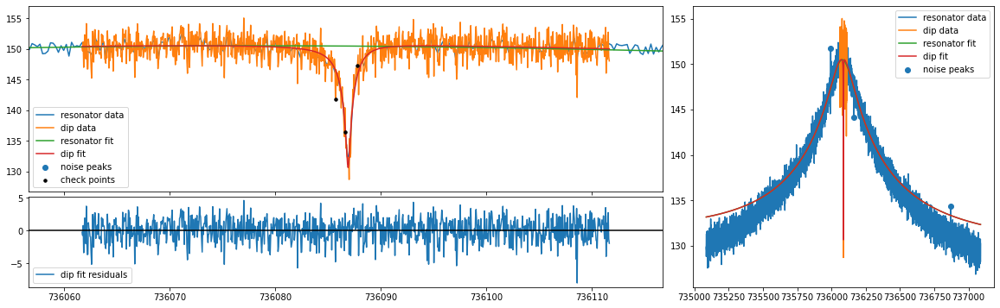

mean fit residuals = 1.8e-04 +/- 5.6e-02
[0.5, 3.0] 3.0 2.758750848933464 0.10065702143370475
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.905004952103
dnu_z                    0.015958038002
dip_width                2.758750848933
ddip_width               0.100657021434
fit_err                   3.14560799516
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off             11663738179772.24609375
doff            70620109268.22053527832
A                  1106987547440946.875
dA             13488381804

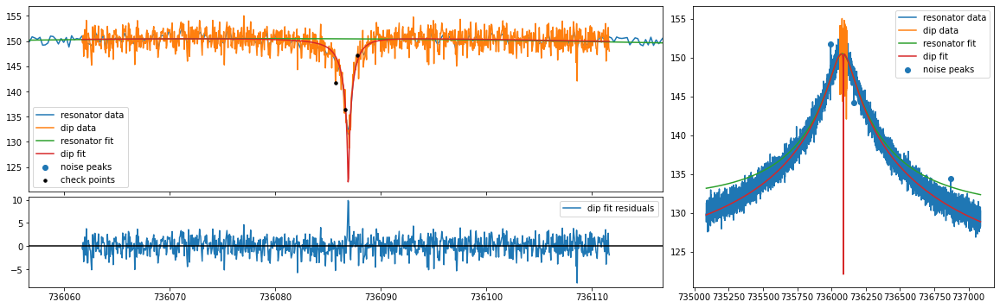

mean fit residuals = 3.4e-02 +/- 5.8e-02
[0.5, 3.0] 3.0 2.481032258365595 0.08887046693639317
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.925217535463
dnu_z                    0.008020289984
dip_width                2.481032258366
ddip_width               0.088870466936
fit_err                  3.370623781738
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off              1300166960293.80859375
doff            70620109268.22053527832
A                  1106987547440946.875
dA             13488381804

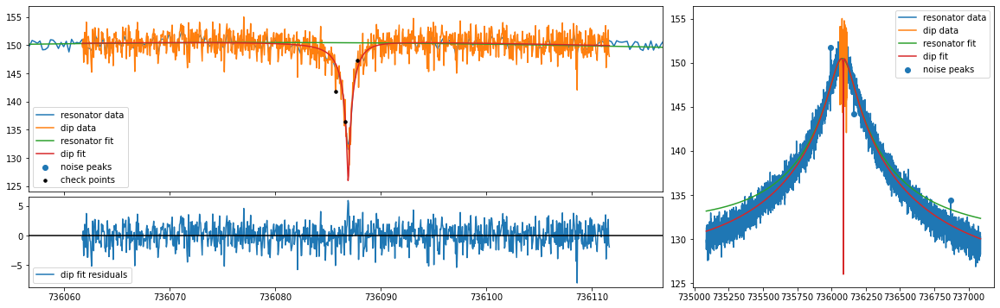

mean fit residuals = 3.2e-02 +/- 5.7e-02
[0.5, 3.0] 3.0 2.605070184920619 0.09249384845628593
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.915780169657
dnu_z                    0.011180779667
dip_width                2.605070184921
ddip_width               0.092493848456
fit_err                  3.220531996192
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off            3891059765163.4169921875
doff            70620109268.22053527832
A                  1106987547440946.875
dA             13488381804

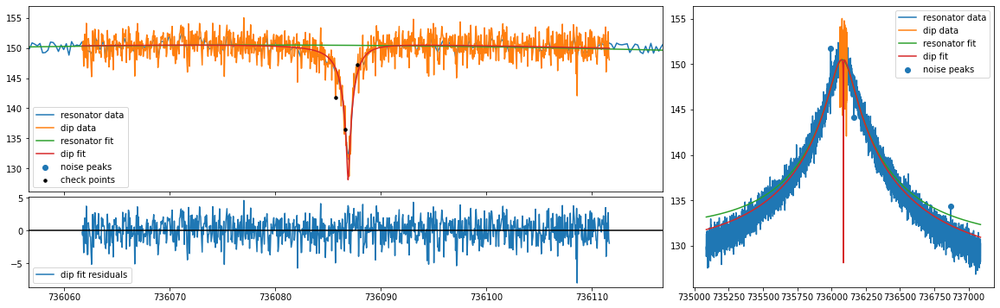

mean fit residuals = 2.2e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.6683618830106317 0.09539762725363168
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.911173197557
dnu_z                    0.013087523692
dip_width                2.668361883011
ddip_width               0.095397627254
fit_err                  3.170039515504
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off              6481952570033.02734375
doff            70620109268.22053527832
A                  1106987547440946.875
dA             1348838180

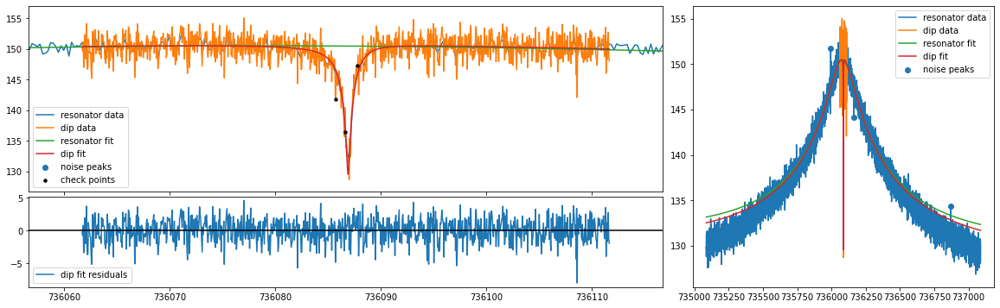

mean fit residuals = 1.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7172462571457605 0.09809381559045667
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.907764142845
dnu_z                    0.014620632579
dip_width                2.717246257146
ddip_width                0.09809381559
fit_err                  3.150474632286
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off              9072845374902.63671875
doff            70620109268.22053527832
A                  1106987547440946.875
dA             1348838180

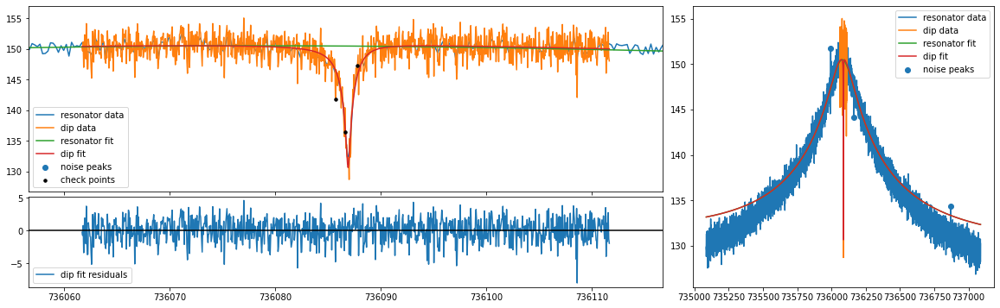

mean fit residuals = 1.8e-04 +/- 5.6e-02
[0.5, 3.0] 3.0 2.758750848933464 0.10065702143370475
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.905004952103
dnu_z                    0.015958038002
dip_width                2.758750848933
ddip_width               0.100657021434
fit_err                   3.14560799516
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off             11663738179772.24609375
doff            70620109268.22053527832
A                  1106987547440946.875
dA             13488381804

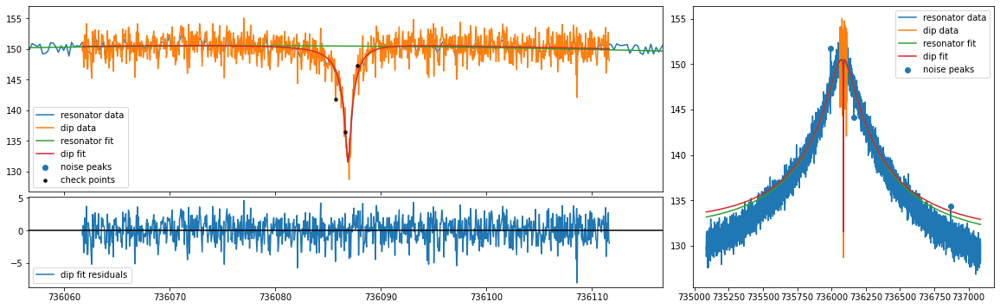

mean fit residuals = -1.1e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.7951522100109236 0.10311467752705146
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.902800040203
dnu_z                    0.017171171082
dip_width                2.795152210011
ddip_width               0.103114677527
fit_err                  3.149089100941
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off             14254630984641.85546875
doff            70620109268.22053527832
A                  1106987547440946.875
dA             134883818

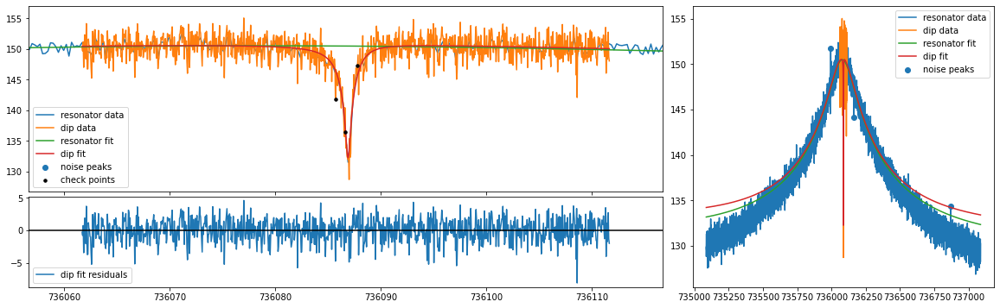

mean fit residuals = -2.2e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.829439393824935 0.10551848345595341
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                736086.900664990651
dnu_z                    0.018302953195
dip_width                2.829439393825
ddip_width               0.105518483456
fit_err                  3.157815620069
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off             16845523789511.46484375
doff            70620109268.22053527832
A                  1106987547440946.875
dA             1348838180

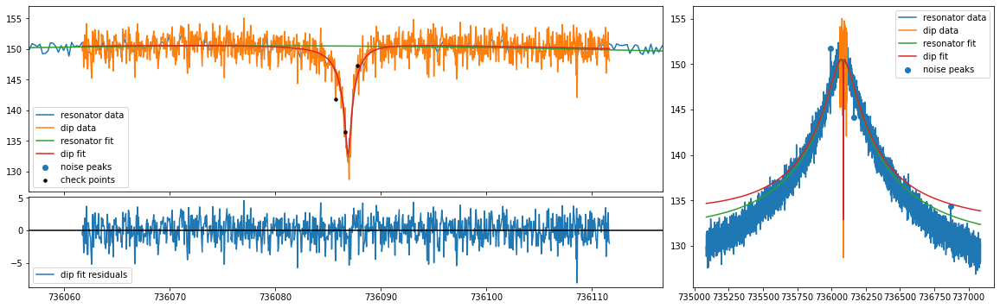

mean fit residuals = -3.3e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.861456112805512 0.10786529534068871
mcycle                                1
cycle                                10
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_204325.556977
nu_z                 736086.89877313457
dnu_z                    0.019373200414
dip_width                2.861456112806
ddip_width               0.107865295341
fit_err                  3.170061213082
fit_success                        True
average_idx                           0
nu_res                736079.1062221186
dnu_res                  0.414375765244
Q                     4543.649928620513
dQ                      32.395090185727
th                      -0.000390148101
dth                      0.000017900405
off             19436416594381.07421875
doff            70620109268.22053527832
A                  1106987547440946.875
dA             1348838180

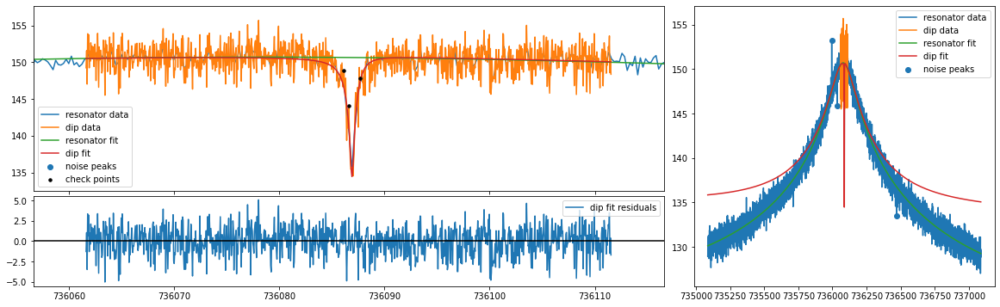

mean fit residuals = -1.8e-09 +/- 5.5e-02
original all {'A': 1130435372814252.5, 'dA': 16089905569020.072, 'Q': 4597.299249152511, 'dQ': 31.898539320096628, 'offset': 27930211542790.098, 'doffset': 5631869330344.576, 'slope': -0.00038083666152067863, 'dslope': 1.7224969629166082e-05, 'nu_res': 736078.4147443896, 'dnu_res': 0.396899673480108, 'nu_z': 736086.9099965282, 'dnu_z': 0.017109484490003754, 'dip_width': 1.8468355691680933, 'ddip_width': 0.09698098452930207, 'pcov': array([[ 2.927344595137e-04, -1.049366417223e-04,  9.675418668589e+08,
        -4.235184170114e+09],
       [-1.049366417223e-04,  9.405311360273e-03,  1.704321958404e+11,
         1.976694948879e+11],
       [ 9.675418668589e+08,  1.704321958404e+11,  2.588850612200e+26,
        -2.972849144249e+25],
       [-4.235184170114e+09,  1.976694948879e+11, -2.972849144249e+25,
         3.171795215408e+25]]), 'perr': array([1.710948449000e-02, 9.698098452930e-02, 1.608990556902e+13,
       5.631869330345e+12]), 'popt': dict

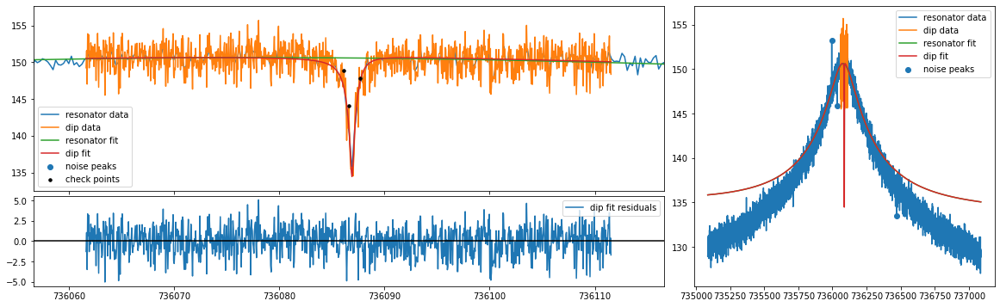

mean fit residuals = 4.0e-05 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8470612691959072 0.0872434903401312
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                 736086.91000013845
dnu_z                    0.017075748782
dip_width                1.847061269196
ddip_width                0.08724349034
fit_err                  2.986070046578
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             27930211542790.09765625
doff           68019547668.895820617676
A                   

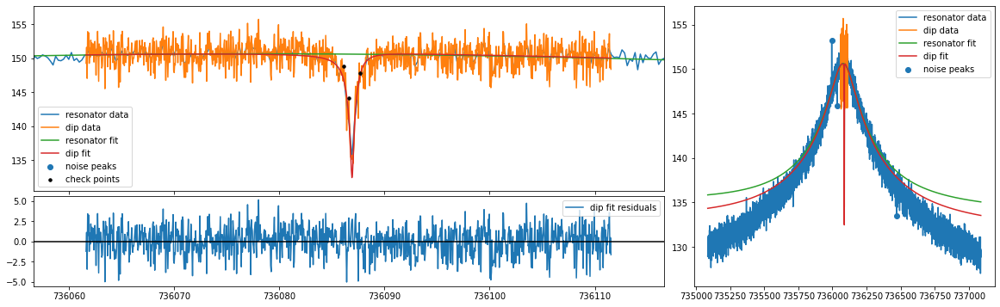

mean fit residuals = 4.0e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7614975909420605 0.0811563700570491
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.912766294205
dnu_z                    0.014192044242
dip_width                1.761497590942
ddip_width               0.081156370057
fit_err                  3.001837135958
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             17566640323311.66015625
doff           68019547668.895820617676
A                   

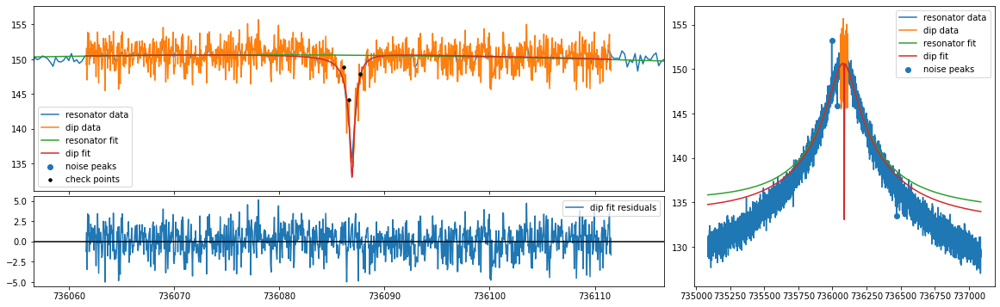

mean fit residuals = 3.0e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7844809125577428 0.08272640780675851
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.911925040302
dnu_z                    0.014960179491
dip_width                1.784480912558
ddip_width               0.082726407807
fit_err                  2.994205328061
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             20157533128181.26953125
doff           68019547668.895820617676
A                  

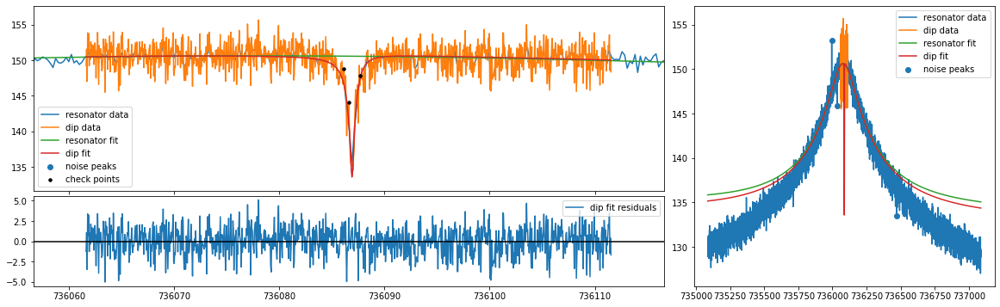

mean fit residuals = 2.0e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8062624075856526 0.08426005414726728
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.911198193789
dnu_z                    0.015692214456
dip_width                1.806262407586
ddip_width               0.084260054147
fit_err                  2.989416114556
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             22748425933050.87890625
doff           68019547668.895820617676
A                  

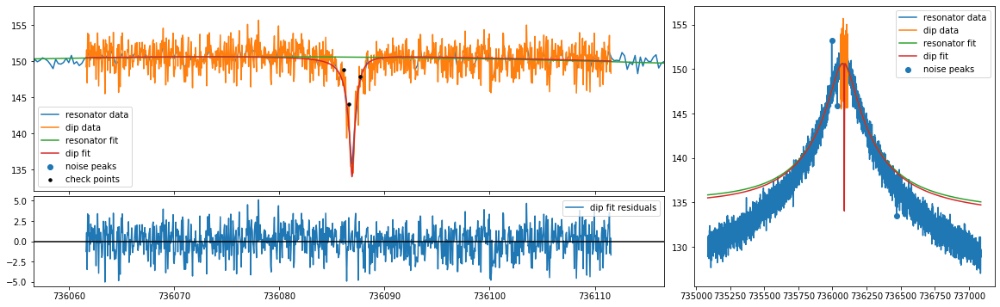

mean fit residuals = 9.9e-03 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.826696798648095 0.08575525576955376
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.910564306192
dnu_z                    0.016393940288
dip_width                1.826696798648
ddip_width                0.08575525577
fit_err                  2.986850293286
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             25339318737920.48828125
doff           68019547668.895820617676
A                   

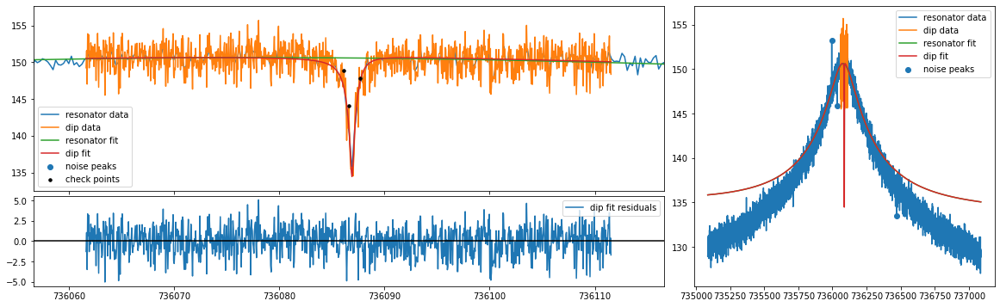

mean fit residuals = 4.0e-05 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8470612691959072 0.0872434903401312
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                 736086.91000013845
dnu_z                    0.017075748782
dip_width                1.847061269196
ddip_width                0.08724349034
fit_err                  2.986070046578
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             27930211542790.09765625
doff           68019547668.895820617676
A                   

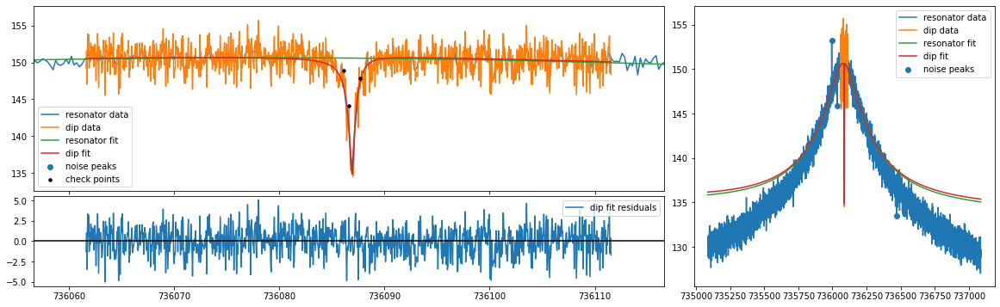

mean fit residuals = -9.9e-03 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8663879314950615 0.08870292810646321
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.909499724163
dnu_z                    0.017736837819
dip_width                1.866387931495
ddip_width               0.088702928106
fit_err                   2.98675500643
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             30521104347659.70703125
doff           68019547668.895820617676
A                 

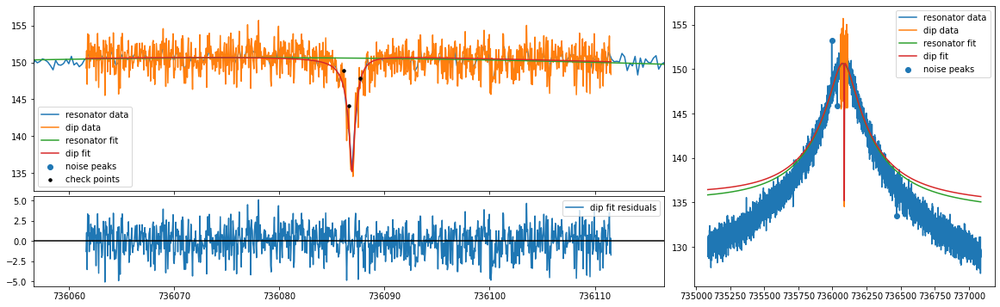

mean fit residuals = -2.0e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.885152905615785 0.09014579928749736
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.909051869414
dnu_z                    0.018382073272
dip_width                1.885152905616
ddip_width               0.090145799287
fit_err                  2.988664556656
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off             33111997152529.31640625
doff           68019547668.895820617676
A                  

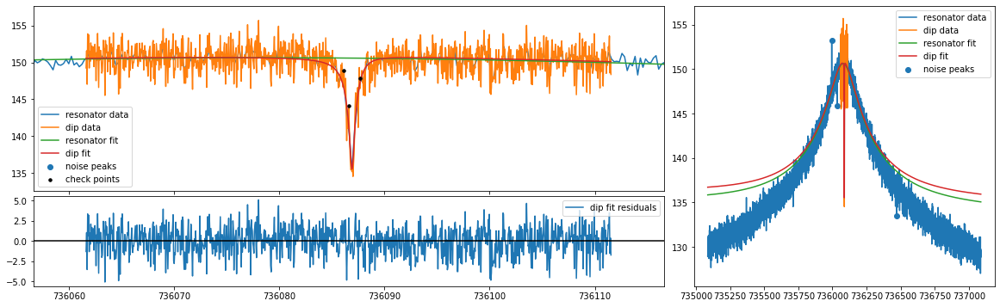

mean fit residuals = -3.0e-02 +/- 5.5e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9034428784559172 0.09157502241647572
mcycle                                1
cycle                                10
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_203306.988381
nu_z                736086.908650090103
dnu_z                    0.019014015262
dip_width                1.903442878456
ddip_width               0.091575022416
fit_err                  2.991613740866
fit_success                        True
average_idx                           0
nu_res              736078.414744389593
dnu_res                   0.39689967348
Q                     4597.299249152511
dQ                      31.898539320097
th                      -0.000380836662
dth                       0.00001722497
off              35702889957398.9296875
doff           68019547668.895820617676
A                 

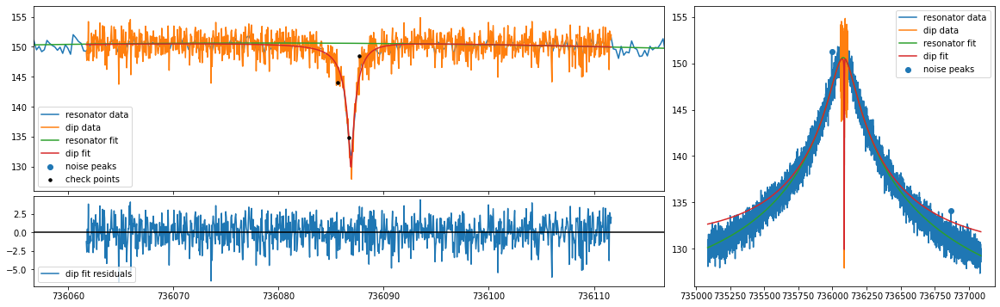

mean fit residuals = -3.9e-07 +/- 5.5e-02
original all {'A': 1106628845574721.5, 'dA': 15014405146387.729, 'Q': 4558.130342470664, 'dQ': 32.28798094615098, 'offset': 9586606698336.693, 'doffset': 1967319431429.935, 'slope': -0.00038546964521036126, 'dslope': 1.7700025860734923e-05, 'nu_res': 736078.9100602216, 'dnu_res': 0.4095855487087263, 'nu_z': 736086.8840597278, 'dnu_z': 0.014784100555286759, 'dip_width': 2.8245290417001647, 'ddip_width': 0.108068938114992, 'pcov': array([[ 2.185696292288e-04, -7.493541732826e-05, -1.624938584587e+09,
        -1.047224813027e+09],
       [-7.493541732826e-05,  1.167889538530e-02,  4.600300600354e+11,
         6.122476468357e+10],
       [-1.624938584587e+09,  4.600300600354e+11,  2.254323618999e+26,
        -2.872342847289e+24],
       [-1.047224813027e+09,  6.122476468357e+10, -2.872342847289e+24,
         3.870345745282e+24]]), 'perr': array([1.478410055529e-02, 1.080689381150e-01, 1.501440514639e+13,
       1.967319431430e+12]), 'popt': dict_va

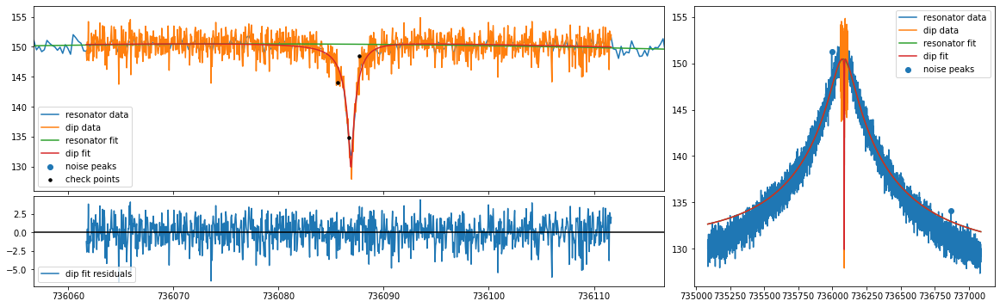

mean fit residuals = -8.1e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.824106884464779 0.09770170984909732
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.884238936706
dnu_z                    0.014757761384
dip_width                2.824106884465
ddip_width               0.097701709849
fit_err                  2.981781965368
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off             9586606698336.693359375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             1333665804

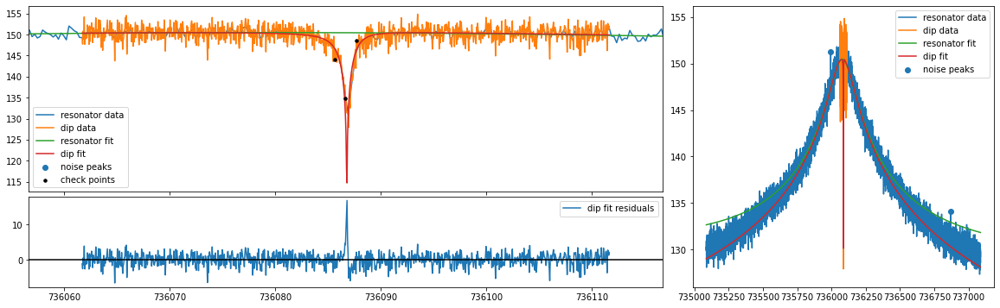

mean fit residuals = 3.2e-02 +/- 6.1e-02
[0.5, 3.0] 3.0 2.495526116413343 0.08901477859526569
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.784205238335
dnu_z                    0.002720487861
dip_width                2.495526116413
ddip_width               0.089014778595
fit_err                  3.695863605857
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off                9586606.698336692527
doff           69801965838.568237304688
A                    1106628845574721.5
dA             13336658048

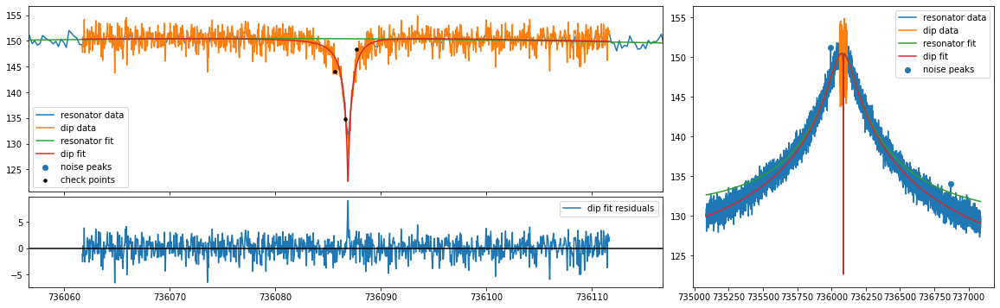

mean fit residuals = 3.0e-02 +/- 5.6e-02
[0.5, 3.0] 3.0 2.625211246787736 0.08878740511438321
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.897248736233
dnu_z                    0.008954227548
dip_width                2.625211246788
ddip_width               0.088787405114
fit_err                  3.121275000659
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off            1813928283727.8642578125
doff           69801965838.568237304688
A                    1106628845574721.5
dA             13336658048

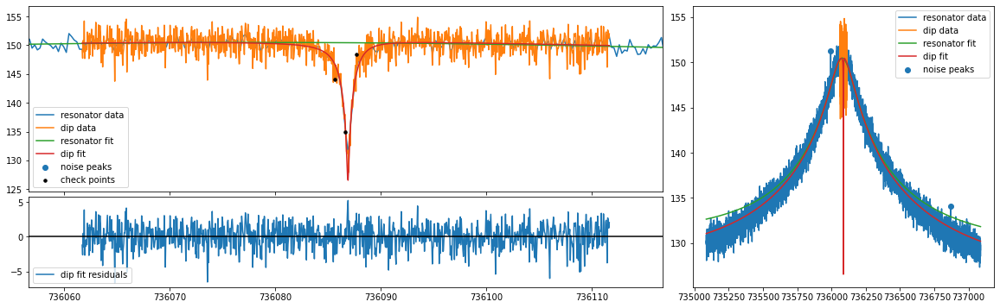

mean fit residuals = 2.2e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.7174971763950535 0.09203887564376716
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.890534363454
dnu_z                    0.011476048123
dip_width                2.717497176395
ddip_width               0.092038875644
fit_err                  3.019817865226
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off             4404821088597.474609375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             1333665804

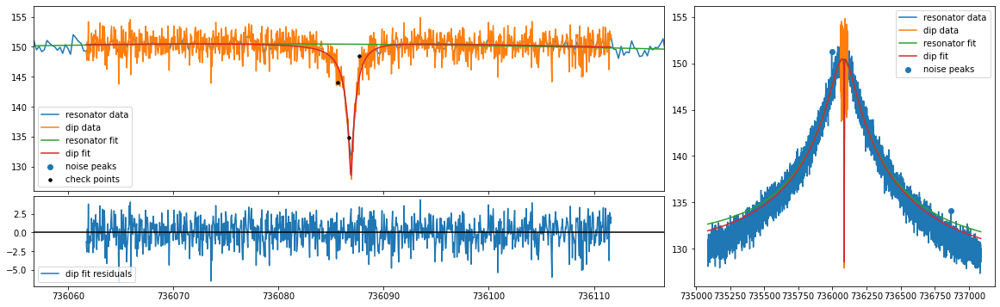

mean fit residuals = 1.1e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.777086539028981 0.09496265279836437
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.886756583466
dnu_z                    0.013272820765
dip_width                2.777086539029
ddip_width               0.094962652798
fit_err                  2.988814653402
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off             6995713893467.083984375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             13336658048

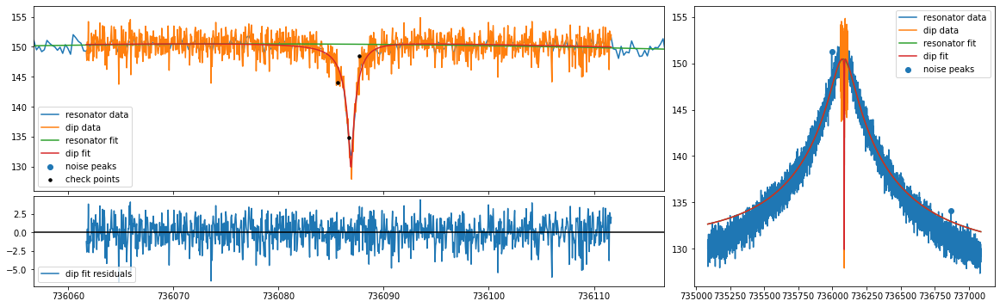

mean fit residuals = -8.1e-05 +/- 5.5e-02
[0.5, 3.0] 3.0 2.824106884464779 0.09770170984909732
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.884238936706
dnu_z                    0.014757761384
dip_width                2.824106884465
ddip_width               0.097701709849
fit_err                  2.981781965368
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off             9586606698336.693359375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             1333665804

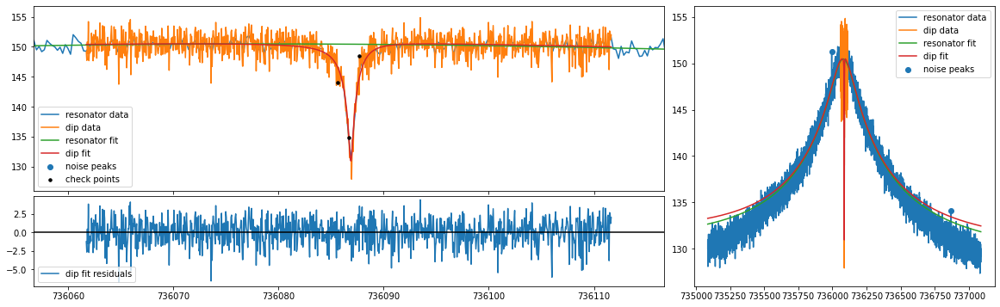

mean fit residuals = -1.2e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.864378471415808 0.10031597668573393
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.882351079723
dnu_z                    0.016069475571
dip_width                2.864378471416
ddip_width               0.100315976686
fit_err                  2.986397770162
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off            12177499503206.302734375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             1333665804

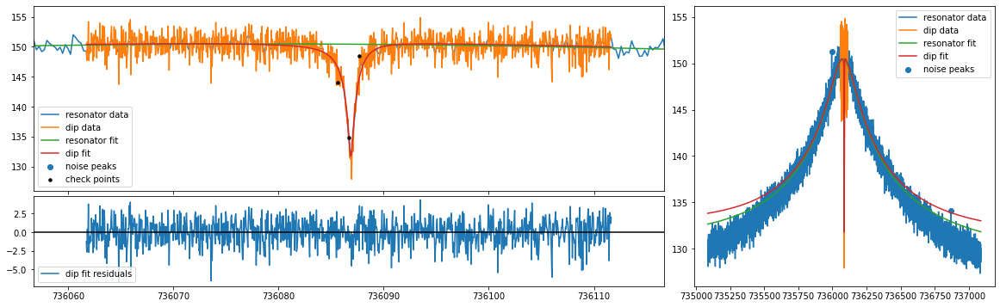

mean fit residuals = -2.3e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9005241499624197 0.10284072672353077
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.880723782931
dnu_z                    0.017270484007
dip_width                2.900524149962
ddip_width               0.102840726724
fit_err                  2.997650650118
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off            14768392308075.912109375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             133366580

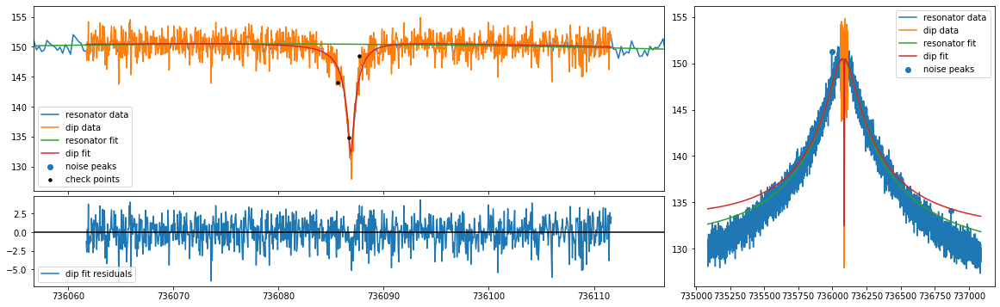

mean fit residuals = -3.5e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.9337560952593433 0.10529518293723877
mcycle                                1
cycle                                11
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_210402.622234
nu_z                736086.879282495589
dnu_z                    0.018394088352
dip_width                2.933756095259
ddip_width               0.105295182937
fit_err                  3.013051985345
fit_success                        True
average_idx                           0
nu_res              736078.910060221562
dnu_res                  0.409585548709
Q                     4558.130342470664
dQ                      32.287980946151
th                      -0.000385469645
dth                      0.000017700026
off              17359285112945.5234375
doff           69801965838.568237304688
A                    1106628845574721.5
dA             133366580

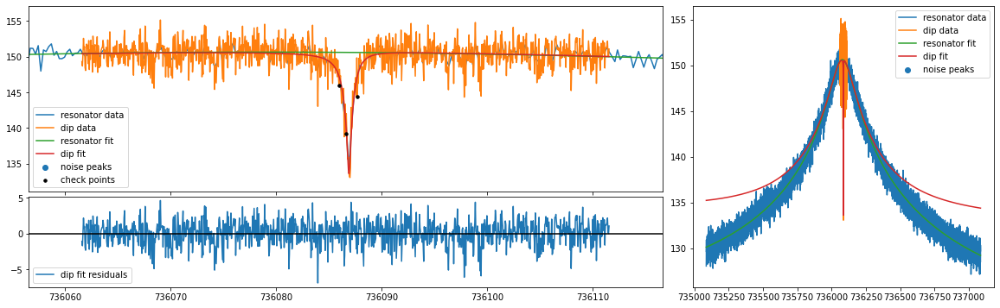

mean fit residuals = -3.6e-08 +/- 5.4e-02
original all {'A': 1109720002993978.0, 'dA': 15309509399934.64, 'Q': 4542.357825229676, 'dQ': 31.97159639250512, 'offset': 22964688466053.98, 'doffset': 4691658012074.186, 'slope': -0.00040841191459987735, 'dslope': 1.7664696919039638e-05, 'nu_res': 736079.4067100212, 'dnu_res': 0.408961778031196, 'nu_z': 736086.905698674, 'dnu_z': 0.016038223046978196, 'dip_width': 1.892267111204119, 'ddip_width': 0.09455387722940198, 'pcov': array([[ 2.572245985046e-04, -8.440338618318e-05,  5.358845139698e+08,
        -3.141751433832e+09],
       [-8.440338618318e-05,  8.940435699113e-03,  2.019373015106e+11,
         1.547698943820e+11],
       [ 5.358845139698e+08,  2.019373015106e+11,  2.343810780667e+26,
        -2.022313562081e+25],
       [-3.141751433832e+09,  1.547698943820e+11, -2.022313562081e+25,
         2.201165490226e+25]]), 'perr': array([1.603822304698e-02, 9.455387722940e-02, 1.530950939993e+13,
       4.691658012074e+12]), 'popt': dict_valu

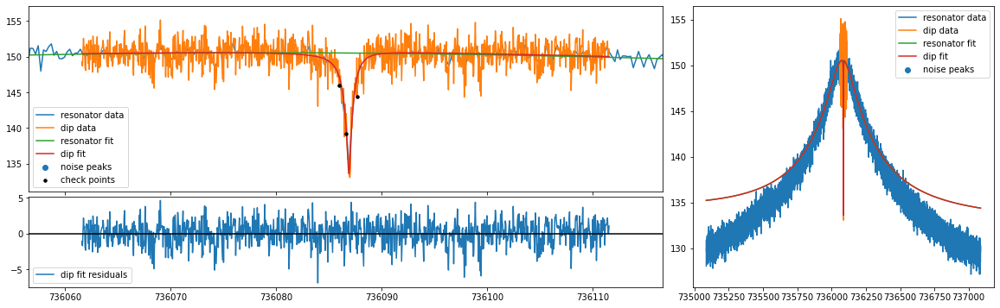

mean fit residuals = 5.2e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8925563246167882 0.08538119127866098
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                 736086.90565327392
dnu_z                     0.01600862664
dip_width                1.892556324617
ddip_width               0.085381191279
fit_err                  2.911511200423
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             22964688466053.98046875
doff           69613245538.706726074219
A                  

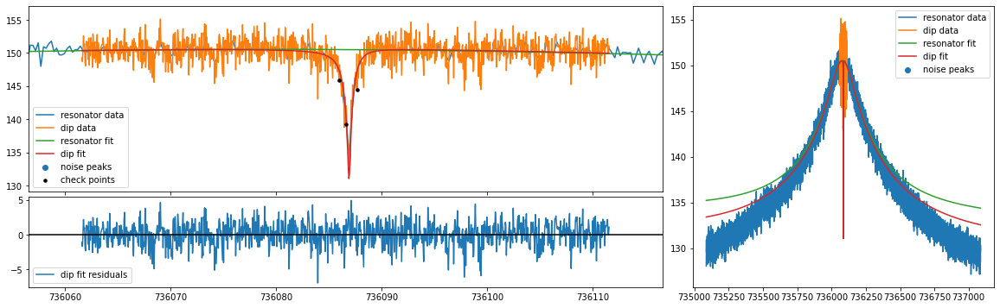

mean fit residuals = 3.9e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.7877389931408882 0.07855757581277785
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.913743420155
dnu_z                    0.012720925317
dip_width                1.787738993141
ddip_width               0.078557575813
fit_err                  2.933414930196
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             12601117246575.54296875
doff           69613245538.706726074219
A                  

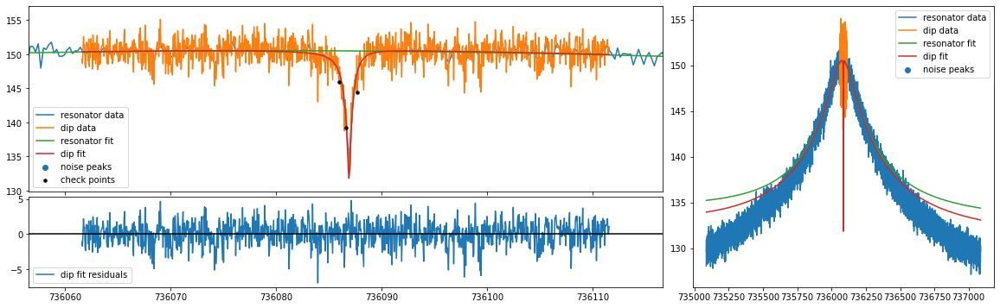

mean fit residuals = 3.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8163484529309375 0.08033887855919762
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.911326320027
dnu_z                    0.013619869317
dip_width                1.816348452931
ddip_width               0.080338878559
fit_err                  2.922497060001
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             15192010051445.15234375
doff           69613245538.706726074219
A                  

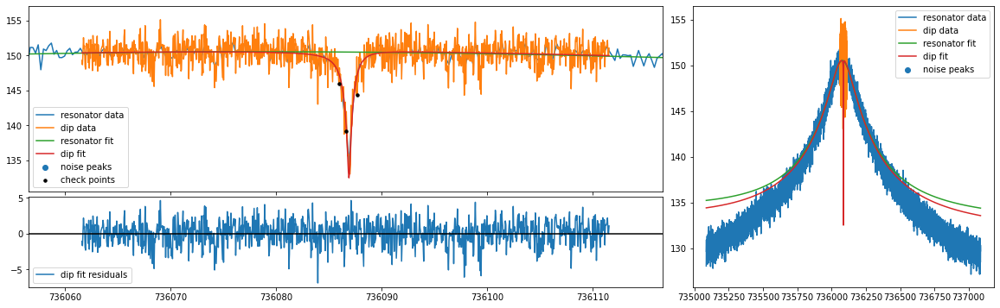

mean fit residuals = 2.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.844853932804794 0.08210153731358068
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.909068493987
dnu_z                    0.014464761964
dip_width                1.844853932805
ddip_width               0.082101537314
fit_err                  2.915926209206
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             17782902856314.76171875
doff           69613245538.706726074219
A                   

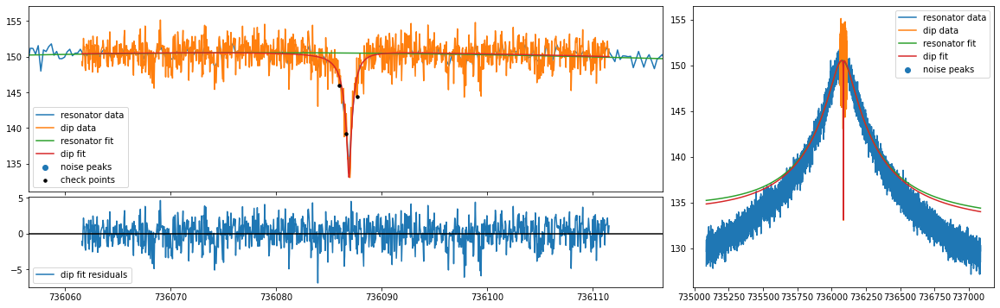

mean fit residuals = 1.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8692089434543395 0.08375804356232178
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.907271542936
dnu_z                    0.015253981595
dip_width                1.869208943454
ddip_width               0.083758043562
fit_err                  2.912518460377
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             20373795661184.37109375
doff           69613245538.706726074219
A                  

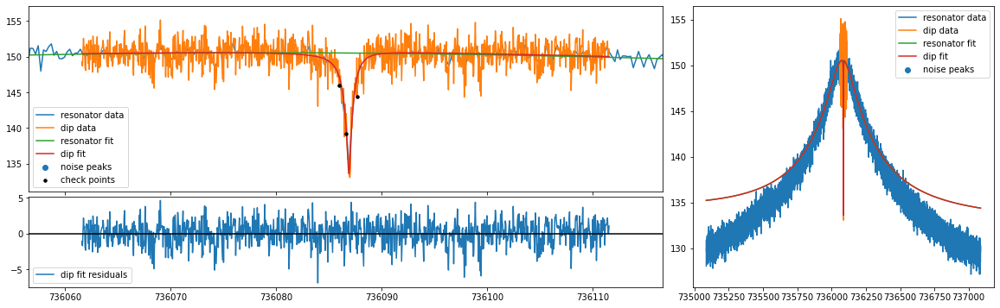

mean fit residuals = 5.2e-05 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.8925563246167882 0.08538119127866098
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                 736086.90565327392
dnu_z                     0.01600862664
dip_width                1.892556324617
ddip_width               0.085381191279
fit_err                  2.911511200423
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             22964688466053.98046875
doff           69613245538.706726074219
A                  

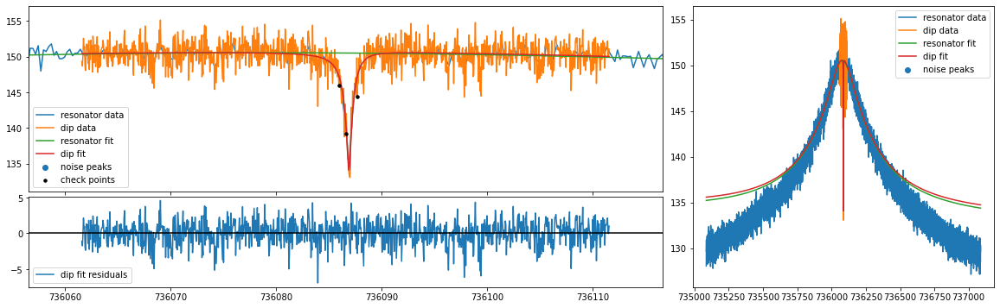

mean fit residuals = -1.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.914907874952571 0.08697336094424797
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.904182405677
dnu_z                    0.016735156317
dip_width                1.914907874953
ddip_width               0.086973360944
fit_err                  2.912386884601
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             25555581270923.58984375
doff           69613245538.706726074219
A                  

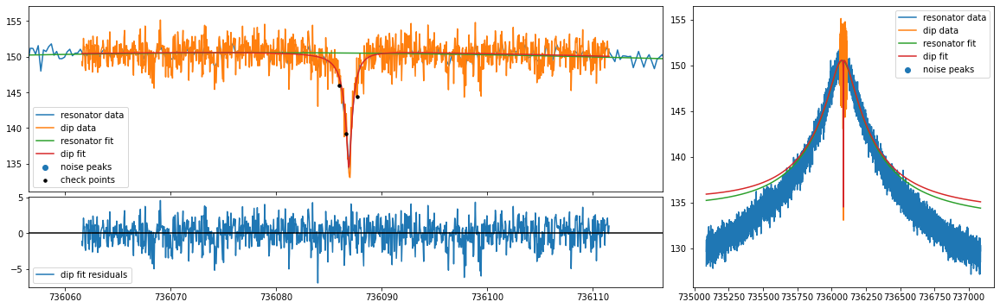

mean fit residuals = -2.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9363705092461123 0.08853870472597318
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.902835101355
dnu_z                    0.017438639765
dip_width                1.936370509246
ddip_width               0.088538704726
fit_err                  2.914779327017
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             28146474075793.19921875
doff           69613245538.706726074219
A                 

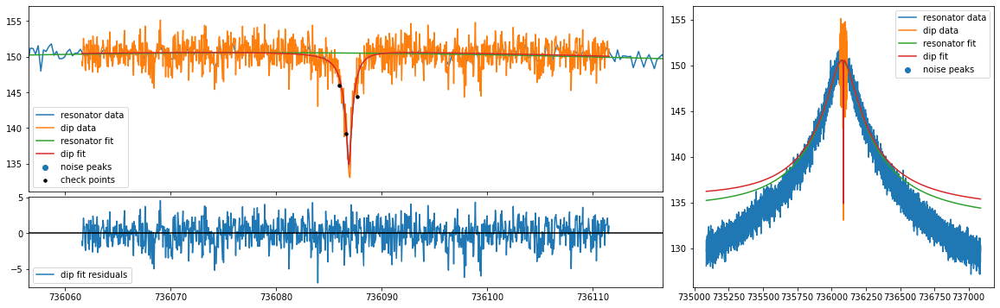

mean fit residuals = -3.0e-02 +/- 5.4e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 1.9570652173513094 0.09008139120849716
mcycle                                1
cycle                                11
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_205343.979347
nu_z                736086.901592596434
dnu_z                    0.018123063895
dip_width                1.957065217351
ddip_width               0.090081391208
fit_err                  2.918420606679
fit_success                        True
average_idx                           0
nu_res              736079.406710021198
dnu_res                  0.408961778031
Q                     4542.357825229676
dQ                      31.971596392505
th                      -0.000408411915
dth                      0.000017664697
off             30737366880662.80859375
doff           69613245538.706726074219
A                 

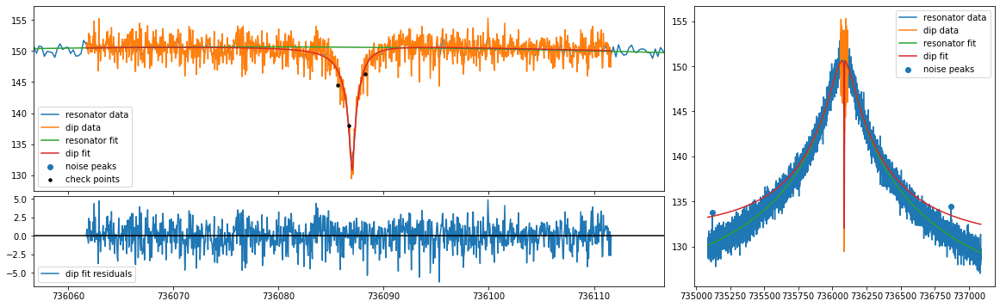

mean fit residuals = -2.4e-08 +/- 5.3e-02
original all {'A': 1134470699206272.0, 'dA': 15093548584146.88, 'Q': 4564.365496816123, 'dQ': 31.69513600183914, 'offset': 11944821630221.646, 'doffset': 2227274085338.4688, 'slope': -0.0003662020617101519, 'dslope': 1.7348803009188797e-05, 'nu_res': 736077.8864777776, 'dnu_res': 0.40086506278991024, 'nu_z': 736086.9922665136, 'dnu_z': 0.01572363115622793, 'dip_width': 2.971075603352396, 'ddip_width': 0.11032779225680249, 'pcov': array([[ 2.472325767371e-04, -9.124286975200e-05, -2.153929688234e+09,
        -1.237050439760e+09],
       [-9.124286975200e-05,  1.217222174426e-02,  4.703305132190e+11,
         7.384348290462e+10],
       [-2.153929688234e+09,  4.703305132190e+11,  2.278152088620e+26,
        -3.772814543581e+24],
       [-1.237050439760e+09,  7.384348290462e+10, -3.772814543581e+24,
         4.960749851220e+24]]), 'perr': array([1.572363115623e-02, 1.103277922568e-01, 1.509354858415e+13,
       2.227274085338e+12]), 'popt': dict_v

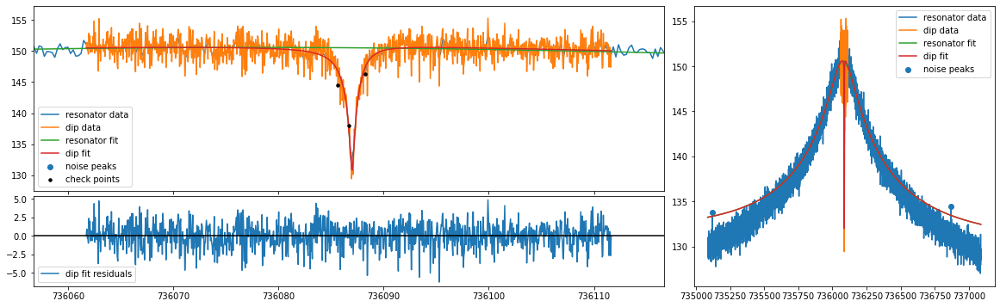

mean fit residuals = 2.6e-06 +/- 5.3e-02
[0.5, 3.0] 3.0 2.9710894302513355 0.09910157035423905
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                 736086.99226600572
dnu_z                    0.015696779879
dip_width                2.971089430251
ddip_width               0.099101570354
fit_err                  2.827690102602
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off            11944821630221.646484375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 132420

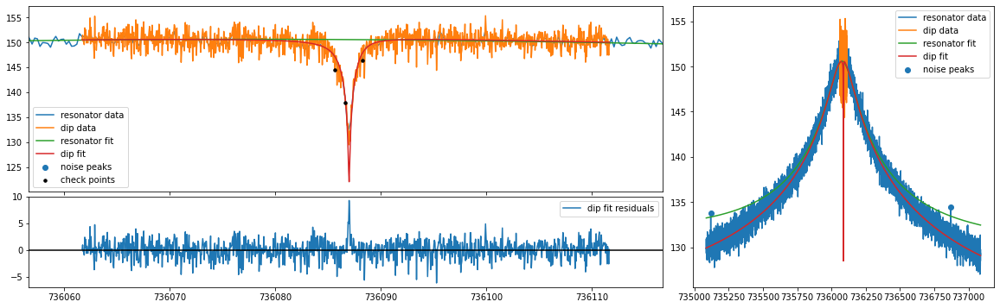

mean fit residuals = 3.5e-02 +/- 5.5e-02
[0.5, 3.0] 3.0 2.6926056325073793 0.08809747820037886
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.998569762683
dnu_z                    0.008555569665
dip_width                2.692605632507
ddip_width                 0.0880974782
fit_err                  3.024256136894
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off             1581250410743.208984375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 132420

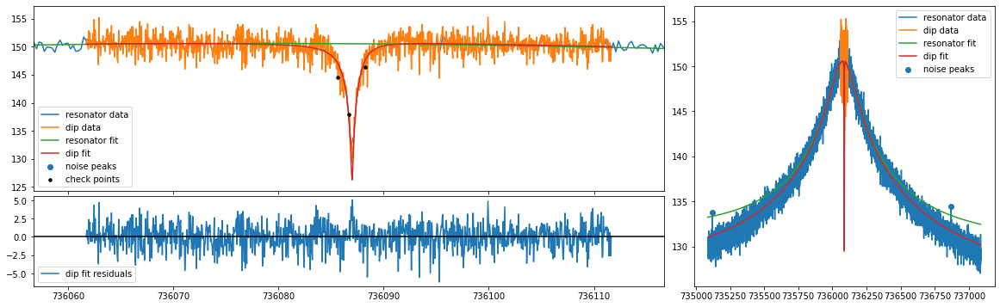

mean fit residuals = 2.9e-02 +/- 5.4e-02
[0.5, 3.0] 3.0 2.797541236839062 0.09112272829725347
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.996675638715
dnu_z                    0.011139357592
dip_width                2.797541236839
ddip_width               0.091122728297
fit_err                  2.895600484756
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off            4172143215612.8173828125
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 1324205

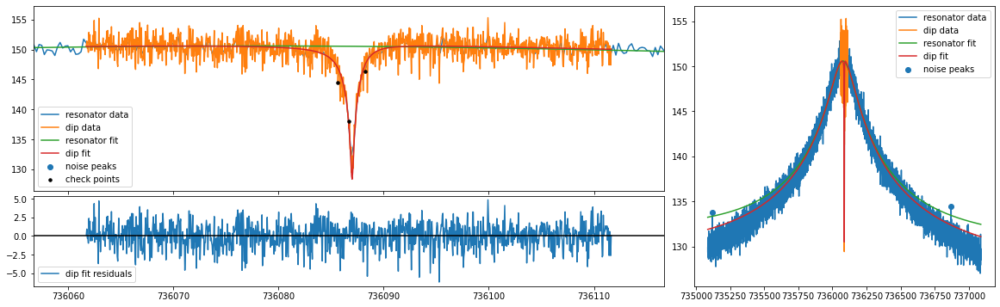

mean fit residuals = 2.0e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 2.868061840289737 0.0939356244746872
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.994911517599
dnu_z                     0.01293589345
dip_width                 2.86806184029
ddip_width               0.093935624475
fit_err                  2.850166065435
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off             6763036020482.427734375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 13242054

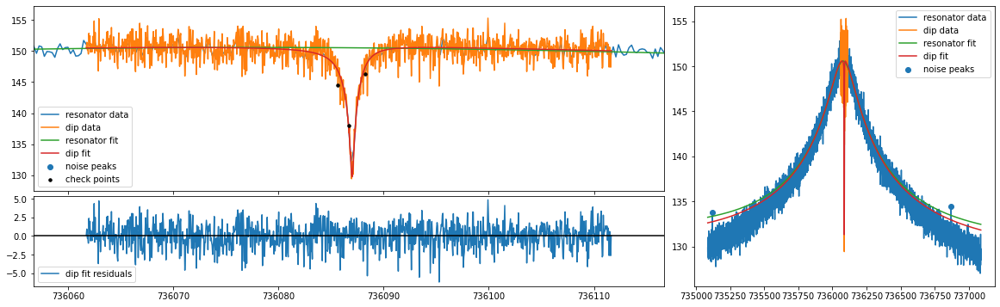

mean fit residuals = 1.0e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 2.923662441986788 0.09657725599628837
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.993463094928
dnu_z                    0.014405627158
dip_width                2.923662441987
ddip_width               0.096577255996
fit_err                  2.832204538346
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off             9353928825352.037109375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 1324205

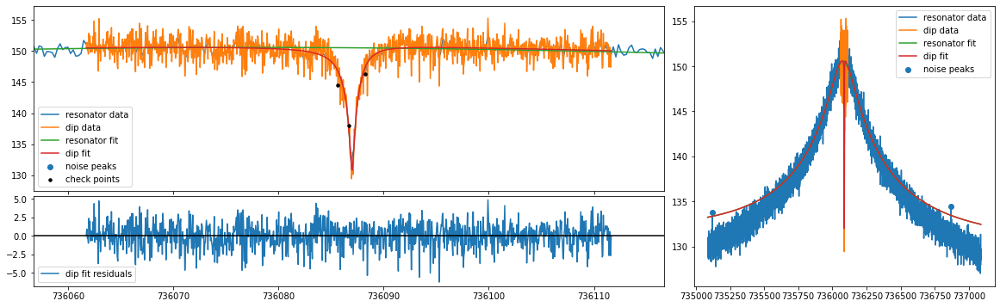

mean fit residuals = 2.6e-06 +/- 5.3e-02
[0.5, 3.0] 3.0 2.9710894302513355 0.09910157035423905
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                 736086.99226600572
dnu_z                    0.015696779879
dip_width                2.971089430251
ddip_width               0.099101570354
fit_err                  2.827690102602
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off            11944821630221.646484375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 132420

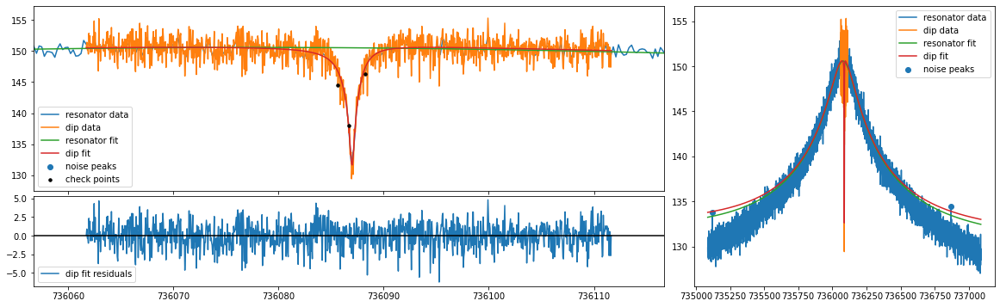

mean fit residuals = -1.0e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 3.0133627996393435 0.10154067854379989
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.991257324931
dnu_z                    0.016874747557
dip_width                3.013362799639
ddip_width               0.101540678544
fit_err                   2.83096368248
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off            14535714435091.255859375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 13242

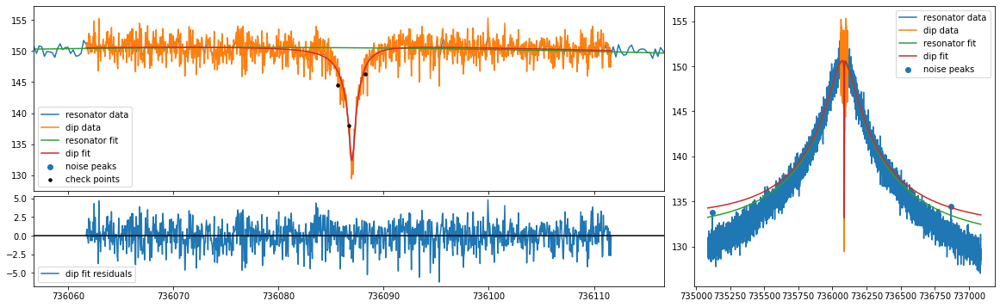

mean fit residuals = -2.1e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 3.052227647683223 0.10391740181362256
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.990402845666
dnu_z                    0.017974853014
dip_width                3.052227647683
ddip_width               0.103917401814
fit_err                  2.839208098435
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off            17126607239960.865234375
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 132420

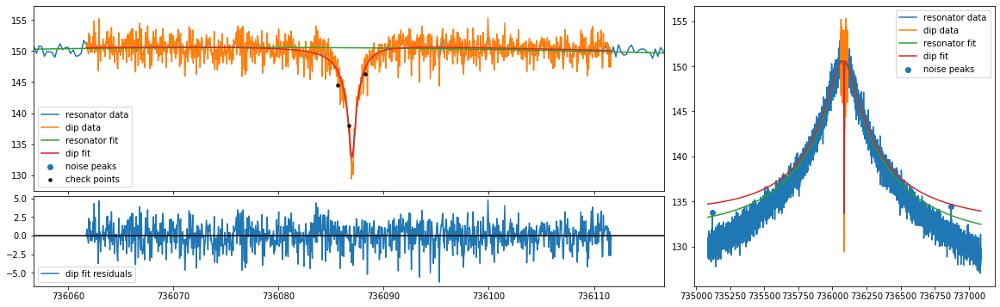

mean fit residuals = -3.1e-02 +/- 5.3e-02
[0.5, 3.0] 3.0 3.0882369412155786 0.10623873664706181
mcycle                                1
cycle                                12
position                     position_1
trap                                  2
acc_time                          20.05
time             20211124_212440.590671
nu_z                736086.989674763638
dnu_z                    0.019016915865
dip_width                3.088236941216
ddip_width               0.106238736647
fit_err                  2.850835276251
fit_success                        True
average_idx                           0
nu_res              736077.886477777618
dnu_res                   0.40086506279
Q                     4564.365496816123
dQ                      31.695136001839
th                      -0.000366202062
dth                      0.000017348803
off              19717500044830.4765625
doff           69033628252.290054321289
A                    1134470699206272.0
dA                 13242

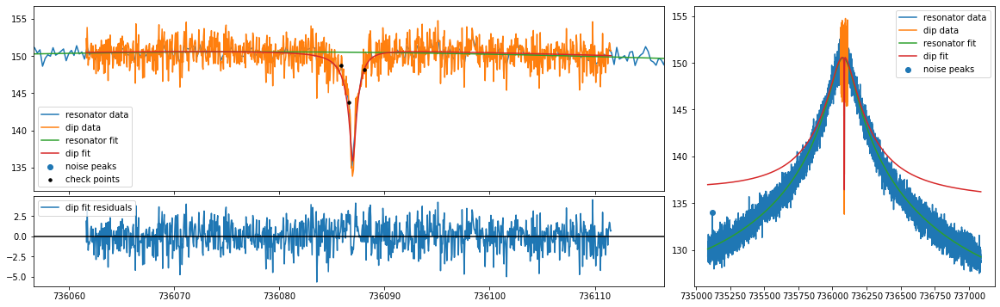

mean fit residuals = -7.6e-09 +/- 5.1e-02
original all {'A': 1101796201622639.6, 'dA': 15233012105390.082, 'Q': 4498.432222797102, 'dQ': 31.136319384559023, 'offset': 38553134318730.44, 'doffset': 6188047311940.475, 'slope': -0.00036730646611561266, 'dslope': 1.7438892749752553e-05, 'nu_res': 736078.0222655772, 'dnu_res': 0.4063129543790678, 'nu_z': 736086.9827052885, 'dnu_z': 0.019825171469003918, 'dip_width': 2.1945109454036884, 'ddip_width': 0.10532159417037622, 'pcov': array([[ 3.930374237754e-04, -1.383579675557e-04,  7.907666472057e+08,
        -5.003407550325e+09],
       [-1.383579675557e-04,  1.109263819859e-02,  1.483469755939e+11,
         2.526230609005e+11],
       [ 7.907666472057e+08,  1.483469755939e+11,  2.320446578030e+26,
        -3.583513276919e+25],
       [-5.003407550325e+09,  2.526230609005e+11, -3.583513276919e+25,
         3.829192953481e+25]]), 'perr': array([1.982517146900e-02, 1.053215941704e-01, 1.523301210539e+13,
       6.188047311940e+12]), 'popt': dict

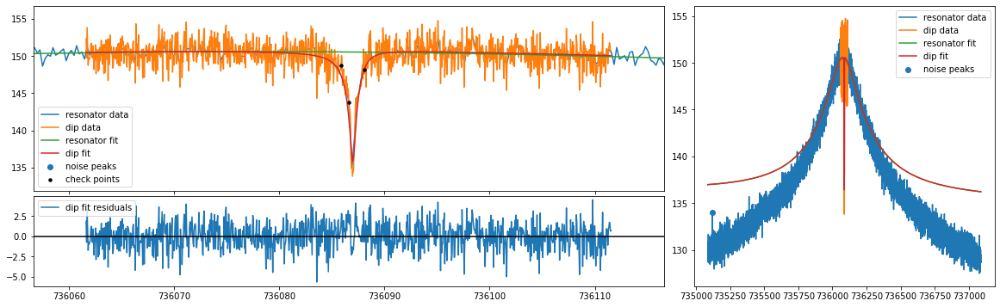

mean fit residuals = 7.3e-08 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945114460173567 0.09307460913666295
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.982697988162
dnu_z                    0.019786937133
dip_width                2.194511446017
ddip_width               0.093074609137
fit_err                  2.598540991536
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off                 38553134318730.4375
doff           69160454000.430511474609
A                  

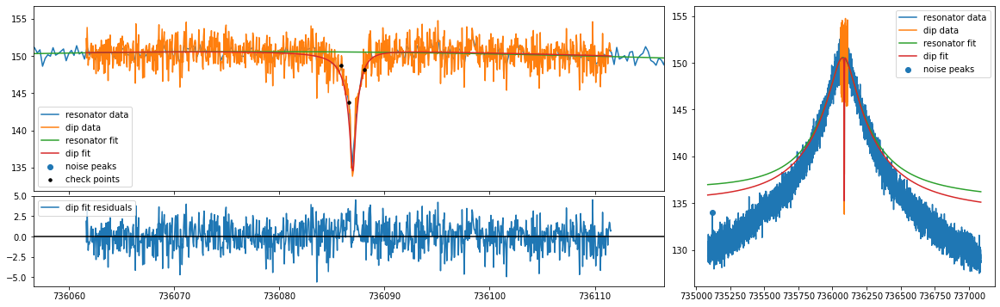

mean fit residuals = 5.6e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945109849106434 0.08936721225443664
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.981649571913
dnu_z                    0.017620179429
dip_width                2.194510984911
ddip_width               0.089367212254
fit_err                  2.609749918908
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off                    28189563099252.0
doff           69160454000.430511474609
A                  

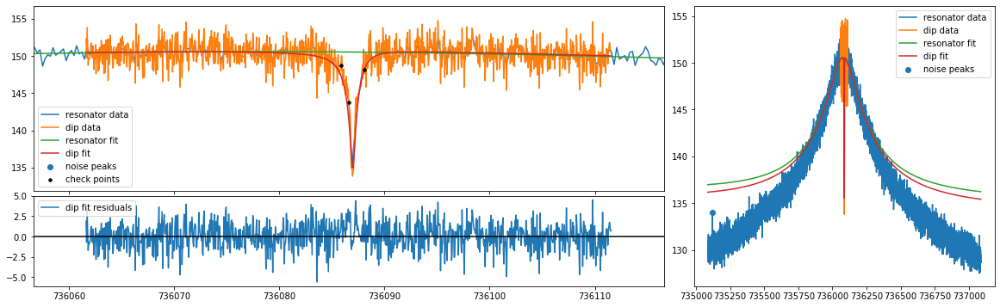

mean fit residuals = 4.1e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945110213482284 0.0902957607818924
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.981919566635
dnu_z                    0.018185303115
dip_width                2.194511021348
ddip_width               0.090295760782
fit_err                  2.604533883063
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off               30780455904121.609375
doff           69160454000.430511474609
A                  1

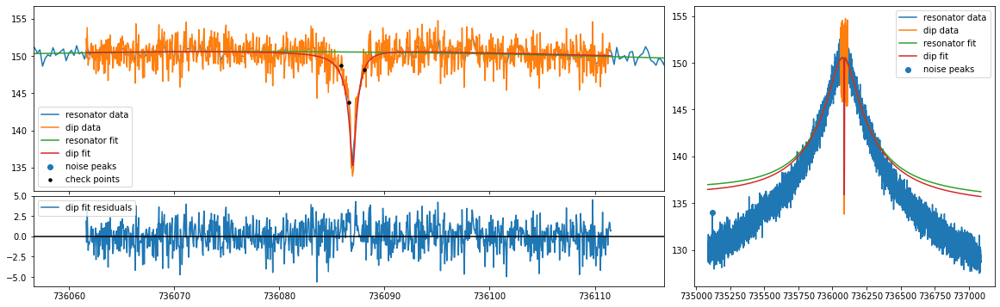

mean fit residuals = 2.7e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945110894941022 0.09122297626602861
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.982185082976
dnu_z                    0.018733155673
dip_width                2.194511089494
ddip_width               0.091222976266
fit_err                  2.601082727407
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off                33371348708991.21875
doff           69160454000.430511474609
A                  

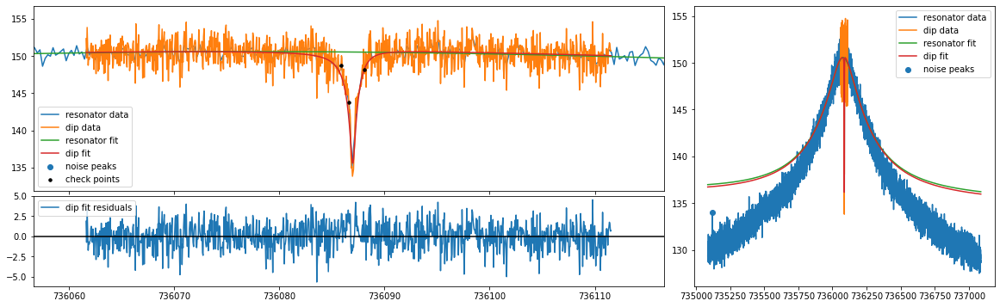

mean fit residuals = 1.4e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.194511215495417 0.09214915455948972
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.982444878086
dnu_z                    0.019266334756
dip_width                2.194511215495
ddip_width               0.092149154559
fit_err                  2.599150048099
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off               35962241513860.828125
doff           69160454000.430511474609
A                  1

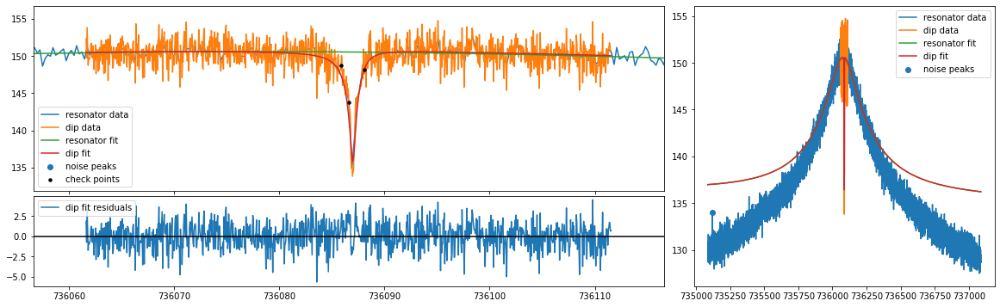

mean fit residuals = 7.3e-08 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945114460173567 0.09307460913666295
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.982697988162
dnu_z                    0.019786937133
dip_width                2.194511446017
ddip_width               0.093074609137
fit_err                  2.598540991536
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off                 38553134318730.4375
doff           69160454000.430511474609
A                  

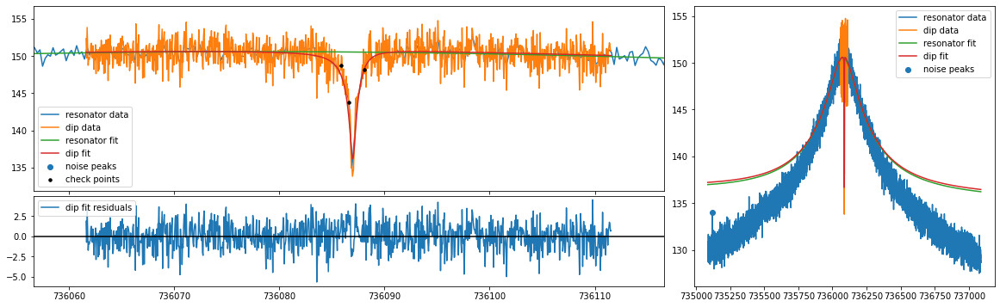

mean fit residuals = -1.3e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.194511863585589 0.09399966380435197
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.982943594805
dnu_z                    0.020296682064
dip_width                2.194511863586
ddip_width               0.093999663804
fit_err                  2.599098867315
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off               41144027123600.046875
doff           69160454000.430511474609
A                  

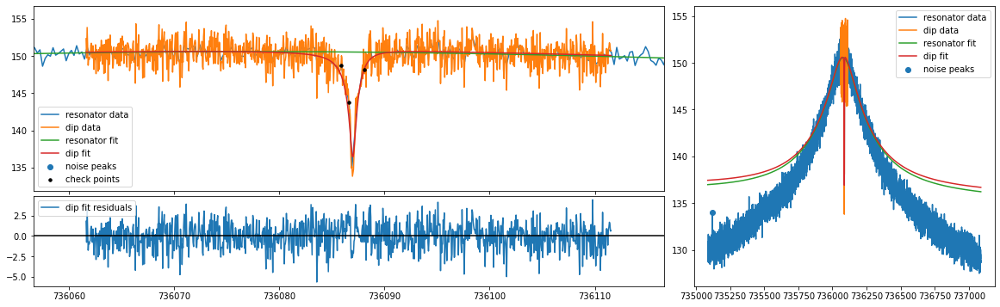

mean fit residuals = -2.7e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.1945126128611063 0.09492464032928798
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.983180939103
dnu_z                    0.020796998955
dip_width                2.194512612861
ddip_width               0.094924640329
fit_err                  2.600695830779
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off                43734919928469.65625
doff           69160454000.430511474609
A                 

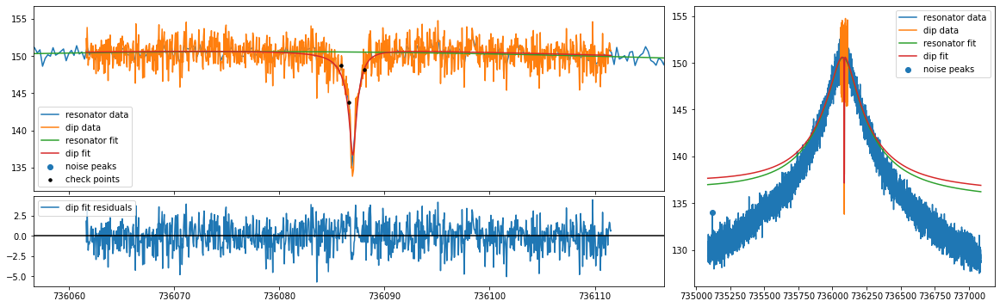

mean fit residuals = -4.0e-02 +/- 5.1e-02
[0.30000000000000004, 1.7999999999999998] 1.7999999999999998 2.194513945260971 0.0958498385182314
mcycle                                1
cycle                                12
position                     position_2
trap                                  2
acc_time                          20.05
time             20211124_211421.536609
nu_z                736086.983409267152
dnu_z                    0.021289090899
dip_width                2.194513945261
ddip_width               0.095849838518
fit_err                  2.603226239372
fit_success                        True
average_idx                           0
nu_res              736078.022265577223
dnu_res                  0.406312954379
Q                     4498.432222797102
dQ                      31.136319384559
th                      -0.000367306466
dth                      0.000017438893
off               46325812733339.265625
doff           69160454000.430511474609
A                  1

In [236]:
## NOW FITTING THE DATA
grouping = settings["grouping"]
fit_func = settings["fit_func"]
plot = settings.get("plot", False)
#fit_func = "daniel"

scan_par = "offset"
keep_vary_setting = ["vary_slope", "vary_A", "vary_Q", "vary_nu_res"]
keep_vary_setting = ["vary_slope"]
scan_range = np.arange(-1, 1.1, 0.25)*10363674856227*0.99999
#scan_range = np.arange(0.1, 1.8, 0.1)*2000
min_cycle = 2                        #1583065659694
max_cycle = 12
max_mc = 1
this_trap = "trap2"
print(scan_range)

axial_avg_all_filename = Path(output_folder, "axial_avg_all.hdf5")

avg_axial_fitdata = pd.DataFrame( columns=["mcycle", "cycle", "position", "trap", "acc_time", "time", 
                                           "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_err", "fit_success", "average_idx", 
                                           "nu_res", "dnu_res", "Q", "dQ", "th", "dth", "off", "doff", "A", "dA", "scan_par", "scan_val" ] )

from fticr_toolkit.fit_dip import fit_dip as fit_dip_alex
from fticr_toolkit.fit_dip import dip_func as dip_func_alex
import copy
import fticr_toolkit.fitaxialClass_Pavel as fitaxialClass_Pavel

if not settings["reuse_fitdata"]:
    for mc in mcycles:
        for subcycle in pnp_subcycles[mc]:
            if int(subcycle[5:]) < min_cycle or int(subcycle[5:]) > max_cycle  or int(mc[5:]) > max_mc:
                continue
                
            for pos in positions:
                for trap in traps:
                    #print(trap)
                    if trap != this_trap:
                        continue
                    avg_indexes = list(set(grouping))
                    #for idx, avg_len in enumerate(grouping):
                    for idx in avg_indexes:
                        path = "/m"+str(mc)+"/s"+str(subcycle)+"/"+str(pos)+"/"+str(trap)+"/avggrp"+str(idx)
                        print(path)
                        if idx==-1:
                            continue

                        try:
                            try:
                                with h5py.File(axial_avg_all_filename, 'r') as fobj:
                                    #fobj.visit(print)
                                    dset = fobj[path]
                                    data = dset[:]
                                    spec = data_conversion.Spectrum(dset)
                                    attrs = data_conversion.attrs_to_dict(dset)
                                    #for key, val in dset.attrs.items():
                                    #    #print(key, val)
                            except:
                                #raise
                                print(path, "not available, continue with other data")
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), 0, '19700101_000000.000',
                                                       0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 ] , index=avg_axial_fitdata.columns)
                                avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)
                                continue
                            
                            nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                            LO = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["LO"]
                            ion = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["ion"]
                            A, el, q = ideal_trap_physics.re_ionstr(ion)

                            if len(spec.freqs) < 10000:
                                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")
    
                            x = spec.freqs
                            y = spec.amps
    
                            # trap 2
                            config = {
                                "center" : nu_z,
                                "nu_z" : nu_z,
                                "dip_center": nu_z,
                                "res_span" : 2000,
                                "resonator_span" : 2000, # same same
                                "span" : 10,
                                "dip_span": 50,
                                "q_guess" : 4000, 
                                "dip_range" : 10, 
                                "width_range" : [0.05*q, 0.3*q],
                                "dip_width_guess": 0.3*q,
                                "min_dip_width": 0.01,
                                "plot": True,
                                "print_fit_report": False,
                                "plot_results": True,
                                "fancy_plot": True,
                                "equal_widths": False,
                                "vary_offset": True,
                                "vary_slope": False,
                                "vary_A": True,
                                "vary_nu_res": False,
                                "vary_Q": False,
                                "vary_nu_z_jitter": False,
                                "nu_z_jitter": 0.0,
                                "slope": None,
                                "min_dip_depth": 2.0,
                                "double_dips": False,
                                "save_plot": False,
                            }
            
                            if trap == 'trap3':
                                config['dip_span'] = 80
                                config['q_quess'] = 11000
                                config['res_span'] = 3000
                                config['resonator_span'] = 3000
                                config["width_range"] = [0.05*q, 0.3*q]
                                config["dip_width_guess"] = 0.9*q
                                config['vary_A'] = True
                                config['vary_nu_res'] = True
                                config['vary_Q'] = True
                                
                            if scan_par is not None:
                                config["init_values"] = {}
                                fitPavel = fitaxialClass_Pavel.AXIAl_FIT(config)
                                data = fitPavel.fit_axial_dip(x, y, settings["downsample"])
                                data['off'] = data['offset']
                                #config["vary_"+scan_par] = False
                                config["init_values"] = {
                                    "A": data["A"],
                                    "Q": data["Q"],
                                    "offset": data["offset"],
                                    "nu_res": data["nu_res"],
                                    "slope": data["slope"],
                                }
                                
                                print("original all", data)
                                print('original param', scan_par, config['init_values'])
                                
                            for scan_val in scan_range:
                                if scan_par is not None:
                                    sconfig = deepcopy(config)
                                    if scan_par in ["A", "Q", "offset", "nu_res", "slope"]:
                                        config["change_"+scan_par] = scan_val
                                        for key in config.keys():
                                            if key.startswith("vary") and key not in keep_vary_setting:
                                                sconfig[key] = False
                                    else:
                                        config[scan_par] = scan_val
                                        for key in config.keys():
                                            if key.startswith("vary") and key not in keep_vary_setting:
                                                sconfig[key] = True

                                try:

                                    pprint(sconfig)
                                    fitPavel = fitaxialClass_Pavel.AXIAl_FIT(sconfig)
                                    data = fitPavel.fit_axial_dip(x, y, settings["downsample"])
                                    data['fit_err_chi**2_red'] = data['redchi']
                                    data['th'] = data['slope']
                                    data['dth'] = data['dslope']
                                    data['off'] = data['offset']
                                    data['doff'] = data['doffset']


                                    print( config["width_range"], config["dip_width_guess"], data["dip_width"], data["ddip_width"] )

                                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                           data["nu_z"], data["dnu_z"], data["dip_width"], data["ddip_width"], data["fit_err_chi**2_red"],
                                                           data["fit_success"], idx, data["nu_res"], data["dnu_res"],
                                                           data["Q"], data["dQ"], data["th"], data["dth"], data["off"], data["doff"], 
                                                           data["A"], data["dA"], scan_par, scan_val ], index=avg_axial_fitdata.columns)
                                except Exception as e:
                                    spec.cut(nu_z, 60)
                                    x, y = spec.freqs, spec.amps
                                    plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                                    plt.plot(x, y)
                                    plt.show()
                                    #raise
                                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                           0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 , 0, 0] , index=avg_axial_fitdata.columns)
                                    print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")
                                    raise ValueError('bad fit')

                                print(dset)
                                avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)

                        except Exception as e:
                            raise
                            spec.cut(nu_z, 60)
                            x, y = spec.freqs, spec.amps
                            plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                            plt.plot(x, y)
                            plt.show()
                            #raise
                            dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), attrs["acc_time"], attrs["time"], 
                                                   0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 , 0, 0] , index=avg_axial_fitdata.columns)
                            avg_axial_fitdata = avg_axial_fitdata.append(dset, ignore_index=True)
                            print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")
                            display(avg_axial_fitdata)

In [237]:
if not settings["reuse_fitdata"]:
    avg_axial_fitdata["time"] = pd.to_datetime(avg_axial_fitdata['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(avg_axial_fitdata[avg_axial_fitdata["fit_success"]==True ])

    avg_axial_fitdata.to_csv(output_folder + "/axial_data_scan.csv", index=False)
else:
    avg_axial_fitdata = pd.read_csv(output_folder + "/axial_data_scan.csv")

,mcycle,cycle,position,trap,acc_time,time,nu_z,dnu_z,dip_width,ddip_width,...,Q,dQ,th,dth,off,doff,A,dA,scan_par,scan_val
0,1,2,position_1,2,20.05,2021-11-24 17:58:37.150109,736087.023867626907,0.016394796192,3.015654116842,0.106930330280,...,4594.848629210814,32.709639455729,-0.000387608645,0.000017746314,1.036378633546e+13,6.968817401081e+10,1.123400190274e+15,1.373170560508e+13,offset,-1.036357121948e+13
1,1,2,position_1,2,20.05,2021-11-24 17:58:37.150109,736086.828792654676,0.003645191868,2.608772234471,0.099797727397,...,4594.848629210814,32.709639455729,-0.000387608645,0.000017746314,2.151159839238e+08,6.968817401081e+10,1.123400190274e+15,1.373170560508e+13,offset,-7.772678414609e+12
2,1,2,position_1,2,20.05,2021-11-24 17:58:37.150109,736087.029209946049,0.010602892579,2.821708670459,0.097519166538,...,4594.848629210814,32.709639455729,-0.000387608645,0.000017746314,2.591107920854e+12,6.968817401081e+10,1.123400190274e+15,1.373170560508e+13,offset,-5.181785609739e+12
3,1,2,position_1,2,20.05,2021-11-24 17:58:37.150109,736087.026649378473,0.013051563151,2.908672393312,0.100993102552,...,4594.848629210814,32.709639455729,-0.000387608645,0.000017746314,5.182000725723e+12,6.968817401081e+10,1.123400190274e+15,1.373170560508e+13,offset,-2.590892804870e+12
4,1,2,position_1,2,20.05,2021-11-24 17:58:37.150109,736087.025037755258,0.014865797754,2.968340804589,0.104070729163,...,4594.848629210814,32.709639455729,-0.000387608645,0.000017746314,7.772893530593e+12,6.968817401081e+10,1.123400190274e+15,1.373170560508e+13,offset,0.000000000000e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
193,1,12,position_2,2,20.05,2021-11-24 21:14:21.536609,736086.982444878086,0.019266334756,2.194511215495,0.092149154559,...,4498.432222797102,31.136319384559,-0.000367306466,0.000017438893,3.596224151386e+13,6.916045400043e+10,1.101796201623e+15,1.272538127895e+13,offset,0.000000000000e+00
194,1,12,position_2,2,20.05,2021-11-24 21:14:21.536609,736086.982697988162,0.019786937133,2.194511446017,0.093074609137,...,4498.432222797102,31.136319384559,-0.000367306466,0.000017438893,3.855313431873e+13,6.916045400043e+10,1.101796201623e+15,1.272538127895e+13,offset,2.590892804870e+12
195,1,12,position_2,2,20.05,2021-11-24 21:14:21.536609,736086.982943594805,0.020296682064,2.194511863586,0.093999663804,...,4498.432222797102,31.136319384559,-0.000367306466,0.000017438893,4.114402712360e+13,6.916045400043e+10,1.101796201623e+15,1.272538127895e+13,offset,5.181785609739e+12
196,1,12,position_2,2,20.05,2021-11-24 21:14:21.536609,736086.983180939103,0.020796998955,2.194512612861,0.094924640329,...,4498.432222797102,31.136319384559,-0.000367306466,0.000017438893,4.373491992847e+13,6.916045400043e+10,1.101796201623e+15,1.272538127895e+13,offset,7.772678414609e+12


[-1.036357121948e+13 -7.772678414609e+12 -5.181785609739e+12
 -2.590892804870e+12  0.000000000000e+00  2.590892804870e+12
  5.181785609739e+12  7.772678414609e+12  1.036357121948e+13]
[-1.036357121948e+13 -7.772678414609e+12 -5.181785609739e+12
 -2.590892804870e+12  2.590892804870e+12  5.181785609739e+12
  7.772678414609e+12  1.036357121948e+13]
736086.67
2 position_1 20Ne10+
[array([0.022131002802, 0.0153061872  , 0.018259607715, 0.019782195114,
       0.022131002802, 0.023158471113, 0.024132385439, 0.025074318913]),
 array([0.017611479759, 0.011889407241, 0.011889407241, 0.014906578299,
       0.017611479759, 0.018692630639, 0.019693971756, 0.020642700409]),
 array([0.020641994873, 0.014294804853, 0.017059380928, 0.018455341401,
       0.020641994873, 0.021604649976, 0.022519410094, 0.023400228471]),
 array([0.022171155342, 0.018025465019, 0.019277966468, 0.020331725698,
       0.022171155342, 0.023020926871, 0.023834314475, 0.024628623801]),
 array([0.020703050621, 0.014356454825, 0

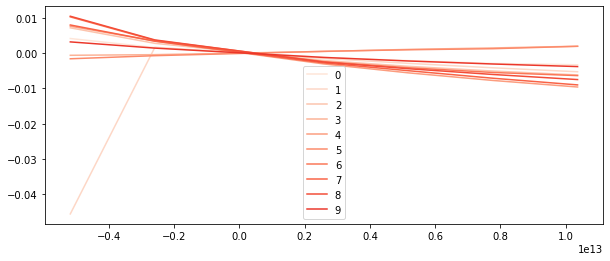

[-0.001561212016 -0.080031865451  0.000332079676  0.00207042871
 -0.001561212016 -0.002789338166 -0.003869699501 -0.004694762302]
[0.001203348758 0.092882348494 0.015811171479 0.001554264044
 0.001203348758 0.002185992599 0.003017440604 0.003834448427]


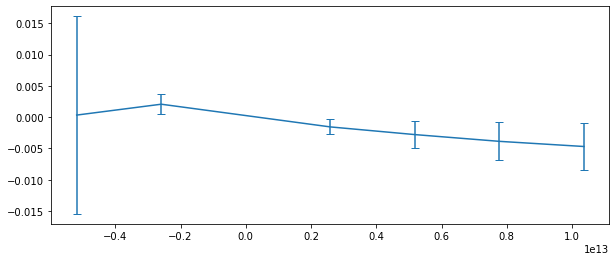

slope -4.027202855970911e-16 7.449139575262886e-17
0 -0.0
dnuz -0.004027202855970911
736086.67 736086.9557511674 0.2857511673355475
dnuc -5.509704351425171e-05
dnuc/nuc -1.0241460888820084e-12
736086.59
2 position_2 12C6+
[array([0.020216387659, 0.017087001065, 0.01803938011 , 0.018837790481,
       0.020216387659, 0.020841556986, 0.021436648715, 0.022010415763]),
 array([0.01907677456 , 0.016362722592, 0.017119132275, 0.01781155223 ,
       0.01907677456 , 0.019670538673, 0.0202468563  , 0.020809520794]),
 array([0.028020211035, 0.026036793123, 0.026553611945, 0.027054668461,
       0.028020211035, 0.028489215462, 0.028950918876, 0.029406456758]),
 array([0.017033913387, 0.013437474921, 0.014708184795, 0.015585399971,
       0.017033913387, 0.017717904736, 0.018385369466, 0.019026163643]),
 array([0.042423822274, 0.040647924432, 0.041096013325, 0.041541019087,
       0.042423822274, 0.042862478195, 0.04329978924 , 0.043736067543]),
 array([0.028674938024, 0.026899001651, 0.02735625877

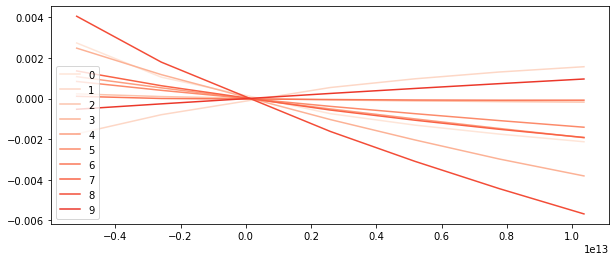

[-0.000416266196  0.001267670735  0.00106447289   0.000465478632
 -0.000416266196 -0.000794863969 -0.001141125162 -0.001457922847]
[0.000599567096 0.002895152669 0.001608458414 0.000716024738
 0.000599567096 0.001139007339 0.001627709403 0.002068998448]


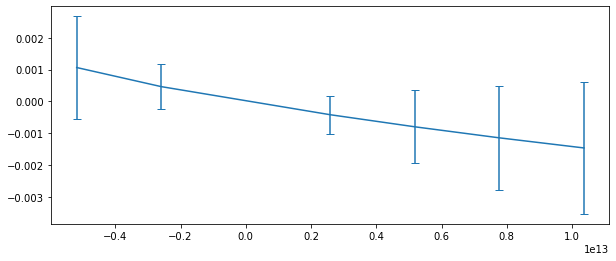

slope -1.6103067016013524e-16 7.92036936350091e-18
-0.1 620999713287885.2
dnuz -0.0016103067016013525
736086.59 736086.9347758569 0.3447758569382131
dnuc -2.2038817405700684e-05
dnuc/nuc -4.098133444610139e-13
[53798031.46482496, 53777695.879293814]
[53798031.46476986, 53777695.879271775]
-6.144876533292051e-13
ratio change 6.143974218275616e-13


In [242]:
# check the scan:
par_look = "nu_z"
par_look_diff_ion = -0.1
numshift = 0

scan_val_uncertainty = 1e13
skip1 = 2
skip2 = None

scan_rangeB = deepcopy(scan_range)

center = scan_range[int(len(scan_rangeB)/2)]
print(scan_rangeB)
scan_rangeB = np.delete(scan_rangeB, np.where(scan_rangeB == center)[0])
print(scan_rangeB)
colors = plt.cm.Reds(np.linspace(0.1,1.0,16))

nucs = []
newnucs = []
dnucs = []

for grpn, grpd in avg_axial_fitdata.groupby(["trap", "position"]):
    
    trap = grpn[0]
    posi = grpn[1]
    ion = meas_config[posi]['configuration']['traps'][trap]['ion']
    nup = meas_config[posi]['configuration']['traps'][trap]['nu_p']
    nuz = meas_config[posi]['configuration']['traps'][trap]['nu_z']
    num = meas_config[posi]['configuration']['traps'][trap]['nu_m']
    print(nuz)
    #nuc = np.sqrt(nup**2 + nuz**2 + num**2)
    #nucs.append(nuc)

    print(trap, posi, ion)
    
    vals_list = []
    dvals_list = []
    clean_look_at = []
    dclean_look_at = []

    for cyc, grpc in grpd.groupby("cycle"):
        if cyc == 3:
            continue
        
        ref = grpc[grpc.scan_val == center]
        #print(ref)
        ref_val = float(ref[par_look])
        dref_val = float(ref["d"+par_look])
        clean_look_at.append(ref_val)
        dclean_look_at.append(dref_val)
        
        grpc = grpc.drop(ref.index)
        #print(grpc)
        look_vals = grpc[par_look].to_numpy() - ref_val
        dlook_vals = np.sqrt( grpc["d"+par_look].to_numpy()**2 + dref_val**2)
        #scan_vals = grpc["off"].to_numpy()
        #print(scan_vals)

        #print(len(look_vals))
        #if np.mean(dlook_vals) > 0.1:
        #    continue
        
        vals_list.append(look_vals)
        dvals_list.append(dlook_vals)
        
    vals_list = np.asarray(vals_list)
    pprint(dvals_list)
    dvals_list = np.asarray(dvals_list)
    
    for idx, vlist, dvlist in zip(range(len(vals_list)), vals_list, dvals_list):
        #plt.errorbar(scan_rangeB, vlist, yerr=dvlist, capsize=4, label=idx, color=colors[idx])
        plt.plot(scan_rangeB[skip1:skip2], vlist[skip1:skip2], label=idx, color=colors[idx])
    
    plt.legend()
    plt.show()
    
    mean_vals = np.mean(vals_list, axis=0)
    dmean_vals = np.std(vals_list, axis=0)
    print(mean_vals)
    print(dmean_vals)
    
    plt.errorbar(scan_rangeB[skip1:skip2], mean_vals[skip1:skip2], yerr=dmean_vals[skip1:skip2], capsize=4)
    plt.show()
    
    #print("mean par", grpd["off"].mean())
    
    #popt, pcov = np.polyfit(scan_rangeB[skip1:skip2], mean_vals[skip1:skip2], 1, w=1/dmean_vals[skip1:skip2], cov=True)
    popt, pcov = np.polyfit(scan_rangeB[skip1:skip2], mean_vals[skip1:skip2], 1, cov=True)
    perr = np.sqrt(np.diag(pcov))
    m = popt[0]
    dm = perr[0]
    print("slope", m, dm)
    offoff = par_look_diff_ion if posi != "position_1" else 0
    numnum = numshift if posi != "position_1" else 0
    print(offoff, offoff/m)
    #m *= (scan_val_uncertainty)
    print("dnuz", m*(scan_val_uncertainty))

    this_nuz = np.mean(clean_look_at)
    print(nuz, this_nuz, this_nuz - nuz)
    newnuc = np.sqrt(nup**2 + (this_nuz+m*(scan_val_uncertainty))**2 + (num+numnum)**2)
    nuc = np.sqrt(nup**2 + this_nuz**2 + num**2)
    nucs.append(nuc)
    newnucs.append(newnuc)
    dnuc = newnuc - nuc
    dnucs.append(dnuc)
    
    print("dnuc", dnuc)
    print("dnuc/nuc", dnuc/nuc)
    
ratio = nucs[0]/nucs[1]
print(nucs)
print(newnucs)
print((dnucs[0]-dnucs[1])/nucs[0])
newratio = newnucs[0]/newnucs[1]
print("ratio change", ratio-newratio)

In [184]:
# single spec fit.
avg_axial_fitdata_single = pd.DataFrame( columns=["mcycle", "cycle", "position", "trap", "acc_time", "time", 
                                           "nu_z", "dnu_z", "dip_width", "ddip_width", "fit_err", "fit_success", "average_idx", 
                                           "nu_res", "dnu_res", "Q", "dQ", "th", "dth", "off", "doff", "A", "dA" ] )

# you have to know your data structure here and loop over the correct parts of the paths to the actual datasets.
# for every for-loop a subgroup of the fhds/hdf5 datagroup is picked out.
if settings.get("single_axial_fits", False): #and not settings.get("reuse_fitdata", True):
    print("SINGLE FITS...")
    for mc in mcycles:
        pnp_measurement_grp = data_root[mc]["pnp_measurement"]
        for subcycle in pnp_subcycles[mc]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    try:
                        trap_grp = position_grp[trap]
                        
                        fs = filter_settings[(filter_settings['mcycle']==int(mc[-1])) & (filter_settings['position']==pos) & (filter_settings['trap']==int(trap[-1]))]
                        #print(fs)
                        sc = int(subcycle[5:])
                        minc = int(fs.min_cycle)
                        maxc = int(fs.max_cycle)
                        if sc < minc or sc > (maxc + overhead):# or minc == maxc:
                            print('filtered out', mc, pos, trap, subcycle)
                            continue
                        
                        print("maincycle", mc, "subcycle", subcycle, "pos", pos, "trap", trap)

                        keys = []
                        for name, dset in trap_grp.items():
                            use = False
                            only_attr = {"type": "amplitude"}
                            for attr, val in only_attr.items():
                                if dset.attrs[attr] == val:
                                    use = True
                            if use:
                                keys.append(name)

                        print('specs', len(keys))
                        # loop over datasets and try to fit
                        for idx, name in enumerate(keys):
                            print(name)
                            spec = data_conversion.Spectrum(trap_grp[name])
                            attrs = data_conversion.attrs_to_dict(trap_grp[name])
                            pos = attrs["position"]
                            trap = attrs["trap"][-1]
                            acc_time = attrs["acc_time"]
                            time = attrs["time"]
                            nu_z = meas_config[pos]["configuration"]["traps"][int(trap)]["nu_z"]
                            
                            if len(spec.freqs) < 10000:
                                # typically at least a resolution of 0.1 Hz (seconds), so at least 1000 kHz span, otherwise, its bad data.
                                raise IndexError("The given spectrum is too small (<10000 points) to be an axial spectrum... ")
    
                            x = spec.freqs
                            y = spec.amps
    
                            # trap 2
                            config = {
                                "center" : nu_z,
                                "nu_z" : nu_z,
                                "dip_center": nu_z,
                                "res_span" : 5000,
                                "resonator_span" : 5000, # same same
                                "span" : 10,
                                "dip_span": 20,
                                "q_guess" : 4000, 
                                "dip_range" : 5, 
                                "width_range" : [0.1, 3],
                                "min_dip_width": 0.01,
                                "plot": False,
                                "print_fit_report": False,
                                "plot_results": True,
                                "fancy_plot": False,
                                "equal_widths": False,
                                "vary_off": False,
                                "vary_slope": False,
                                "vary_A": False,
                                "vary_nu_res": False,
                                "vary_Q": False,
                                "vary_nu_z_jitter": False,
                                "nu_z_jitter": 0.0,
                                "slope": 0.0,
                                "min_dip_depth": 4.0,
                                "double_dips": False,
                            }
            
                            if trap == '3':
                                config['dip_span'] = 40
                                config['q_quess'] = 10000
                                config['vary_A'] = True
                                config['vary_nu_res'] = True
                                config['vary_Q'] = True
                        
                            
                            try:
                                
                                if fit_func == 'menno':
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, beta0 = [None, 5e3, None, 1e-6, None, None, 0.1], 
                                    #                                        res_span=config['res_span'], dip_span=config['dip_span'], fixed_res='varA',
                                    #                                        rough_resonator=0, auto_better_guess=True)
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, tight_fit_bounds=[0,1,0,1,1,0,0])
                                    popt, perr, data = fitaxial.mennofit(x, y, nu_z, dip_span=config['dip_span'], dip_odr=False, tight_fit_bounds=[0,1,0,1,1,0,0])
                                    #popt, perr, data = fitaxial.mennofit(x, y, nu_z, res_span=2200, dip_span=dip_span, fixed_res=False)   
                                    #data, popt, pcov = fit_dip_alex(x, y, **fit_config)
                                    #data["fit_success"] = True
                                    data["fit_err_chi**2_red"] = data['fit_err']
                                    #plt.plot(x,y,label = 'data')
                                    #plt.plot(x, dip_func_alex(x,*popt)+ data['amp_offset'], label = "dip_fit")
                                    #plt.xlim(data["nu_z"] - 20, data["nu_z"] + 20)
                                    #plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z config')
                                    #plt.legend()
                                    #plt.show()

                                elif fit_func == 'pavel':
                                    
                                    fitPavel = fitaxialClass_Pavel.AXIAl_FIT(config)
                                    data = fitPavel.fit_axial_dip(x, y, settings["downsample"])
                                    data['fit_err_chi**2_red'] = data['redchi']
                                    data['th'] = data['slope']
                                    data['dth'] = data['dslope']
                                    data['off'] = data['offset']
                                    data['doff'] = data['doffset']

                                elif fit_func == 'daniel':
                                    
                                    fit_obj = fitaxial.AXIAl_FIT()
                                    fit_obj = fitaxialClass_old.AXIAl_FIT(fit_opt)
                                    popt, perr, data = fit_obj.fit_axial_dip_test_new(x, y)
                                    #popt, perr, data = fit_obj.fit_axial_dip(x, y)
            
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap), attrs["acc_time"], time, 
                                                       data["nu_z"], data["dnu_z"], data["dip_width"], data["ddip_width"], data["fit_err_chi**2_red"],
                                                       data["fit_success"], idx, data["nu_res"], data["dnu_res"],
                                                       data["Q"], data["dQ"], data["th"], data["dth"], data["off"], data["doff"], 
                                                       data["A"], data["dA"] ], index=avg_axial_fitdata_single.columns)
                        
                            except Exception as e:
                                #raise
                                data = {"fit_success": False}
                                dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap), attrs["acc_time"], attrs["time"], 
                                                    0, 0, 0, 0, 0, False, idx, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0 ] , index=avg_axial_fitdata_single.columns)
                            
                                #raise
                                spec.cut(nu_z, 200)
                                x, y = spec.freqs, spec.amps
                                plt.vlines([nu_z], np.min(y), np.max(y), label='nu_z guess')
                                plt.plot(x, y)
                                plt.show()
                                #raise

                                print("\n FIT FAILED \n DATA MISSING? \nTRY raise to see what really happenig...", e, "\n")

                            avg_axial_fitdata_single = avg_axial_fitdata_single.append(dset, ignore_index=True)
                            
                    except Exception as e:
                        #raise
                        print(e)
                        print('done?', mc, subcycle, trap)

In [17]:
if True:# not settings["reuse_fitdata"]:
    avg_axial_fitdata_single["time"] = pd.to_datetime(avg_axial_fitdata_single['time'], format='%Y%m%d_%H%M%S.%f')
    #display(avg_axial_fitdata)
    display(avg_axial_fitdata_single)

    avg_axial_fitdata_single.to_csv(output_folder + "/axial_data_single.csv", index=False)
else:
    avg_axial_fitdata_single = pd.read_csv(output_folder + "/axial_data_single.csv")

,mcycle,cycle,position,trap,acc_time,time,nu_z,dnu_z,dip_width,ddip_width,...,nu_res,dnu_res,Q,dQ,th,dth,off,doff,A,dA


### Step 3: Phase readout

Each phase is read out at the position given by the axial fit done before. This also means the same grouping is applied to the phase data. This applies to the normal pnp cycle, unwrap phase readout is done in the next next cell.

In [18]:

phase_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            position_grp = subcycle_grp[pos]
            for trap in traps:
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                if trap_grp is None:
                    continue

                axial_data = avg_axial_fitdata[ (avg_axial_fitdata["mcycle"] == int(mc[5:])) & (avg_axial_fitdata["cycle"] == int(subcycle[5:])) & (avg_axial_fitdata["position"] == pos) & (avg_axial_fitdata["trap"] == int(trap[4:])) ]
                #display(axial_data)
    
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase"}
            
                counter = 0
                last_nu_z = 0
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        continue

                    #print(counter, grouping[counter])

                    try:
                        nu_z = float(axial_data[ axial_data["average_idx"] == grouping[counter] ]["nu_z"])
                        nu_z_time = axial_data[ axial_data["average_idx"] == grouping[counter] ]["time"]
                        last_nu_z = nu_z
                    except Exception as e:
                        nu_z = last_nu_z
                        #print(e)
                        print("NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...")
                        #raise
                        #counter += 1
                        #continue
                        #nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                    #print(nu_z)
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    #print(dset_attrs)
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    #print(freqs)
                    if nu_z == 0 or settings["fixed_phase_readout"]:
                    #if True:
                        print("ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...")
                        # take it from the config
                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    #print(dset_data)
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    grp_index = grouping[counter]
                    if grp_index == -1:
                        grp_index = grp_index_before
                    grp_index_before = grp_index
                        
                    #print(idx, phase, dset_attrs["time"], nu_z_time)
                    
                    counter += 1
                    counter = counter%len(grouping)
                    
                    print(".", end="")
                    #print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, grouping[counter], amp ] , index=phase_data.columns)
                    phase_data = phase_data.append(dset, ignore_index=True)
                                    

NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.

ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...


ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...
ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...
.NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...


In [19]:

phase2_data = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "average_idx", "amp" ] )

for mc in mcycles:
    pnp_measurement_grp = data_root[mc]["pnp_measurement"]
    for subcycle in pnp_subcycles[mc]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            position_grp = subcycle_grp[pos]
            for trap in traps:
                try:
                    trap_grp = position_grp[trap]
                except:
                    continue
                if trap_grp is None:
                    continue

                axial_data = avg_axial_fitdata[ (avg_axial_fitdata["mcycle"] == int(mc[5:])) & (avg_axial_fitdata["cycle"] == int(subcycle[5:])) & (avg_axial_fitdata["position"] == pos) & (avg_axial_fitdata["trap"] == int(trap[4:])) ]
                #display(axial_data)
    
                #trap_grp.sort_values(by="time", inplace=True)
                only_attr = {"type": "phase2"}
            
                counter = 0
                last_nu_z = 0
                for name, dset in trap_grp.items():
                    
                    # check if this is the correct type of data to average
                    skip = False
                    for attr, val in only_attr.items():
                        if dset.attrs[attr] != val:
                            skip = True
                    if skip:
                        continue

                    print(counter, grouping[counter])

                    try:
                        nu_z = float(axial_data[ axial_data["average_idx"] == grouping[counter] ]["nu_z"])
                        nu_z_time = axial_data[ axial_data["average_idx"] == grouping[counter] ]["time"]
                        last_nu_z = nu_z
                    except Exception as e:
                        nu_z = last_nu_z
                        #print(e)
                        print("NU_Z DATA MISSING, if there is no axial data, i will not create phase data to it, so just skip this...")
                        #raise
                        #counter += 1
                        #continue
                        #nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                    #print(nu_z)
                    
                    # NOTE: this here is sadly very important: the dset[:] has to come before
                    #       getting the attributes, due to some automated update in fhds
                    dset_data = dset[:]
                    dset_attrs = {}
                    for key, val in dset.attrs.items():
                        dset_attrs[key] = val
                        
                    #print(dset_attrs)
                    freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])
                    #print(freqs)
                    if nu_z == 0 or settings["fixed_phase_readout"]:
                    #if True:
                        print("ZERO IN NU_Z, this means, there was data, but the fit did not work, i will take the nu_z from the config an read out the phase with that value...")
                        # take it from the config
                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]
                    
                    idx = (np.abs(freqs - nu_z)).argmin()
                    #print(dset_data)
                    phase = dset_data[1][idx]
                    amp = dset_data[0][idx]
                    grp_index = grouping[counter]
                    if grp_index == -1:
                        grp_index = grp_index_before
                    grp_index_before = grp_index
                        
                    #print(idx, phase, dset_attrs["time"], nu_z_time)
                    
                    counter += 1
                    counter = counter%len(grouping)
                    
                    print("subcycle", subcycle, "pos", pos, "trap", trap, "name", name, "\tnu_z", nu_z, "\tphase", phase, "\tamp", amp, end="\n")
                    
                    # add they data
                    dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, grouping[counter], amp ] , index=phase_data.columns)
                    phase2_data = phase2_data.append(dset, ignore_index=True)
                                    

In [20]:
phase_data["time"] = pd.to_datetime(phase_data['time'], format='%Y%m%d_%H%M%S.%f')
display(phase_data)
phase_data.to_csv(output_folder + "/phase_data.csv", index=False)

,mcycle,cycle,position,trap,acc_time,time,phase,average_idx,amp
0,1,1,position_1,2,0.10,2021-11-24 17:34:06.952257,0.903346657753,0,128.670257568359
1,1,1,position_1,2,0.10,2021-11-24 17:34:51.463859,1.913068890572,0,129.845413208008
2,1,1,position_1,2,0.10,2021-11-24 17:35:35.973899,1.771913886070,0,124.426971435547
3,1,1,position_1,2,0.10,2021-11-24 17:36:20.410132,1.592522740364,0,134.003402709961
4,1,1,position_1,2,0.10,2021-11-24 17:37:04.919244,1.215243935585,0,126.486740112305
...,...,...,...,...,...,...,...,...,...
3555,2,10,position_2,3,20.05,2021-11-25 09:11:57.845967,1.787586212158,0,139.560867309570
3556,2,10,position_2,3,20.05,2021-11-25 09:12:43.220157,1.377456068993,0,133.991149902344
3557,2,10,position_2,3,20.05,2021-11-25 09:13:29.108853,0.400596112013,0,138.392013549805
3558,2,10,position_2,3,20.05,2021-11-25 09:14:14.485497,1.921475887299,0,137.403625488281



### now unwrap data...

In [21]:

pre_unwrap_phase = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "amp" ] )
#positions=["position_1", "position_2"]
#traps=[1, 2]
for mc in mcycles:
    unwrap_type = "pre_unwrap"
    print(meas_config["freq"])
    if meas_config["freq"] == "nu_m":
        unwrap_type = "num_unwrap"
    pnp_measurement_grp = data_root[mc][unwrap_type]

    for subcycle in ["cycle1"]:
        subcycle_grp = pnp_measurement_grp[subcycle]
        for pos in positions:
            print(pos)
    
            try:
                #if pos == "position_2": continue
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    trap_grp = position_grp[trap]
                    print("\nsubcycle", subcycle, "pos", pos, "trap", trap)#, end="\r")
                    if trap_grp is None:
                        continue
                    #trap_grp.sort_values(by="time", inplace=True)
                    only_attr = {"type": "phase"}
                    for name, dset in trap_grp.items():
                        # check if this is the correct type of data to average
                        skip = False
                        for attr, val in only_attr.items():
                            if dset.attrs[attr] != val:
                                skip = True
                        if skip:
                            continue

                        # NOTE: this here is sadly very important: the dset[:] hhas to come before
                        #       getting the attributes, due to some automated update in fhds
                        dset_data = dset[:]
                        dset_attrs = {}
                        for key, val in dset.attrs.items():
                            dset_attrs[key] = val

                        freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])

                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                        idx = (np.abs(freqs - nu_z)).argmin()
                        phase = dset_data[1][idx]
                        amp = dset_data[0][idx]

                        # add they data
                        dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, amp ] , index=pre_unwrap_phase.columns)
                        pre_unwrap_phase = pre_unwrap_phase.append(dset, ignore_index=True)

                        print('.', end='')
            except Exception as e:
                print("something is missing", pos, e)

nu_p
position_1

subcycle cycle1 pos position_1 trap trap2
........................................
subcycle cycle1 pos position_1 trap trap3
........................................position_2

subcycle cycle1 pos position_2 trap trap2
........................................
subcycle cycle1 pos position_2 trap trap3
........................................nu_p
position_1

subcycle cycle1 pos position_1 trap trap2
........................................
subcycle cycle1 pos position_1 trap trap3
........................................position_2

subcycle cycle1 pos position_2 trap trap2
........................................
subcycle cycle1 pos position_2 trap trap3
........................................

In [22]:
pre_unwrap_phase["time"] = pd.to_datetime(pre_unwrap_phase['time'], format='%Y%m%d_%H%M%S.%f')
display(pre_unwrap_phase)
pre_unwrap_phase.to_csv(output_folder + "/pre_unwrap_phase.csv", index=False)

,mcycle,cycle,position,trap,acc_time,time,phase,amp
0,1,1,position_1,2,0.10,2021-11-24 17:08:06.045115,1.760297536850,135.773345947266
1,1,1,position_1,2,0.10,2021-11-24 17:10:27.649653,2.002216815948,131.378890991211
2,1,1,position_1,2,0.10,2021-11-24 17:12:48.528066,1.190299510956,129.700317382812
3,1,1,position_1,2,0.10,2021-11-24 17:15:09.543256,2.262445926666,120.979576110840
4,1,1,position_1,2,0.10,2021-11-24 17:17:30.442833,1.528817176819,126.360313415527
...,...,...,...,...,...,...,...,...
315,2,1,position_2,3,5.05,2021-11-25 05:29:03.756145,0.351803421974,138.871612548828
316,2,1,position_2,3,5.05,2021-11-25 05:31:27.978401,5.896153926849,139.898910522461
317,2,1,position_2,3,5.05,2021-11-25 05:33:51.971669,5.866120338440,138.188995361328
318,2,1,position_2,3,5.05,2021-11-25 05:36:16.175155,5.979540348053,139.904296875000


In [23]:

num_unwrap_phase = pd.DataFrame( columns=[ "mcycle", "cycle", "position", "trap", "acc_time", "time", "phase", "amp" ] )
#positions=["position_1", "position_2"]
#traps=[1, 2]
for mc in mcycles:
    try:
        pnp_measurement_grp = data_root[mc]["num_unwrap"]
        for subcycle in ["cycle1"]:
            subcycle_grp = pnp_measurement_grp[subcycle]
            for pos in positions:
                print(pos)
                #if pos == "position_2": continue
                position_grp = subcycle_grp[pos]
                for trap in traps:
                    trap_grp = position_grp[trap]
                    print("\nsubcycle", subcycle, "pos", pos, "trap", trap)#, end="\r")
                    if trap_grp is None:
                        continue
                    #trap_grp.sort_values(by="time", inplace=True)
                    only_attr = {"type": "phase"}
                    for name, dset in trap_grp.items():
                        # check if this is the correct type of data to average
                        skip = False
                        for attr, val in only_attr.items():
                            if dset.attrs[attr] != val:
                                skip = True
                        if skip:
                            continue

                        # NOTE: this here is sadly very important: the dset[:] hhas to come before
                        #       getting the attributes, due to some automated update in fhds
                        dset_data = dset[:]
                        dset_attrs = {}
                        for key, val in dset.attrs.items():
                            dset_attrs[key] = val

                        freqs = np.linspace(dset_attrs["start"], dset_attrs["stop"], dset_attrs["binnum"])

                        nu_z = meas_config[pos]["configuration"]["traps"][int(trap[4:])]["nu_z"]

                        idx = (np.abs(freqs - nu_z)).argmin()
                        phase = dset_data[1][idx]
                        amp = dset_data[0][idx]

                        # add they data
                        dset = pd.Series(data=[ int(mc[5:]), int(subcycle[5:]), pos, int(trap[4:]), dset_attrs["acc_time"], dset_attrs["time"], phase, amp ] , index=num_unwrap_phase.columns)
                        num_unwrap_phase = num_unwrap_phase.append(dset, ignore_index=True)

                        print('.', end='')
    except:
        pass

In [24]:
try:
    num_unwrap_phase["time"] = pd.to_datetime(num_unwrap_phase['time'], format='%Y%m%d_%H%M%S.%f')
    display(num_unwrap_phase)
    num_unwrap_phase.to_csv(output_folder + "/num_unwrap_phase.csv", index=False)
except:
    pass

,mcycle,cycle,position,trap,acc_time,time,phase,amp


## Check data

 >>> AXIAL DATA >>> 


 >>> AXIAL UNCERTAINTY >>> 


 >>> AXIAL DIP WIDTH >>> 


 >>> Resonator nu_res >>> 


 >>> off_resonance nu_z - nu_res >>> 


 >>> Resonator A >>> 


 >>> Resonator Q >>> 


 >>> Resonator offset >>> 


 >>> Resonator threshold amplifier >>> 


(3, 'position_1') dipwidth mHz 8854 cooling time constant ms 17
(3, 'position_2') dipwidth mHz 14557 cooling time constant ms 10
 >>> AXIAL DATA SINGLE >>> 


 SOMETHING WENT WRONG HERE 
 'position' 


 >>> PHASE DATA >>> 
['0.1' '20.05']


(2, 'position_1')
1 mean/std amp 130.05430965423585 4.631056445311035 error of mean (130.05430965423585, 0.7322343169992936)
2 mean/std amp 129.78824920654296 5.367094371849863 error of mean (129.78824920654296, 0.8486121316058131)
3 mean/std amp 126.6422607421875 9.291516727143824 error of mean (126.6422607421875, 1.4691177887663864)
4 mean/std amp 127.95312042236328 4.400540966748446 error of mean (127.95312042236328, 0.6957866195902187)
5 mean/std amp 129.8641887664795 4.106357170300279 error of mean (129.8641887664795, 0.6492720772156406)
6 mean/std amp 128.45478687286376 4.998069293514305 error of mean (128.45478687286376, 0.790264143542692)
7 mean/std amp 128.86615962982177 5.201875883746192 error of mean (128.86615962982177, 0.8224887949069615)
8 mean/std amp 126.75478076934814 5.779136015860286 error of mean (126.75478076934814, 0.9137616359014737)
9 mean/std amp 130.25685958862306 4.1000688021041425 error of mean (130.25685958862306, 0.6482777989023628)
10 mean/std amp 131.446

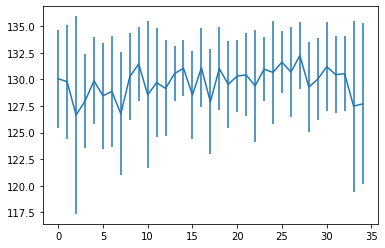

(2, 'position_2')
1 mean/std amp 129.18812675476073 3.9189442215469596 error of mean (129.18812675476073, 0.6196394881621955)
2 mean/std amp 129.16210823059083 3.8169802143931366 error of mean (129.16210823059083, 0.6035175630640063)
3 mean/std amp 128.60226974487304 3.420945447995691 error of mean (128.60226974487304, 0.5408989683425741)
4 mean/std amp 129.08083553314208 3.8941046864736397 error of mean (129.08083553314208, 0.6157120128196291)
5 mean/std amp 128.61601581573487 4.653469781016587 error of mean (128.61601581573487, 0.7357781765388697)
6 mean/std amp 128.93120937347413 4.194522509068152 error of mean (128.93120937347413, 0.6632122412749818)
7 mean/std amp 127.7837511062622 4.509445003220455 error of mean (127.7837511062622, 0.7130058596720985)
8 mean/std amp 128.61380996704102 5.102161648233169 error of mean (128.61380996704102, 0.8067225899387813)
9 mean/std amp 127.48305168151856 4.905367657808516 error of mean (127.48305168151856, 0.775606727960018)
10 mean/std amp 129

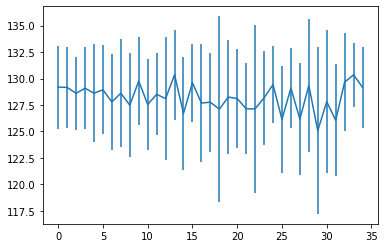

(3, 'position_1')
1 mean/std amp 133.43809146881102 4.179448467536203 error of mean (133.43809146881102, 0.6608288260357352)
2 mean/std amp 134.2669937133789 4.806819631786055 error of mean (134.2669937133789, 0.760024916902792)
3 mean/std amp 134.39267559051513 4.466503613724038 error of mean (134.39267559051513, 0.7062162298370431)
4 mean/std amp 134.23524723052978 3.2441366207495923 error of mean (134.23524723052978, 0.5129430381165287)
5 mean/std amp 133.88429641723633 3.7693309770763075 error of mean (133.88429641723633, 0.5959835571294528)
6 mean/std amp 133.8666259765625 3.149371829169979 error of mean (133.8666259765625, 0.4979594089473925)
7 mean/std amp 133.14691619873048 5.554290326176794 error of mean (133.14691619873048, 0.8782104108279107)
8 mean/std amp 133.06491508483887 4.940756695401628 error of mean (133.06491508483887, 0.7812022261097957)
9 mean/std amp 133.3044713973999 5.016730989069459 error of mean (133.3044713973999, 0.7932148166904384)
10 mean/std amp 132.6486

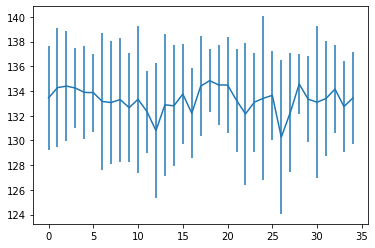

(3, 'position_2')
1 mean/std amp 134.94414081573487 3.333842053858444 error of mean (134.94414081573487, 0.5271267124723212)
2 mean/std amp 134.7351972579956 3.8312221770869477 error of mean (134.7351972579956, 0.6057694150871858)
3 mean/std amp 135.94708976745605 3.033312270468938 error of mean (135.94708976745605, 0.4796087814609274)
4 mean/std amp 135.8431869506836 3.5171435538456843 error of mean (135.8431869506836, 0.5561092243965714)
5 mean/std amp 135.85035381317138 4.44094282147431 error of mean (135.85035381317138, 0.702174713721667)
6 mean/std amp 135.09844226837157 3.5743792996147805 error of mean (135.09844226837157, 0.5651589904070059)
7 mean/std amp 135.20900936126708 3.432294905021825 error of mean (135.20900936126708, 0.5426934750630134)
8 mean/std amp 134.82323398590088 3.7484779967559017 error of mean (134.82323398590088, 0.5926864114386954)
9 mean/std amp 135.17842350006103 2.88593056528404 error of mean (135.17842350006103, 0.4563056877697411)
10 mean/std amp 136.27

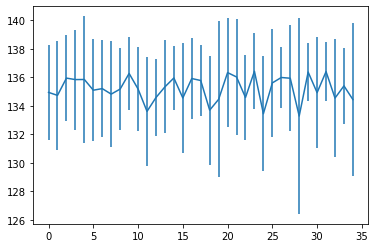

 >>> UNWRAP DATA >>> 


 >>> NUM UNWRAP DATA >>> 


In [25]:
import numpy as np
off_res = avg_axial_fitdata.nu_z - avg_axial_fitdata.nu_res
doff_res = np.sqrt((avg_axial_fitdata.dnu_z.to_numpy()**2 + avg_axial_fitdata.dnu_res.to_numpy()**2).astype(float))
avg_axial_fitdata['off_res'] = off_res
avg_axial_fitdata['doff_res'] = doff_res

print(" >>> AXIAL DATA >>> ")
plot_axial_fitdata = avg_axial_fitdata[avg_axial_fitdata["nu_z"] != 0]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dnu_z"] > 0.0005]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dip_width"] > 0.1]
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL UNCERTAINTY >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL DIP WIDTH >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dip_width", error_y="ddip_width", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

try:
    print(" >>> Resonator nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
    
    print(" >>> off_resonance nu_z - nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off_res", error_y="doff_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator A >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="A", error_y="dA", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator Q >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="Q", error_y="dQ", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator offset >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off", error_y="doff", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator threshold amplifier >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="th", error_y="dth", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
except:
    pass
    
for gname, grp in plot_axial_fitdata.groupby(['trap', 'position']):
    dipwidth = grp.dip_width.mean()
    tau = 1/(2*np.pi*dipwidth)
    print(gname, 'dipwidth mHz', int(dipwidth*1e3), 'cooling time constant ms', int(tau*1e3))

try:
    print(" >>> AXIAL DATA SINGLE >>> ")
    plot_axial_fitdata_single = avg_axial_fitdata_single[avg_axial_fitdata_single["nu_z"] != 0]
    #plot_axial_fitdata_single = plot_axial_fitdata_single[plot_axial_fitdata_single["dnu_z"] > 0.08]
    plot_axial_fitdata_single['masked'] = False
    #print(plot_axial_fitdata_single)
    #for trap, grp in plot_axial_fitdata_single.groupby('trap'):
    #    plot_axial_fitdata_single.loc[grp.index] = filtering.sigma_size(grp, 'dnu_z')
    #    plot_axial_fitdata_single.loc[grp.index] = filtering.three_sigma(grp, 'nu_z', 'dnu_z', manual_std=3)
    plot_axial_fitdata_single = plot_axial_fitdata_single[ plot_axial_fitdata_single['masked']==False ]
    
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata_single, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle'])
    fig.update_yaxes(matches=None)
    fig.show()
    
    print(" >>> INVERTED PHASE DATA >>> ")
    phase_data["acc_time"] = phase_data["acc_time"].astype(str)
    phase_data["phase"] = -phase_data["phase"]
    print(phase_data["acc_time"].unique())
    #fig = px.scatter(phase_data[phase_data["acc_time"]=='40.05'], x="time", y="phase", facet_col="trap", color="position", hover_data=['mcycle', 'cycle', 'position'])
    fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig = px.scatter(phase_data, x="time", y="phase", facet_col="position", facet_row="trap", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig.update_yaxes(matches=None)
    fig.show()
    fig = px.scatter(phase_data, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    fig.show()
    phase_data["acc_time"] = phase_data["acc_time"].astype(float)
    phase_data["phase"] = -phase_data["phase"]

    plot_axial_fitdata_single_avg = pd.DataFrame()
    for grpname, grp in plot_axial_fitdata_single.groupby(["mcycle", "trap", "position"]):
        avg = statistics.average_subsets(grp, groupby=["cycle"], errortype="weighted",
                                              columns=["nu_z", "dip_width", "nu_res", "time"], 
                                              dcolumns=["dnu_z", "ddip_width", "dnu_res", None],
                                              masked=True)
        plot_axial_fitdata_single_avg = plot_axial_fitdata_single_avg.append(avg, ignore_index=True)
        
    plot_axial_fitdata_single_avg["type"] = "avg(single)"
    plot_axial_fitdata["type"] = "average"
    plot_axial_fitdata_single["type"] = "single"
    #merged_data = plot_axial_fitdata.append(plot_axial_fitdata_single_avg, ignore_index=True)
    merged_data = plot_axial_fitdata.append(plot_axial_fitdata_single, ignore_index=True)
    #merged_data = merged_data.append(plot_axial_fitdata_single, ignore_index=True)
    #print(merged_data.columns, merged_data.dnu_z)
    for trap, grp in merged_data.groupby("trap"):
        print(trap)
        fig = px.scatter(grp, x="time", y="nu_z", error_y="dnu_z", color="type", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
        fig.update_yaxes(matches=None, showticklabels=True)
        fig.show()

    print(" >>> Resonator >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator - nu_z >>> ")
    plot_axial_fitdata["nuzres"] = plot_axial_fitdata["nu_z"] - plot_axial_fitdata["nu_res"]
    plot_axial_fitdata["dnuzres"] = np.sqrt((plot_axial_fitdata["dnu_z"].to_numpy()**2 + plot_axial_fitdata["dnu_res"].to_numpy()**2).astype(float))
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nuzres", error_y="dnuzres", facet_col="trap", facet_row="position", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
        
except Exception as e:
    #raise
    print( "\n\n SOMETHING WENT WRONG HERE \n", e, "\n\n")



print(" >>> PHASE DATA >>> ")
phase_data["acc_time"] = phase_data["acc_time"].astype(str)
print(phase_data["acc_time"].unique())
#fig = px.scatter(phase_data[phase_data["acc_time"]=='40.05'], x="time", y="phase", facet_col="trap", color="position", hover_data=['mcycle', 'cycle', 'position'])
fig = px.scatter(phase_data, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig = px.scatter(phase_data, x="time", y="phase", facet_col="position", facet_row="trap", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig.update_yaxes(matches=None)
fig.show()
fig = px.scatter(phase_data, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()
phase_data["acc_time"] = phase_data["acc_time"].astype(float)

for gname, grp in phase_data.groupby(['trap', 'position']):
    means = []
    stds = []
    print(gname)
    for ggname, ggrp in grp.groupby('cycle'):
        meanamp = ggrp.amp.mean()
        stdamp = ggrp.amp.std()
        means.append(meanamp)
        stds.append(stdamp)
        print(ggname, 'mean/std amp', meanamp, stdamp, 'error of mean', statistics.mean_and_error(ggrp.amp) )
    print('mean and error of whole measurment:', statistics.mean_and_error(grp.amp))
    plt.errorbar(np.arange(len(means)), means, stds)
    plt.show()


print(" >>> UNWRAP DATA >>> ")
pre_unwrap_phase["acc_time"] = pre_unwrap_phase["acc_time"].astype(str)
fig = px.scatter(pre_unwrap_phase, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
#fig.update_yaxes(matches=None)
fig.show()
fig = px.scatter(pre_unwrap_phase, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
fig.show()
pre_unwrap_phase["acc_time"] = pre_unwrap_phase["acc_time"].astype(float)


print(" >>> NUM UNWRAP DATA >>> ")
try:
    num_unwrap_phase["acc_time"] = num_unwrap_phase["acc_time"].astype(str)
    fig = px.scatter(num_unwrap_phase, x="time", y="phase", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    #fig.update_yaxes(matches=None)
    fig.show()
    fig = px.scatter(num_unwrap_phase, x="time", y="amp", facet_col="trap", facet_row="position", color="acc_time", hover_data=['mcycle', 'cycle', 'position'])
    fig.show()
    num_unwrap_phase["acc_time"] = num_unwrap_phase["acc_time"].astype(float)
except:
    pass

In [26]:
avg_axial_fitdata_backup = avg_axial_fitdata.copy(deep=True)

print(" >>> AXIAL DATA >>> ")
plot_axial_fitdata = avg_axial_fitdata_backup[avg_axial_fitdata["nu_z"] != 0]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dnu_z"] > 0.0005]
plot_axial_fitdata = plot_axial_fitdata[plot_axial_fitdata["dip_width"] > 0.1]
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="nu_z", error_y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL UNCERTAINTY >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dnu_z", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

print(" >>> AXIAL DIP WIDTH >>> ")
#plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
fig = px.scatter(plot_axial_fitdata, x="time", y="dip_width", error_y="ddip_width", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
fig.update_yaxes(matches=None, showticklabels=True)
fig.show()

try:
    print(" >>> Resonator nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="nu_res", error_y="dnu_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
    
    print(" >>> off_resonance nu_z - nu_res >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off_res", error_y="doff_res", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator A >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="A", error_y="dA", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator Q >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="Q", error_y="dQ", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator offset >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="off", error_y="doff", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()

    print(" >>> Resonator threshold amplifier >>> ")
    #plot_axial_fitdata = avg_axial_fitdata[(avg_axial_fitdata["nu_z"] != 0) & (avg_axial_fitdata["trap"] == 3)]
    fig = px.scatter(plot_axial_fitdata, x="time", y="th", error_y="dth", facet_col="trap", facet_row="position", color="average_idx", hover_data=['mcycle', 'cycle', 'position'])
    fig.update_yaxes(matches=None, showticklabels=True)
    fig.show()
except:
    pass
    
for gname, grp in plot_axial_fitdata.groupby(['trap', 'position']):
    dipwidth = grp.dip_width.mean()
    tau = 1/(2*np.pi*dipwidth)
    print(gname, 'dipwidth mHz', int(dipwidth*1e3), 'cooling time constant ms', int(tau*1e3))


 >>> AXIAL DATA >>> 


 >>> AXIAL UNCERTAINTY >>> 


 >>> AXIAL DIP WIDTH >>> 


 >>> Resonator nu_res >>> 


 >>> off_resonance nu_z - nu_res >>> 


 >>> Resonator A >>> 


 >>> Resonator Q >>> 


 >>> Resonator offset >>> 


 >>> Resonator threshold amplifier >>> 


(3, 'position_1') dipwidth mHz 8854 cooling time constant ms 17
(3, 'position_2') dipwidth mHz 14557 cooling time constant ms 10


mc, trap, pos (1, 3, 'position_1')


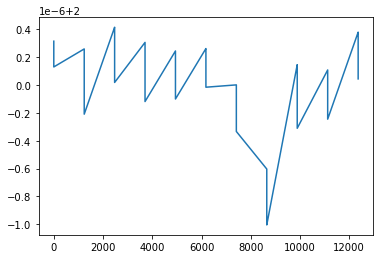

findfont: Font family ['cursive'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Bitstream Vera Sans'] not found. Falling back to DejaVu Sans.


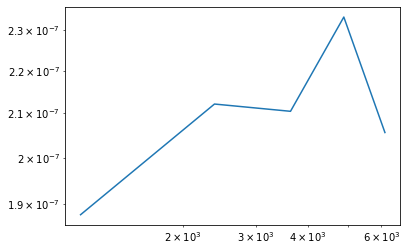

mc, trap, pos (1, 3, 'position_2')


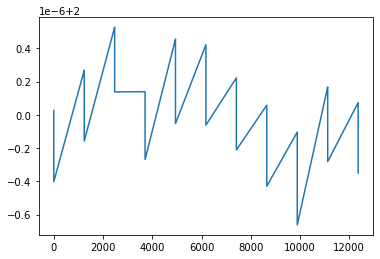

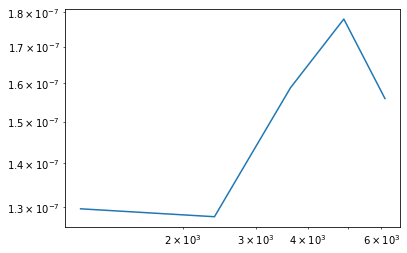

In [27]:
for gname, grp, in plot_axial_fitdata.groupby(["mcycle", "trap", "position"]):
    print("mc, trap, pos", gname)
    
    try:

        t = grp.time.astype('int64').to_numpy()//1e9
        t = t - t.min()
        z = grp.nu_z.to_numpy()
        z = z/z.mean()*2
        plt.plot(t, z)
        plt.show()
        visualization.allanvariance(z, t, plot=True)
    
    except:
        print('pass')